## Advanced Lane Finding Project

The goals / steps of this project are the following:

* [Step 1](#step1): Compute the camera calibration matrix and distortion coefficients given a set of chessboard images.
* [Step 2](#step2): Apply a distortion correction to raw images.
* [Step 3](#step3): Use color transforms, gradients, etc., to create a thresholded binary image.
* [Step 4](#step4): Apply a perspective transform to rectify binary image ("birds-eye view").
* [Step 5](#step5): Detect lane pixels and fit to find the lane boundary.
* [Step 6](#step6): Determine the curvature of the lane and vehicle position with respect to center.
* [Step 7](#step7): Warp the detected lane boundaries back onto the original image.
* [Step 8](#step8): Output visual display of the lane boundaries and numerical estimation of lane curvature and vehicle position.

[//]: # (Image References)

[image1]: ../examples/undistort_output.png "Undistorted"
[image2]: ../test_images/test1.jpg "Road Transformed"
[image3]: ../examples/binary_combo_example.jpg "Binary Example"
[image4]: ../examples/warped_straight_lines.jpg "Warp Example"
[image5]: ../examples/color_fit_lines.jpg "Fit Visual"
[image6]: ../examples/example_output.jpg "Output"
[video1]: ../project_video.mp4 "Video"


---
## Camera Calibration

<a id='step1'></a>
### Step 1 Compute the camera calibration using chessboard images

In [1]:
import numpy as np
import cv2
import glob
import os
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
%matplotlib inline
from PIL import Image

I start by preparing "object points", which will be the (x, y, z) coordinates of the chessboard corners in the world. Here I am assuming the chessboard is fixed on the (x, y) plane at z=0, such that the object points are the same for each calibration image. Thus, `objp` is just a replicated array of coordinates, and `objpoints` will be appended with a copy of it every time I successfully detect all chessboard corners in a test image. `imgpoints` will be appended with the (x, y) pixel position of each of the corners in the image plane with each successful chessboard detection.

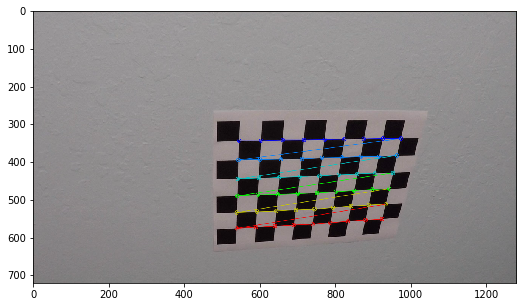

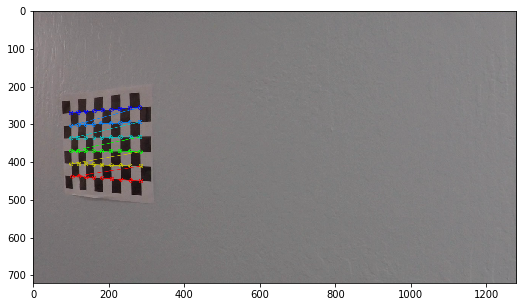

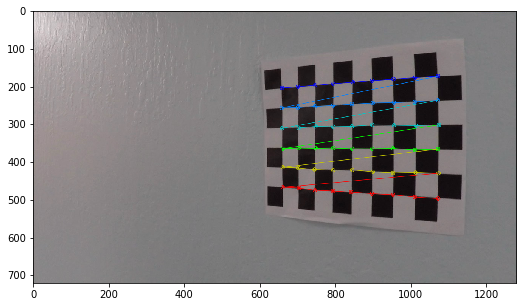

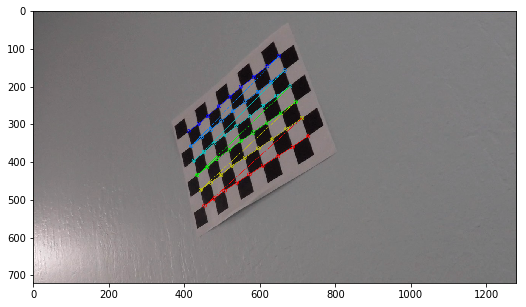

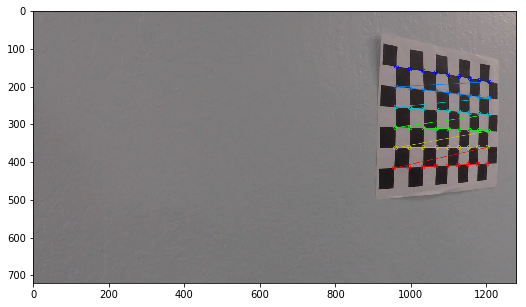

...

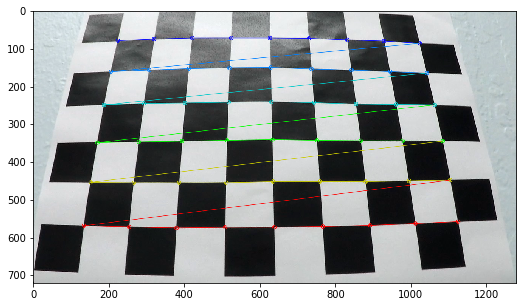

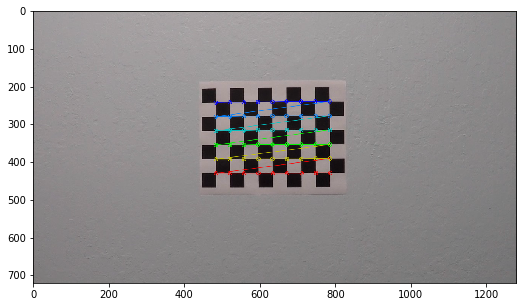

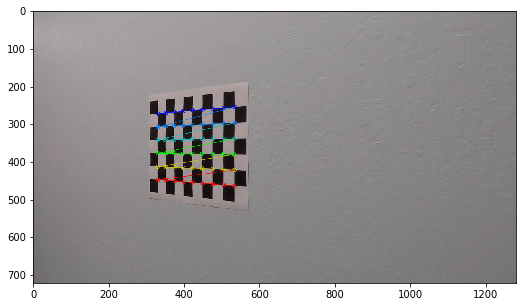

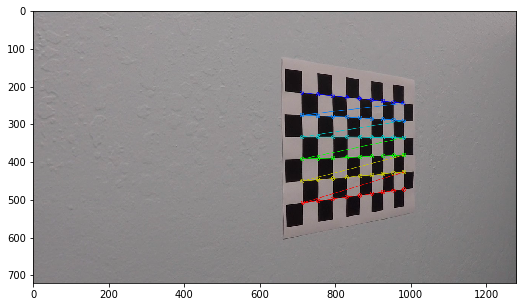

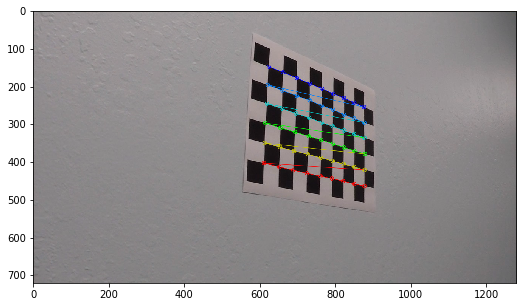

In [2]:
# prepare object points, like (0,0,0), (1,0,0), (2,0,0) ....,(6,5,0)
objp = np.zeros((6*9,3), np.float32)
objp[:,:2] = np.mgrid[0:9,0:6].T.reshape(-1,2)

# Arrays to store object points and image points from all the images.
objpoints = [] # 3d points in real world space
imgpoints = [] # 2d points in image plane.

# Make a list of calibration images
images = glob.glob('../camera_cal/calibration*.jpg')

# Step through the list and search for chessboard corners
for fname in images:
    image = cv2.imread(fname)
    gray = cv2.cvtColor(image,cv2.COLOR_BGR2GRAY)

    # Find the chessboard corners
    ret, corners = cv2.findChessboardCorners(gray, (9,6),None)

    # If found, add object points, image points
    if ret == True:
        objpoints.append(objp)
        imgpoints.append(corners)

        # Draw and display the corners
        image = cv2.drawChessboardCorners(image, (9,6), corners, ret)
        plt.figure(figsize=(12,5))
        plt.imshow(image)

I then used the output `objpoints` and `imgpoints` to compute the camera calibration and distortion coefficients using the `cv2.calibrateCamera()` function. I applied this distortion correction to the test image using the `cv2.undistort()` function and obtained this result:

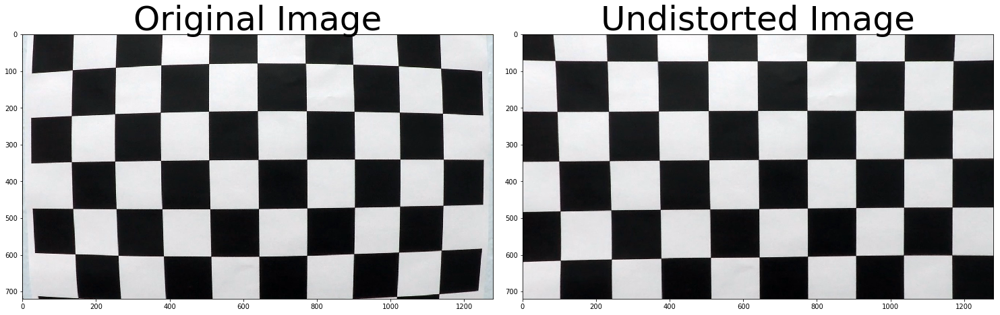

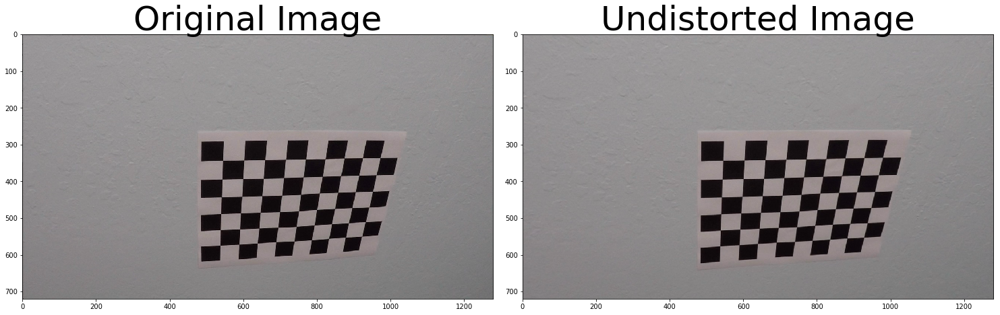

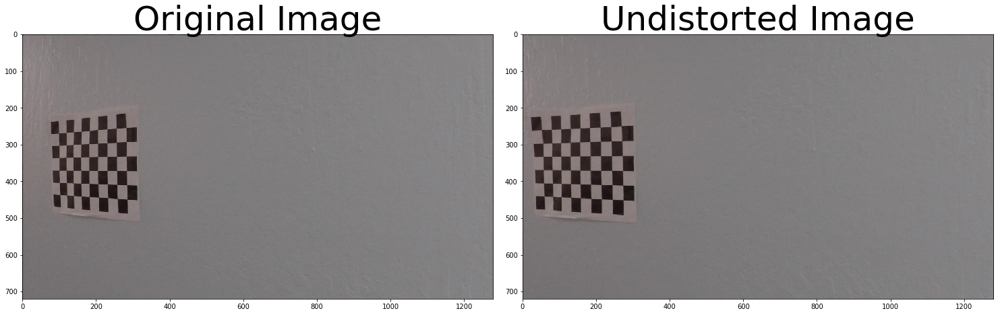

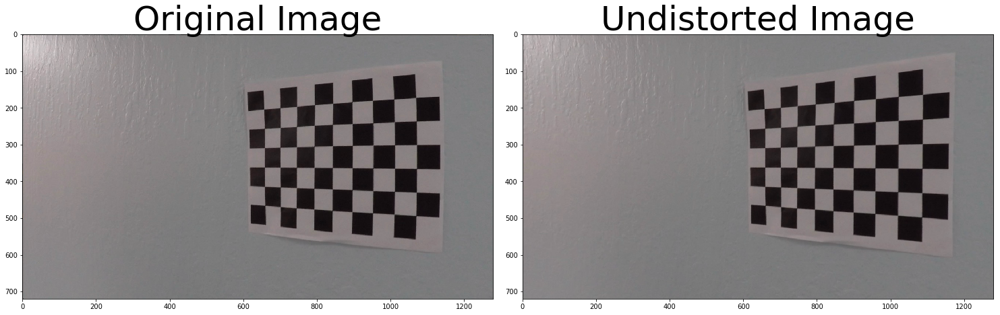

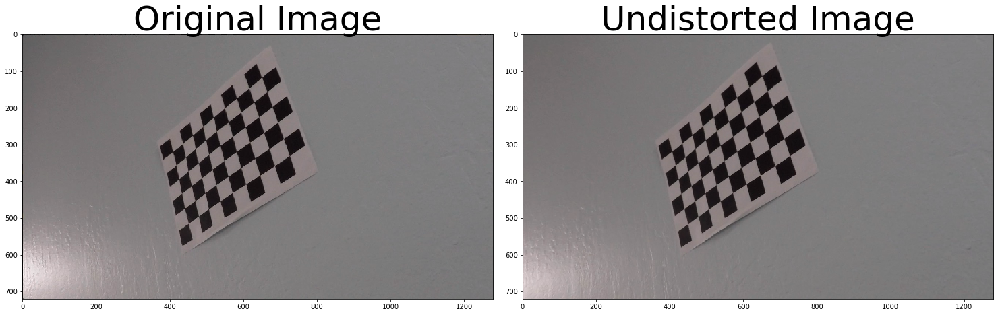

...

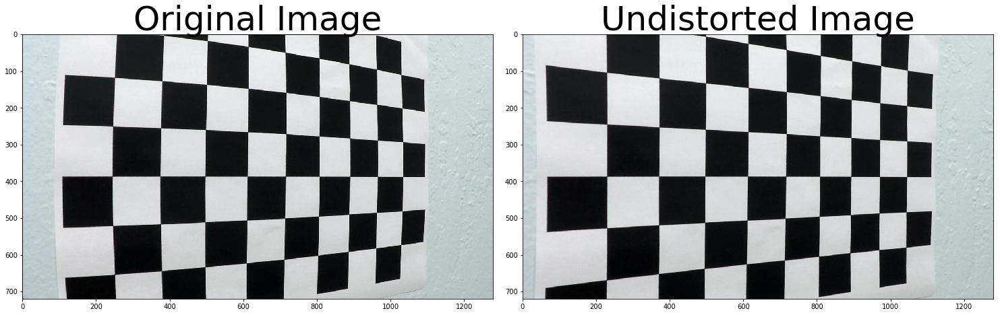

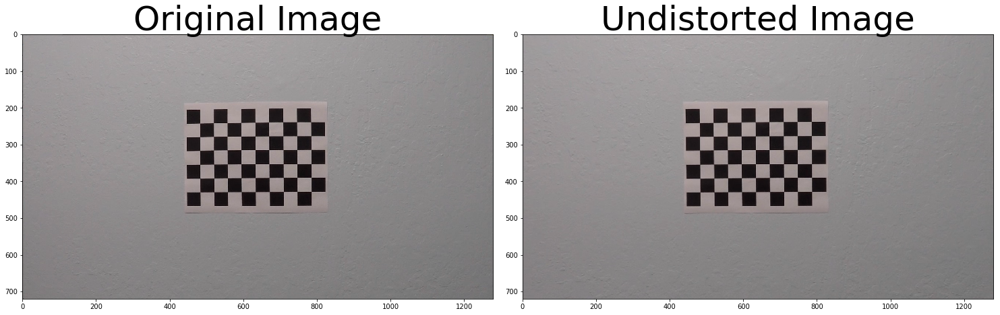

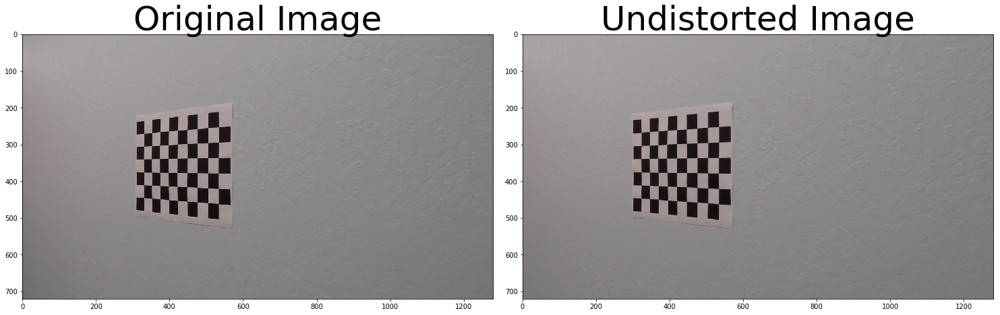

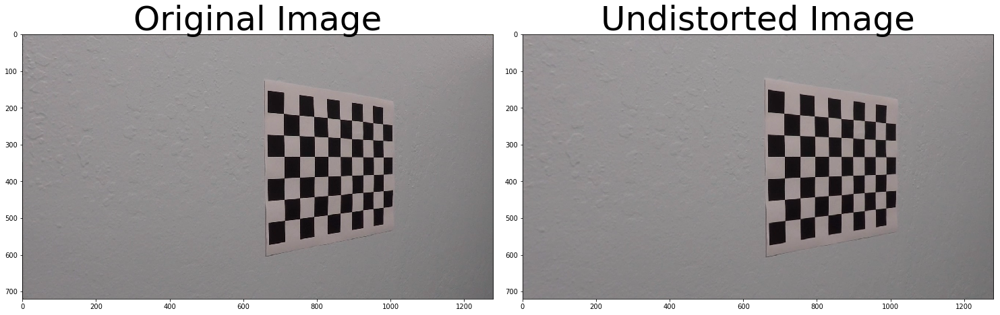

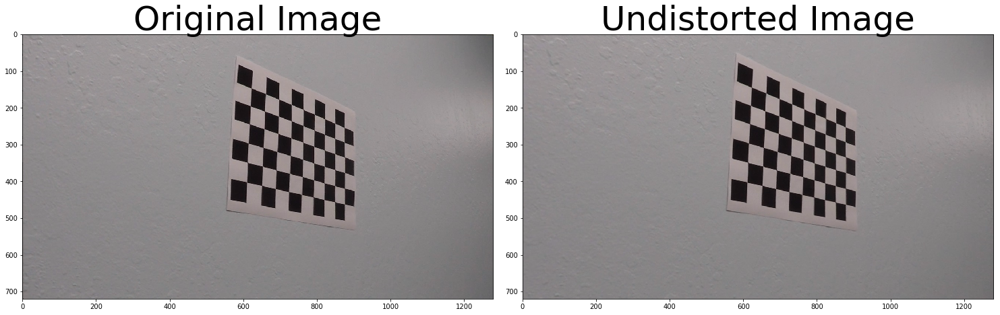

In [3]:
# Write a function that takes an image, object points, and image points
# performs the camera calibration, image distortion correction and 
# returns the undistorted image
def cal_undistort(img, objpoints, imgpoints):
    # Use cv2.calibrateCamera() and cv2.undistort()
    ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, img.shape[1::-1], None, None)
    undist = cv2.undistort(img, mtx, dist, None, mtx)
    return undist

for fname in images:
    image = cv2.imread(fname)
    undistorted = cal_undistort(image, objpoints, imgpoints)

    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 20))
    f.tight_layout()
    ax1.imshow(image)
    ax1.set_title('Original Image', fontsize=50)
    ax2.imshow(undistorted)
    ax2.set_title('Undistorted Image', fontsize=50)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

---
## Pipeline (single images)
<a id='step2'></a>
### Step 2 Apply a distortion correction to raw images

In this step, I computed the camera calibration and distortion coefficients using the `cv2.calibrateCamera()` from  `objpoints` and `imgpoints` the I applied the distortion correction to the test images using the `cv2.undistort()` function.

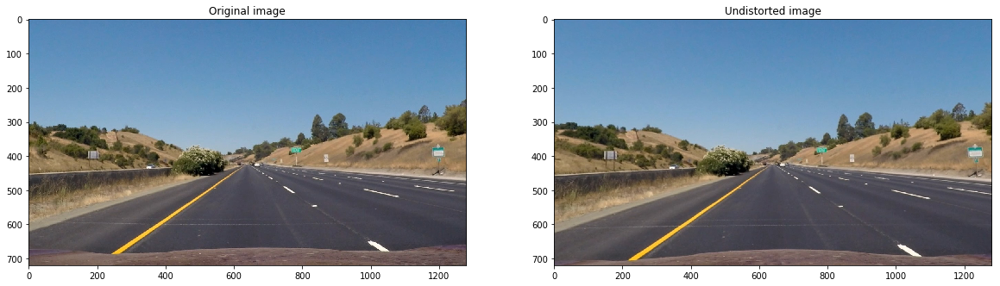

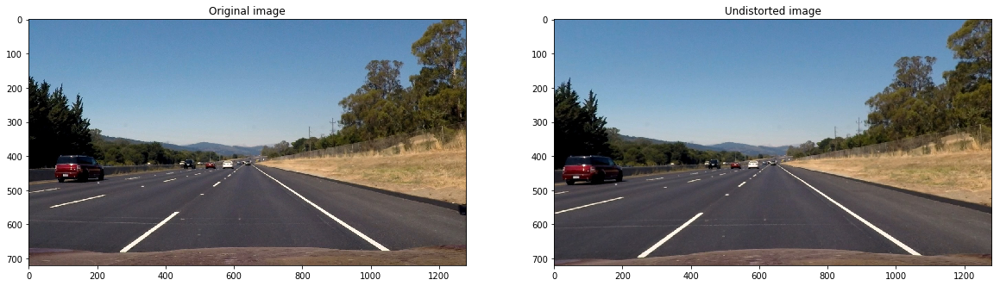

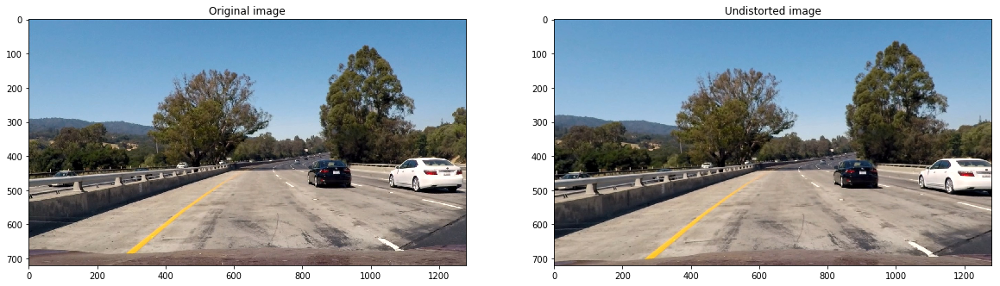

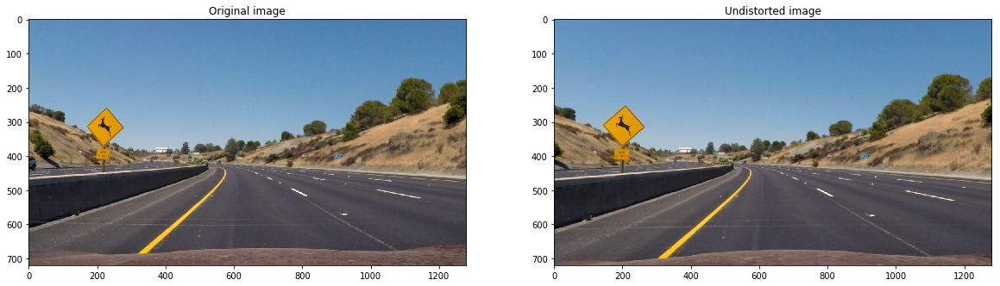

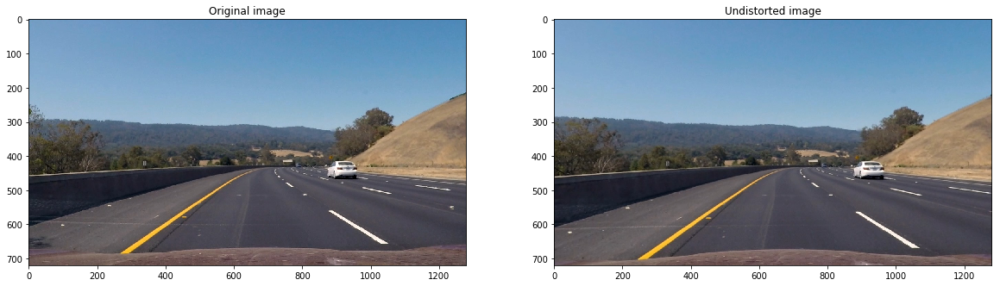

...

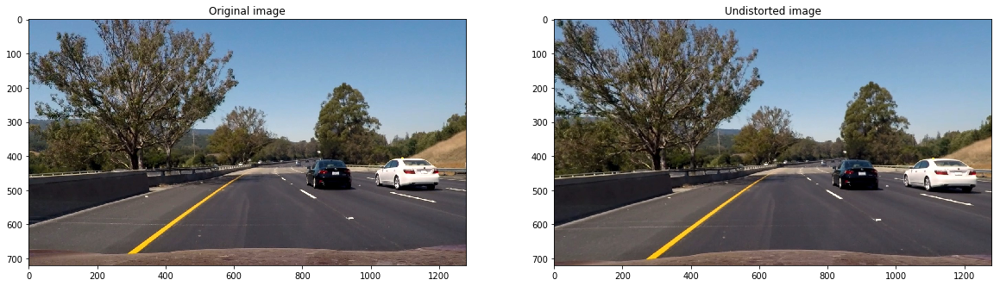

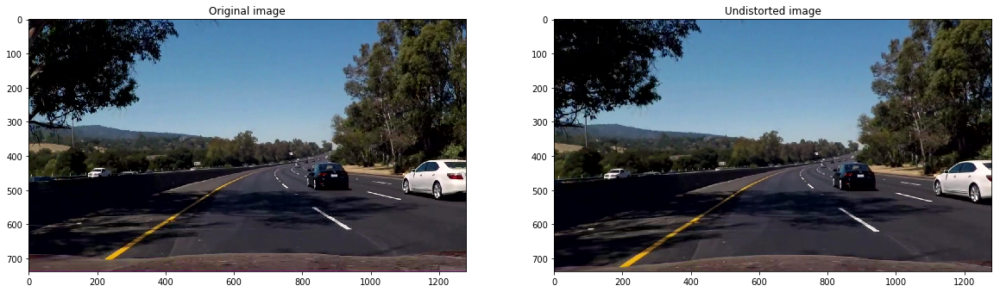

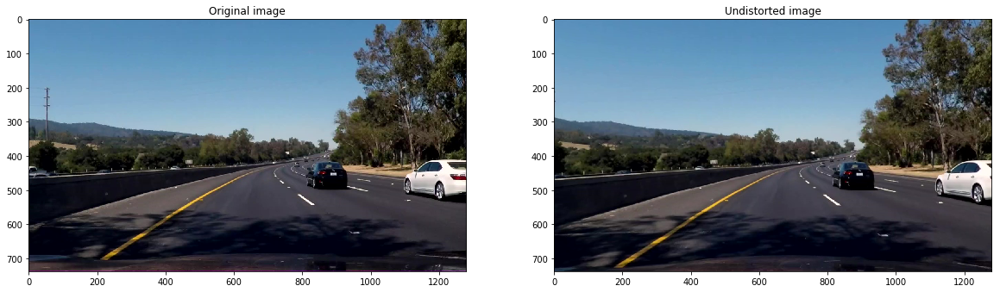

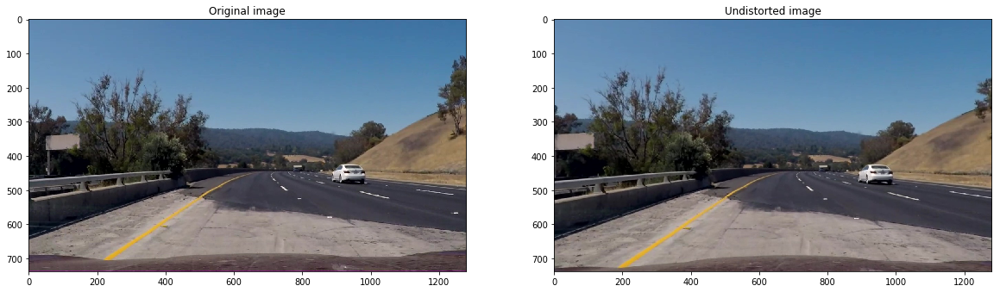

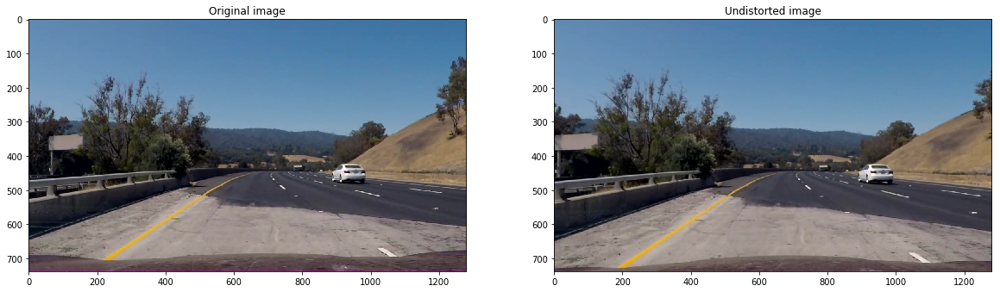

In [4]:
images = glob.glob('../test_images/*.jpg')

# Step through the list and undistort
for fname in images:
    img = mpimg.imread(fname)   

    ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, img.shape[1::-1], None, None)
    undist = cv2.undistort(img, mtx, dist, None, mtx)

    name, ext = os.path.splitext(os.path.basename(fname))    
    im = Image.fromarray(undist)
    im.save(''.join(['../output_images/undist_', name, '.jpg']))  
    
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,20))
    ax1.set_title('Original image')
    ax1.imshow(img)

    ax2.set_title('Undistorted image')
    ax2.imshow(undist)

<a id='step3'></a>
### Step 3 Use color transforms, gradients, etc., to create a thresholded binary image

I used a combination of color and gradient thresholds to generate a binary image. The undistorted image was transformed from RGB color space to different color spaces to separate desired color channels because the research showed that grayscale image losses a lot of information. Since the lightness keeps most of the image information, I tested with lightness channels (L-channel) in HLS, LUV or LAB color spaces) and to detect the yellow line I used B-channel of LAB color space. L-channel was input to the sobel edge detection using gradient. Only gradient w.r.t x direction was deployed because want to emphasis on vertical edges.

The combination of color and gradient thresholdings was deployed using the `pipeline()` function as below. Other gradient thresholding and color tranform functions are provided in the lectures for reference.

In [5]:
def abs_sobel_thresh(img, orient='x', sobel_kernel=3, thresh=(0, 255)):
    # Calculate directional gradient then Apply threshold
    # Apply the following steps to img
    # 1) Convert to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    # 2) Take the derivative in x or y given orient = 'x' or 'y'

    if orient == 'x':
        sobel = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    if orient == 'y':
        sobel = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    # 3) Take the absolute value of the derivative or gradient
    abs_sobel = np.sqrt(sobel**2)
    # 4) Scale to 8-bit (0 - 255) then convert to type = np.uint8
    scaled_sobel = np.uint8(255*abs_sobel/np.max(abs_sobel))
    # 5) Create a mask of 1's where the scaled gradient magnitude 
            # is > thresh_min and < thresh_max
    binary_output = np.zeros_like(scaled_sobel)     
    binary_output[(scaled_sobel >= thresh[0]) & (scaled_sobel <= thresh[1])] = 1       
    # 6) Return this mask as your binary_output image
    return binary_output


def mag_thresh(img, sobel_kernel=3, mag_thresh=(0, 255)):
    # Calculate gradient magnitude
    # Apply threshold
    # Apply the following steps to img
    # 1) Convert to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    # 2) Take the gradient in x and y separately
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    # 3) Calculate the magnitude 
    mag = np.sqrt(sobelx**2 + sobely**2)
    # 4) Scale to 8-bit (0 - 255) and convert to type = np.uint8
    max = np.max(mag/255)
    scaled = np.uint8(mag/max)
    # 5) Create a binary mask where mag thresholds are met
    binary_output = np.zeros_like(scaled)
    binary_output[(scaled >= mag_thresh[0]) & (scaled <= mag_thresh[1])] = 1
    # 6) Return this mask as your binary_output image
    #binary_output = np.copy(img) # Remove this line
    return binary_output    
    
    
def dir_threshold(img, sobel_kernel=3, thresh=(0, np.pi/2)):
    # Calculate gradient direction
    # Apply threshold    
    # Apply the following steps to img
    # 1) Convert to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    # 2) Take the gradient in x and y separately
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    # 3) Take the absolute value of the x and y gradients
    abs_sobelx = np.sqrt(sobelx**2)
    abs_sobely = np.sqrt(sobely**2)
    # 4) Use np.arctan2(abs_sobely, abs_sobelx) to calculate the direction of the gradient 
    direction = np.arctan2(abs_sobely, abs_sobelx)
    # 5) Create a binary mask where direction thresholds are met
    binary_output = np.zeros_like(direction)
    binary_output[(direction >= thresh[0]) & (direction <= thresh[1])] = 1
    # 6) Return this mask as your binary_output image
    return binary_output

def hls_select(img, thresh=(0, 255)):
    # 1) Convert to HLS color space
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    # 2) Apply a threshold to the S channel
    s_channel = hls[:,:,2]  
    # 3) Return a binary image of threshold result
    binary_output = np.zeros_like(s_channel)
    binary_output[(s_channel > thresh[0]) & (s_channel <= thresh[1])] = 1
    return binary_output

def hsv_select(img, s_thresh=(0, 255), v_thresh=(0, 255)):
    # 1) Convert to HSV color space
    hsv = cv2.cvtColor(img, cv2.COLOR_RGB2HSV)
    # 2) Apply a threshold to the S channel
    s_channel = hsv[:,:,1]  
    v_channel = hsv[:,:,2] 
    # 3) Return a binary image of threshold result
    s_binary = np.zeros_like(s_channel)
    s_binary[(s_channel >= s_thresh[0]) & (s_channel <= s_thresh[1])] = 1
    v_binary = np.zeros_like(v_channel)
    v_binary[(v_channel >= v_thresh[0]) & (v_channel <= v_thresh[1])] = 1
    
    binary_output = np.zeros_like(s_channel)
    binary_output[(s_binary == 1) | (v_binary == 1)] = 1
    
    return binary_output


def pipeline(img, s_thresh=(170, 255), l_thresh=(190, 255), b_thresh=(150, 255), sx_thresh=(20, 100), sobel_kernel=9):
    img = np.copy(img)
    # Convert to HLS color space and separate the V channel    
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HSV).astype(np.float)
    l_channel = hls[:,:,1]
    s_channel = hls[:,:,2]
    luv = cv2.cvtColor(img, cv2.COLOR_RGB2LUV).astype(np.float)
    l_channel = luv[:,:,0]
    lab = cv2.cvtColor(img, cv2.COLOR_RGB2LAB).astype(np.float)
    #l_channel = luv[:,:,0]
    b_channel = lab[:,:,2]
    
    # Threshold color channel
    s_binary = np.zeros_like(s_channel)
    s_binary[(s_channel >= s_thresh[0]) & (s_channel <= s_thresh[1])] = 1
    # Threshold color channel
    l_binary = np.zeros_like(l_channel)
    l_binary[(l_channel >= l_thresh[0]) & (l_channel <= l_thresh[1])] = 1
    # Threshold color channel
    b_binary = np.zeros_like(b_channel)
    b_binary[(b_channel >= b_thresh[0]) & (b_channel <= b_thresh[1])] = 1
    
    # Sobel x
    sobelx = cv2.Sobel(l_channel, cv2.CV_64F, 1, 0, ksize=sobel_kernel) # Take the derivative in x
    abs_sobelx = np.absolute(sobelx) # Absolute x derivative to accentuate lines away from horizontal
    scaled_sobel = np.uint8(255*abs_sobelx/np.max(abs_sobelx))
    
    # Threshold x gradient
    sxbinary = np.zeros_like(scaled_sobel)
    sxbinary[(scaled_sobel >= sx_thresh[0]) & (scaled_sobel <= sx_thresh[1])] = 1
    
    # Stack each channel
    # Note color_binary[:, :, 0] is all 0s, effectively an all black image. It might
    # be beneficial to replace this channel with something else.
    color_binary = np.uint8(np.dstack((b_binary, l_binary, sxbinary)) * 255)
    
    # Combine the two binary thresholds
    combined_binary = np.zeros_like(sxbinary)
    combined_binary[(b_binary == 1) | (l_binary == 1) | (sxbinary == 1)] = 1
    return color_binary, combined_binary

Undistorted images are used to create thresholded binary images. Here, I plotted color_binary images with thresholds stacked in R, G, B channels. The combine thresholded binary images also were presented.

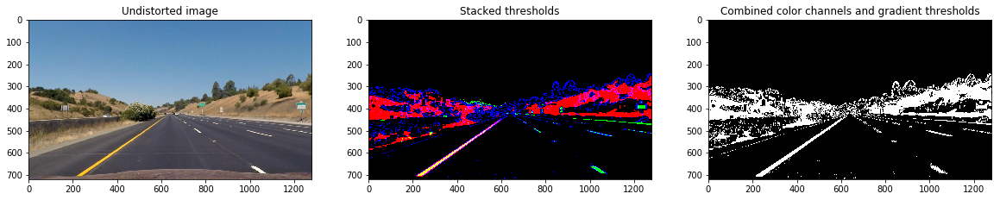

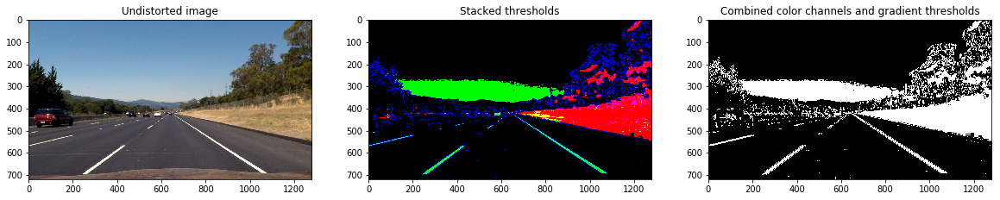

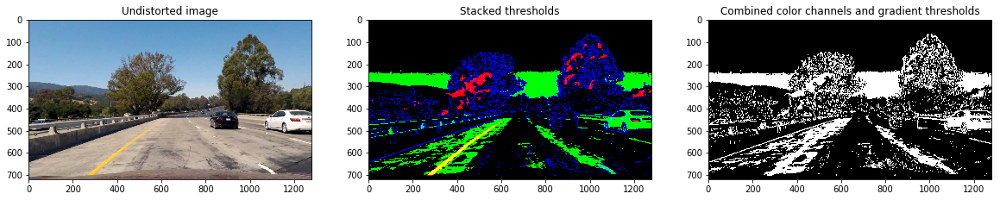

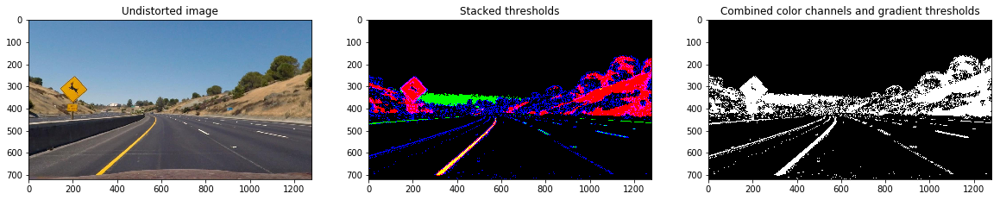

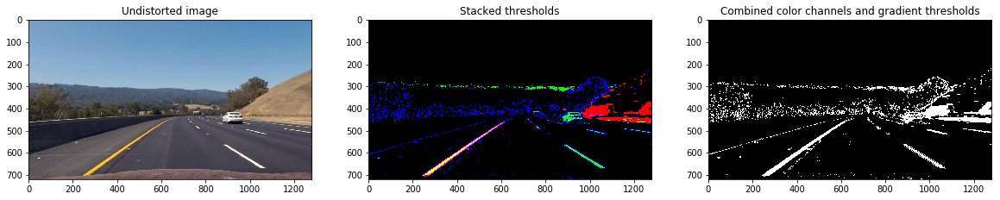

...

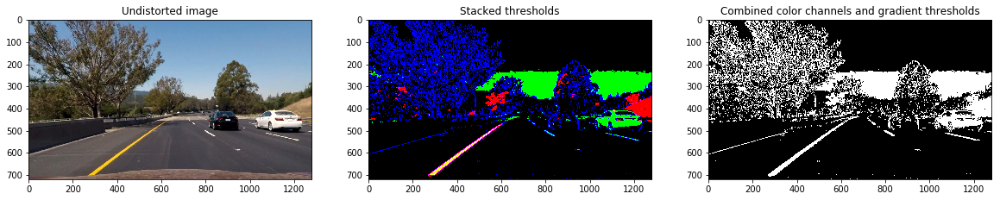

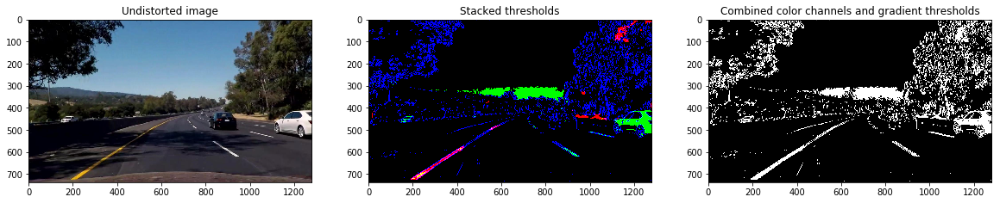

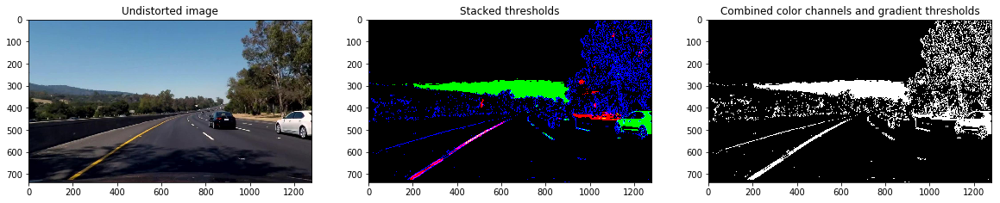

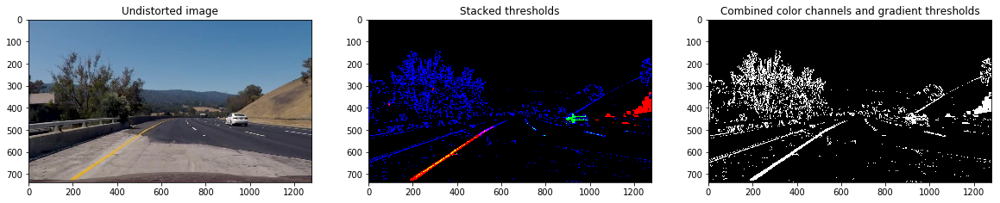

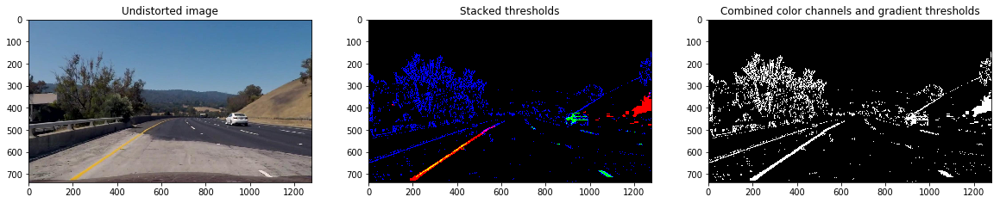

In [6]:
# Make a list of undistorted images
images = glob.glob('../output_images/undist_*.jpg')

# Step through the list and search for chessboard corners
for fname in images:
    img = mpimg.imread(fname)   
    name, ext = os.path.splitext(os.path.basename(fname))

    # Step 3: Use color transforms, gradients, etc., to create a thresholded binary image

    # Choose a Sobel kernel size
    ksize = 9 # Choose a larger odd number to smooth gradient measurements

    # Apply each of the thresholding functions
    #gradx = abs_sobel_thresh(img, orient='x', sobel_kernel=ksize, thresh=(20, 100))
    #grady = abs_sobel_thresh(img, orient='y', sobel_kernel=ksize, thresh=(20, 100))
    #mag_binary = mag_thresh(img, sobel_kernel=ksize, mag_thresh=(30, 100))
    #dir_binary = dir_threshold(img, sobel_kernel=ksize, thresh=(0.7, 1.3))
    #hls_binary = hls_select(img, thresh=(100, 255))
    #hsv_binary = hsv_select(img, s_thresh=(256, 0), v_thresh=(170, 255))

    #combined = np.zeros_like(dir_binary)
    #combined[((gradx == 1) & (grady == 1)) | ((mag_binary == 1) & (dir_binary == 1)) | (hls_binary == 1)] = 1
    #combined = np.uint8(combined1 * 255)

    color_binary, combined_binary = pipeline(img, sobel_kernel=ksize)   
    combined_binary = np.uint8(combined_binary * 255)

    f, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(20,20))
    ax1.set_title('Undistorted image')
    ax1.imshow(img)

    ax2.set_title('Stacked thresholds')
    ax2.imshow(color_binary)

    ax3.set_title('Combined color channels and gradient thresholds')
    ax3.imshow(combined_binary, cmap='gray')
  
    im = Image.fromarray(combined_binary)
    im.save(''.join(['../output_images/combined_', name, '.jpg'])) 

### <a id='step4'></a>
### Step 4 Apply a perspective transform to rectify binary image ("birds-eye view")

Here, I describe how to perform a perspective transform and provide an example of a transformed image.

The code for my perspective transform includes a function called `warper()`. The warper() function takes as inputs an image (img), as well as source (src) and destination (dst) points. I chose the hardcode the source and destination points in the following manner:

```python
src = np.float32(
    [[(img_size[0] / 2) - 55, img_size[1] / 2 + 100],
    [((img_size[0] / 6) - 10), img_size[1]],
    [(img_size[0] * 5 / 6) + 60, img_size[1]],
    [(img_size[0] / 2 + 55), img_size[1] / 2 + 100]])
dst = np.float32(
    [[(img_size[0] / 6), 0],
    [(img_size[0] / 6), img_size[1]],
    [(img_size[0] * 5 / 6), img_size[1]],
    [(img_size[0] * 5 / 6), 0]])
```

This resulted in the following source and destination points:

| Source        | Destination   | 
|:-------------:|:-------------:| 
| 585, 460      | 320, 0        | 
| 203, 720      | 320, 720      |
| 1127, 720     | 960, 720      |
| 695, 460      | 960, 0        |

I verified that my perspective transform was working as expected by drawing the src and dst points onto a test image and its warped counterpart to verify that the lines appear parallel in the warped image.

In [7]:
# camera matrix and distortion coefficients
def warper(img, src, dst):
    """
    Define a function that takes an image, number of src and dst points,
    To get the Perspective Transform matrix and    
    Warp an undistorted matrix
    """     
    # Given src and dst points, calculate the perspective transform matrix
    M = cv2.getPerspectiveTransform(src, dst)
    # Warp the image using OpenCV warpPerspective()
    warped = cv2.warpPerspective(img, M, (img.shape[1], img.shape[0]))

    # Return the resulting image and matrix
    return warped, M

def draw_region(img, vertices, α=1., β=0.8, λ=0.):
    """
    Draw the region defined by vertices on the input image
    The result image is computed as follows:    
    region * α + img * β + λ
    """ 
    region = np.copy(img)*0 
    for i in range(0,3):
        cv2.line(region,tuple(vertices[i]),tuple(vertices[i+1]),(0,0,255),5) #draw lines with blue and size = 10
    cv2.line(region,tuple(vertices[3]),tuple(vertices[0]),(0,0,255),5)

    return cv2.addWeighted(region, α, img, β, λ)



/Users/phuongpham/anaconda3/anaconda/envs/carnd-term1/lib/python3.5/site-packages/matplotlib/pyplot.py:524: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


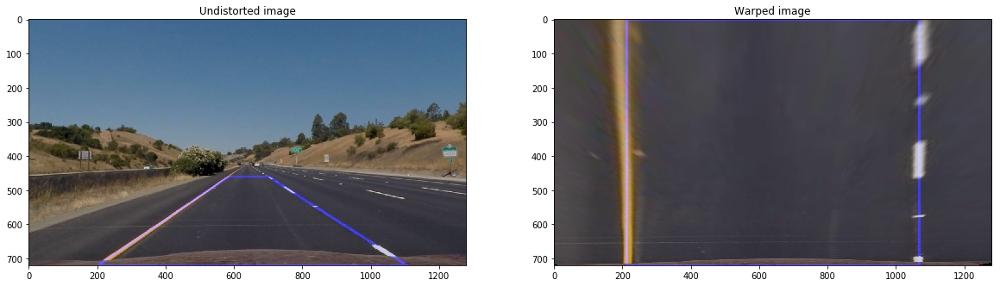

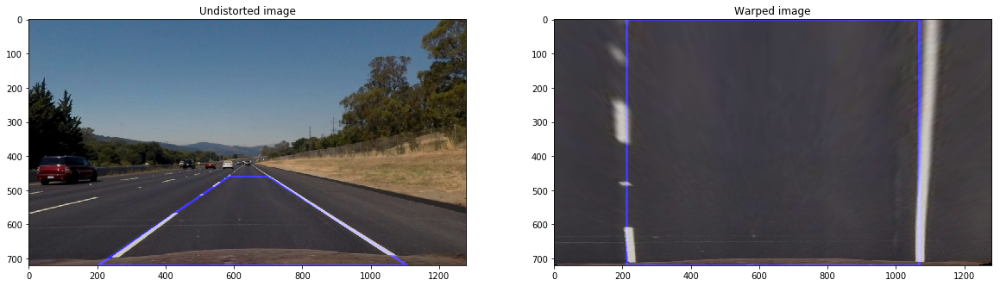

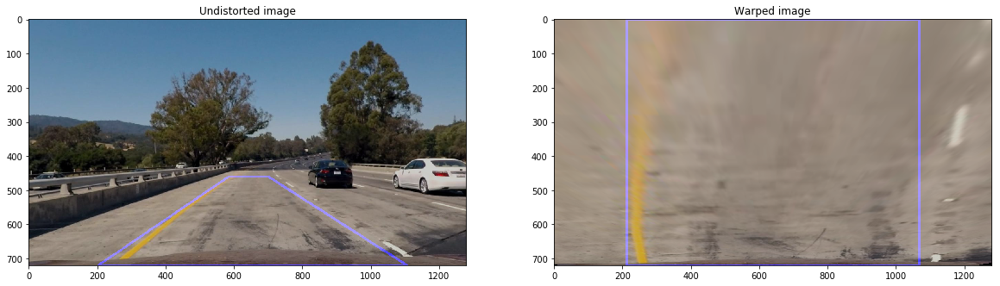

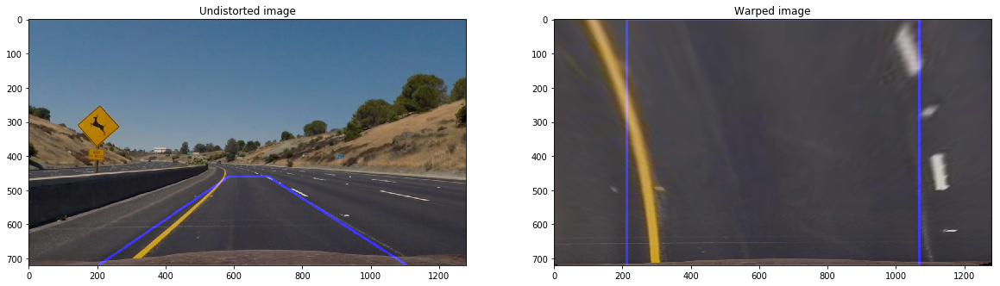

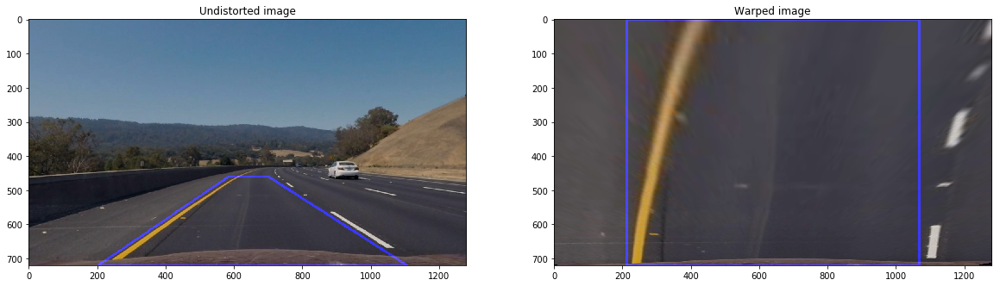

...

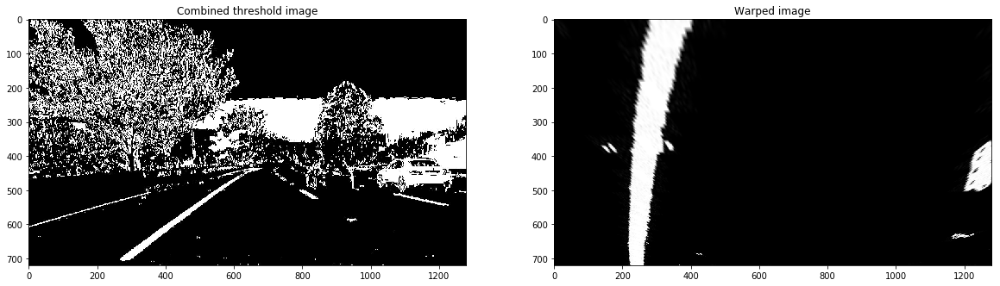

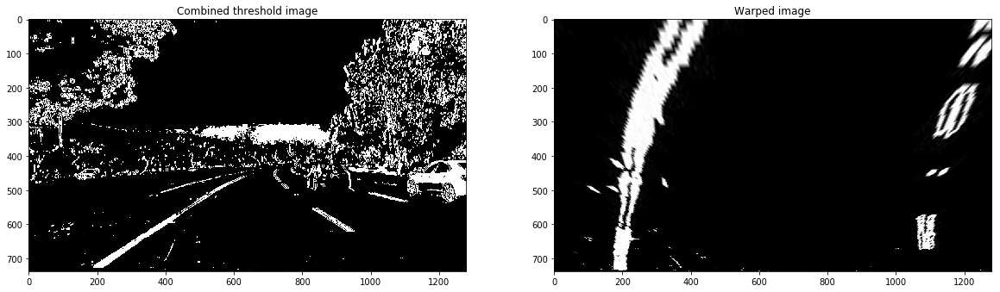

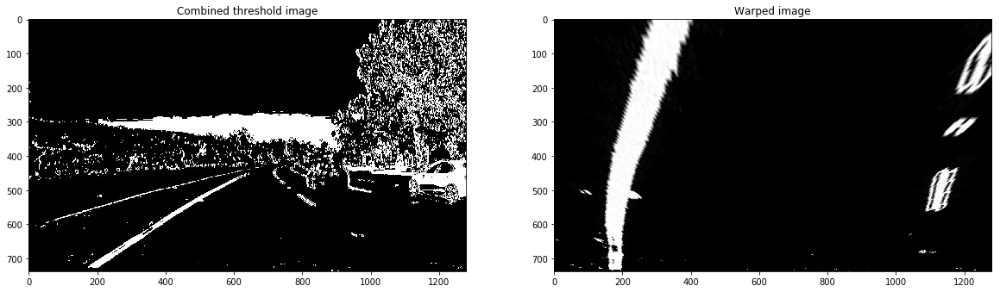

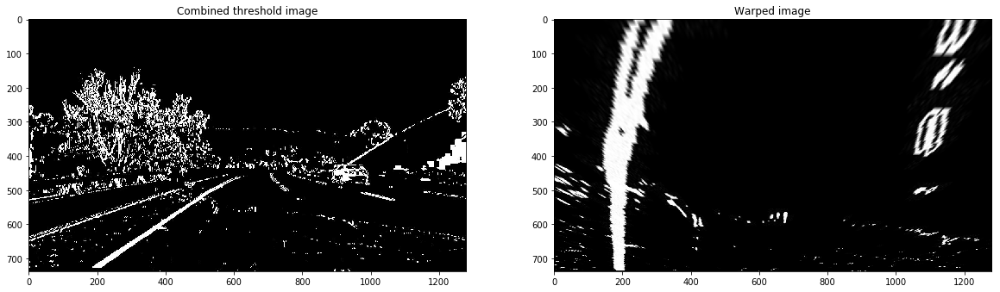

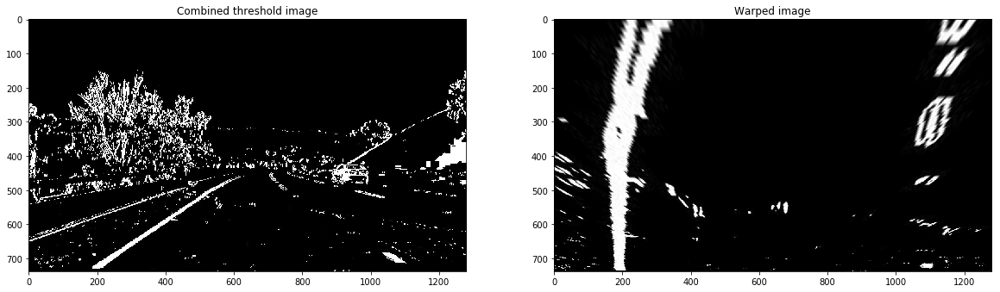

In [8]:
images = glob.glob('../output_images/undist_*.jpg')

# Step through the list and apply perspective transform
for fname in images:
    img = mpimg.imread(fname) 
    
    img_size = (img.shape[1], img.shape[0])  
    
    src = np.float32(
        [[(img_size[0] / 2) - 55, img_size[1] / 2 + 100],
        [((img_size[0] / 6) - 10), img_size[1]],
        [(img_size[0] * 5 / 6) + 40, img_size[1]],
        [(img_size[0] / 2 + 60), img_size[1] / 2 + 100]])
    dst = np.float32(
        [[(img_size[0] / 6), 0],
        [(img_size[0] / 6), img_size[1]],
        [(img_size[0] * 5 / 6), img_size[1]],
        [(img_size[0] * 5 / 6), 0]])

    warped, perspective_M = warper(img, src, dst)

    name, ext = os.path.splitext(os.path.basename(fname))    
    im = Image.fromarray(warped)
    im.save(''.join(['../output_images/warped_', name, '.jpg'])) 

    vertices_src = np.array(src, dtype=np.int32)
    region_img = draw_region(img, vertices_src)
    
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,20))
    ax1.set_title('Undistorted image')
    ax1.imshow(region_img)

    vertices_dst = np.array(dst, dtype=np.int32)  
    region_warped = draw_region(warped, vertices_dst)
    
    ax2.set_title('Warped image')
    ax2.imshow(region_warped)
    
images = glob.glob('../output_images/combined_*.jpg')

# Step through the list and apply perspective transform
for fname in images:
    img = mpimg.imread(fname) 
    
    img_size = (img.shape[1], img.shape[0])    
    warped, perspective_M = warper(img, src, dst)

    name, ext = os.path.splitext(os.path.basename(fname))    
    im = Image.fromarray(warped)
    im.save(''.join(['../output_images/warped_', name, '.jpg'])) 

    #vertices_src = np.array(src, dtype=np.int32)
    #region_img = draw_region(img, vertices_src)
    
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,20))
    ax1.set_title('Combined threshold image')
    ax1.imshow(img, cmap='gray')

    #vertices_dst = np.array(dst, dtype=np.int32)  
    #region_warped = draw_region(warped, vertices_dst)
    
    ax2.set_title('Warped image')
    ax2.imshow(warped, cmap='gray')
    

<a id='step5'></a>
### Step 5 Detect lane pixels and fit to find the lane boundary

Describe how (and identify where in your code) you identified lane-line pixels and fit their positions with a polynomial?

Then I did some other stuff and fit my lane lines with a 2nd order polynomial kinda like this:

alt text

In [9]:
def detect_lane(binary_warped, undist, Minv, is_plotting=False, is_first_frame=True, left_fit=np.array([0,0,0]), right_fit=np.array([0,0,0])):
    # 1.Implement Sliding Windows and Fit a Polynomial
    
    if is_first_frame==True:
        # Assuming you have created a warped binary image called "binary_warped"
        # Take a histogram of the bottom half of the image
        histogram = np.sum(binary_warped[np.int(binary_warped.shape[0]/2):,:], axis=0)
        # Create an output image to draw on and  visualize the result
        out_img = np.dstack((binary_warped, binary_warped, binary_warped))*255
        #out_img = np.dstack((binary_warped, binary_warped, binary_warped))
        # Find the peak of the left and right halves of the histogram
        # These will be the starting point for the left and right lines
        midpoint = np.int(histogram.shape[0]/2)
        leftx_base = np.argmax(histogram[:midpoint])
        rightx_base = np.argmax(histogram[midpoint:]) + midpoint

        # Choose the number of sliding windows
        nwindows = 6
        # Set height of windows
        window_height = np.int(binary_warped.shape[0]/nwindows)
        # Identify the x and y positions of all nonzero pixels in the image
        nonzero = binary_warped.nonzero()
        nonzeroy = np.array(nonzero[0])
        nonzerox = np.array(nonzero[1])
        # Current positions to be updated for each window
        leftx_current = leftx_base
        rightx_current = rightx_base
        # Set the width of the windows +/- margin
        margin = 100
        # Set minimum number of pixels found to recenter window
        minpix = 50
        # Create empty lists to receive left and right lane pixel indices
        left_lane_inds = []
        right_lane_inds = []

        # Step through the windows one by one
        for window in range(nwindows):
            # Identify window boundaries in x and y (and right and left)
            win_y_low = binary_warped.shape[0] - (window+1)*window_height
            win_y_high = binary_warped.shape[0] - window*window_height
            win_xleft_low = leftx_current - margin
            win_xleft_high = leftx_current + margin
            win_xright_low = rightx_current - margin
            win_xright_high = rightx_current + margin
            # Draw the windows on the visualization image
            cv2.rectangle(out_img,(win_xleft_low,win_y_low),(win_xleft_high,win_y_high),
            (0,255,0), 2) 
            cv2.rectangle(out_img,(win_xright_low,win_y_low),(win_xright_high,win_y_high),
            (0,255,0), 2) 
            # Identify the nonzero pixels in x and y within the window
            good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
            (nonzerox >= win_xleft_low) &  (nonzerox < win_xleft_high)).nonzero()[0]
            good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
            (nonzerox >= win_xright_low) &  (nonzerox < win_xright_high)).nonzero()[0]
            # Append these indices to the lists
            left_lane_inds.append(good_left_inds)
            right_lane_inds.append(good_right_inds)
            # If you found > minpix pixels, recenter next window on their mean position
            if len(good_left_inds) > minpix:
                leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
            if len(good_right_inds) > minpix:        
                rightx_current = np.int(np.mean(nonzerox[good_right_inds]))

        # Concatenate the arrays of indices
        left_lane_inds = np.concatenate(left_lane_inds)
        right_lane_inds = np.concatenate(right_lane_inds)

        # Extract left and right line pixel positions
        leftx = nonzerox[left_lane_inds]
        lefty = nonzeroy[left_lane_inds] 
        rightx = nonzerox[right_lane_inds]
        righty = nonzeroy[right_lane_inds] 

        # Fit a second order polynomial to each
        left_fit = np.polyfit(lefty, leftx, 2)
        right_fit = np.polyfit(righty, rightx, 2)
        #print(left_fit)
        #print(right_fit)

        # Visualization

        # Generate x and y values for plotting
        ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
        left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
        right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]

        out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
        out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]
        
        # Drawing

        # Create an image to draw the lines on
        warped = binary_warped * 255
        warp_zero = np.zeros_like(warped).astype(np.uint8)
        color_warp = np.dstack((warp_zero, warp_zero, warp_zero))

        # Recast the x and y points into usable format for cv2.fillPoly()
        pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
        pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
        pts = np.hstack((pts_left, pts_right))

        # Draw the lane onto the warped blank image
        cv2.fillPoly(color_warp, np.int_([pts]), (0,255, 0))

        # Warp the blank back to original image space using inverse perspective matrix (Minv)
        newwarp = cv2.warpPerspective(color_warp, Minv, (binary_warped.shape[1], binary_warped.shape[0])) 
        # Combine the result with the original image
        result = cv2.addWeighted(undist, 1, newwarp, 0.3, 0)
    
    
    # 2. Skip the sliding windows step once you know where the lines are
    # Now you know where the lines are you have a fit! In the next frame of video you don't need to do a blind search
    # again, but instead you can just search in a margin around the previous line position.
    
    # Assume you now have a new warped binary image 
    # from the next frame of video (also called "binary_warped")
    # It's now much easier to find line pixels!
    if is_first_frame == False:
        nonzero = binary_warped.nonzero()
        nonzeroy = np.array(nonzero[0])
        nonzerox = np.array(nonzero[1])
        margin = 100
        left_lane_inds = ((nonzerox > (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + 
        left_fit[2] - margin)) & (nonzerox < (left_fit[0]*(nonzeroy**2) + 
        left_fit[1]*nonzeroy + left_fit[2] + margin))) 

        right_lane_inds = ((nonzerox > (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + 
        right_fit[2] - margin)) & (nonzerox < (right_fit[0]*(nonzeroy**2) + 
        right_fit[1]*nonzeroy + right_fit[2] + margin)))  

        # Again, extract left and right line pixel positions
        leftx = nonzerox[left_lane_inds]
        lefty = nonzeroy[left_lane_inds] 
        rightx = nonzerox[right_lane_inds]
        righty = nonzeroy[right_lane_inds]
        # Fit a second order polynomial to each
        left_fit = np.polyfit(lefty, leftx, 2)
        right_fit = np.polyfit(righty, rightx, 2)
        # Generate x and y values for plotting
        ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
        left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
        right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]

        # And you're done! But let's visualize the result here as well
        # Create an image to draw on and an image to show the selection window
        out_img = np.dstack((binary_warped, binary_warped, binary_warped))*255
        window_img = np.zeros_like(out_img)
        # Color in left and right line pixels
        out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
        out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]

        #'''
        # Generate a polygon to illustrate the search window area
        # And recast the x and y points into usable format for cv2.fillPoly()
        left_line_window1 = np.array([np.transpose(np.vstack([left_fitx-margin, ploty]))])
        left_line_window2 = np.array([np.flipud(np.transpose(np.vstack([left_fitx+margin, 
                                      ploty])))])
        left_line_pts = np.hstack((left_line_window1, left_line_window2))
        right_line_window1 = np.array([np.transpose(np.vstack([right_fitx-margin, ploty]))])
        right_line_window2 = np.array([np.flipud(np.transpose(np.vstack([right_fitx+margin, 
                                      ploty])))])
        right_line_pts = np.hstack((right_line_window1, right_line_window2))

        # Draw the lane onto the warped blank image
        cv2.fillPoly(window_img, np.int_([left_line_pts]), (0,255, 0))
        cv2.fillPoly(window_img, np.int_([right_line_pts]), (0,255, 0))
        result = cv2.addWeighted(out_img, 1, window_img, 0.3, 0)
        #'''

    # 3.Measuring Curvature  
    # Now we have polynomial fits and we can calculate the radius of curvature as follows:
    left_ploty = np.linspace(0, binary_warped.shape[0]-1, leftx.shape[0] )
    right_ploty = np.linspace(0, binary_warped.shape[0]-1, rightx.shape[0] )

    # Define y-value where we want radius of curvature
    # I'll choose the maximum y-value, corresponding to the bottom of the image
    y_eval = np.max(ploty)
    left_curverad = ((1 + (2*left_fit[0]*y_eval + left_fit[1])**2)**1.5) / np.absolute(2*left_fit[0])
    right_curverad = ((1 + (2*right_fit[0]*y_eval + right_fit[1])**2)**1.5) / np.absolute(2*right_fit[0])
    #print(left_curverad, right_curverad)
    # Example values: 1926.74 1908.48
    
    # Define conversions in x and y from pixels space to meters
    ym_per_pix = 30/720 # meters per pixel in y dimension
    xm_per_pix = 3.7/700 # meters per pixel in x dimension

    #print(leftx.shape)
    #print(rightx.shape)
    # Fit new polynomials to x,y in world space
    left_fit_cr = np.polyfit(left_ploty*ym_per_pix, leftx*xm_per_pix, 2)
    right_fit_cr = np.polyfit(right_ploty*ym_per_pix, rightx*xm_per_pix, 2)
    # Calculate the new radii of curvature
    left_curverad = ((1 + (2*left_fit_cr[0]*y_eval*ym_per_pix + left_fit_cr[1])**2)**1.5) / np.absolute(2*left_fit_cr[0])
    right_curverad = ((1 + (2*right_fit_cr[0]*y_eval*ym_per_pix + right_fit_cr[1])**2)**1.5) / np.absolute(2*right_fit_cr[0])
    # Now our radius of curvature is in meters
    print(left_curverad, 'm', right_curverad, 'm')
    # Example values: 632.1 m    626.2 m
    
    
    if is_plotting == True:
        f, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(20,20))
        ax1.set_title('Wraped image')
        ax1.imshow(img, cmap='gray')
        ax2.set_title('Land deteted image')
        ax2.imshow(out_img)
        ax2.plot(left_fitx, ploty, color='yellow')
        ax2.plot(right_fitx, ploty, color='yellow')
        ax2.set_xlim(0, 1280)
        ax2.set_ylim(720, 0)
        ax3.set_title('Projected image')
        ax3.imshow(result)
    
    return result 
    

1236.2617001 m 4078.99106972 m
11895.2258706 m 114872.204615 m
562.498836073 m 576.062330224 m
1863.93567879 m 276.298645502 m
945.484202931 m 443.805427694 m
13096.9571318 m 1212.67566733 m
1338.52018561 m 529.053660069 m
4031.12633317 m 625.239072021 m
489.855650502 m 75301.9273316 m
730.527418032 m 1385.65129506 m
440.334628089 m 2538.47564976 m
651.196493452 m 581.486252597 m


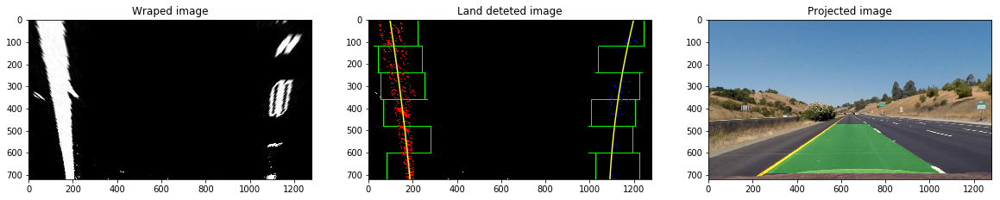

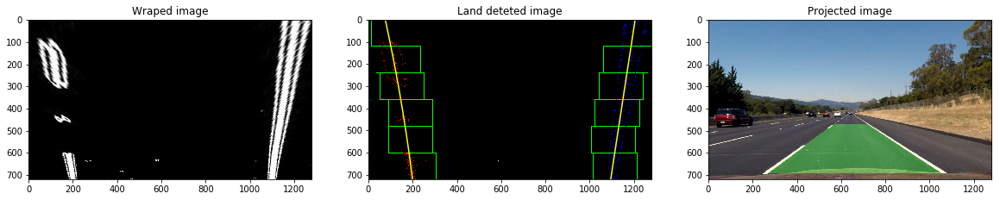

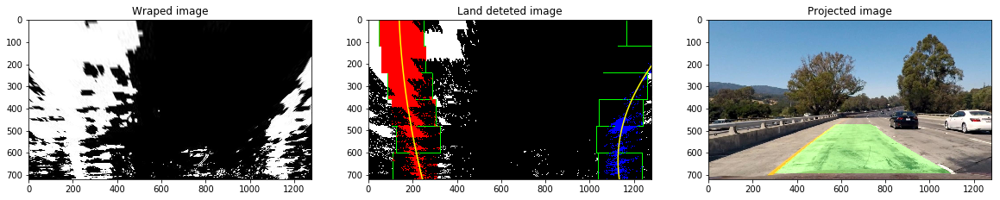

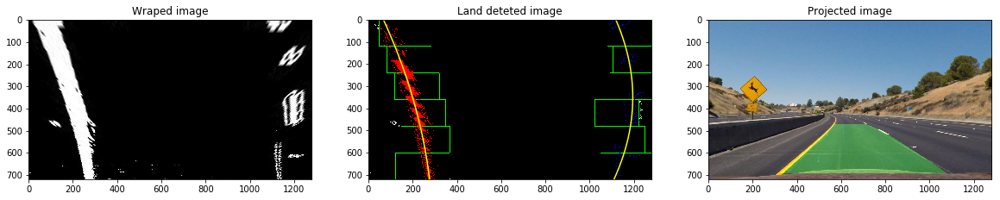

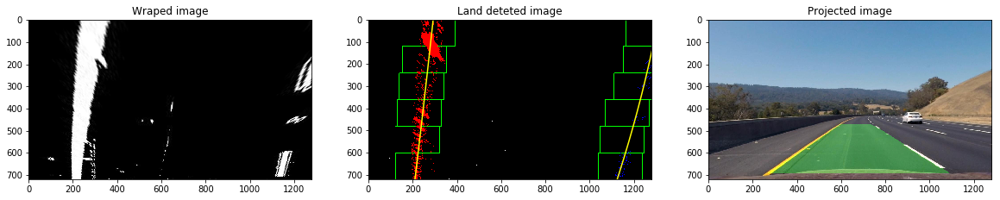

...

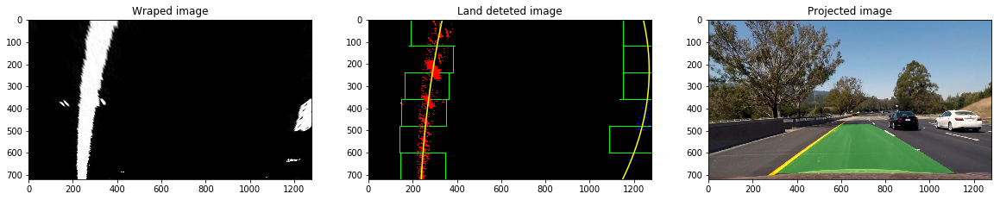

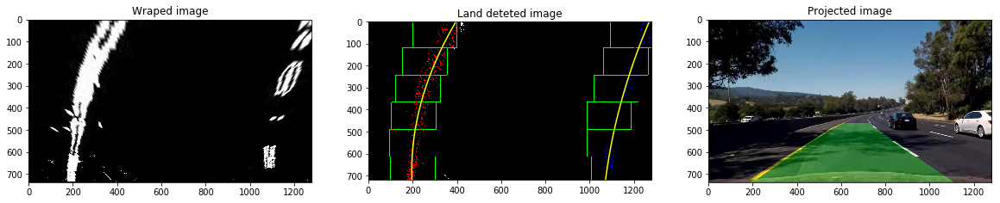

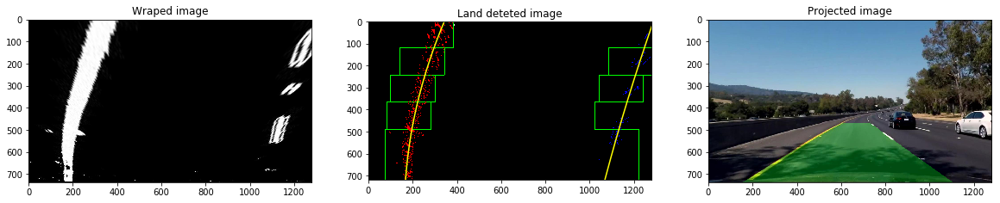

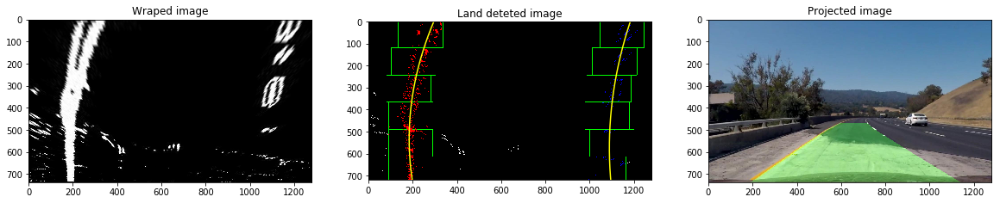

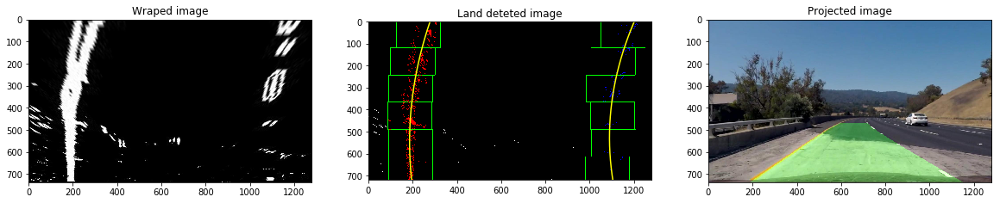

In [10]:
images = glob.glob('../output_images/warped_combined_*.jpg')
images_undist = glob.glob('../output_images/undist_*.jpg')

Minv = cv2.getPerspectiveTransform(dst, src)    
# Step through the list and find the lines
for fname,fname_undist in zip(images,images_undist):
    img = mpimg.imread(fname)
    undist = mpimg.imread(fname_undist)
    
    binary_warped = np.uint8(img/255)
    left_fit = None #np.array([0.000234215523e-04,  -4.01163553e-01,   4.02152640e+02])
    right_fit = None #np.array([4.03499309e-04,  -5.04786652e-01,   1.20659090e+03])
    result = detect_lane(binary_warped, undist, Minv, is_plotting=True, is_first_frame=True, left_fit=left_fit, right_fit=right_fit)
    

<a id='step6'></a>
### Step 6 Determine the curvature of the lane and vehicle position with respect to center

Describe how (and identify where in your code) you calculated the radius of curvature of the lane and the position of the vehicle with respect to center.

I did this in lines # through # in my code in my_other_file.py

<a id='step7'></a>
### Step 7 Warp the detected lane boundaries back onto the original image

Provide an example image of your result plotted back down onto the road such that the lane area is identified clearly.

I implemented this step in lines # through # in my code in yet_another_file.py in the function map_lane(). Here is an example of my result on a test image:

---
## Pipeline (Video)

<a id='step8'></a>
### Step 8 Output visual display of the lane boundaries and numerical estimation of lane curvature and vehicle position

Provide a link to your final video output. Your pipeline should perform reasonably well on the entire project video (wobbly lines are ok but no catastrophic failures that would cause the car to drive off the road!).

Here's a link to my video result

In [11]:
# Import everything needed to edit/save/watch video clips
from moviepy.editor import VideoFileClip
from IPython.display import HTML

In [12]:
import imageio
imageio.plugins.ffmpeg.download()

In [13]:
def process_image(img):
    # NOTE: The output you return should be a color image (3 channel) for processing video below
    # TODO: put your pipeline here,
    # you should return the final output (image where lines are drawn on lanes)

    # Step 2 Apply distortion correction to the raw image
    ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, img.shape[1::-1], None, None)
    undist = cv2.undistort(img, mtx, dist, None, mtx) 
    
    # Step 3 Use color transforms, gradients, etc., to create a thresholded binary image
    kernel_size = 5
    color_binary, combined_binary = pipeline(undist)   
    combined_binary = np.uint8(combined_binary * 255)

    # Step 4 Apply a perspective transform to rectify binary image ("birds-eye view") 
    img_size = (undist.shape[1], undist.shape[0])
    src = np.float32(
        [[(img_size[0] / 2) - 55, img_size[1] / 2 + 100],
        [((img_size[0] / 6) - 10), img_size[1]],
        [(img_size[0] * 5 / 6) + 40, img_size[1]],
        [(img_size[0] / 2 + 60), img_size[1] / 2 + 100]])
    dst = np.float32(
        [[(img_size[0] / 5), 0],
        [(img_size[0] / 5), img_size[1]],
        [(img_size[0] * 4 / 5), img_size[1]],
        [(img_size[0] * 4 / 5), 0]])
    
    warped, perspective_M = warper(combined_binary, src, dst)

    # Step 5 Detect lane pixels and fit to find the lane boundary
    binary_warped = np.uint8(warped/255)
    Minv = cv2.getPerspectiveTransform(dst, src) 
    result = detect_lane(binary_warped, undist, Minv, is_plotting=False)
    
    return result


In [14]:
white_output = '../project_video_out8_b_l_d56.mp4'
## To speed up the testing process you may want to try your pipeline on a shorter subclip of the video
## To do so add .subclip(start_second,end_second) to the end of the line below
## Where start_second and end_second are integer values representing the start and end of the subclip
## You may also uncomment the following line for a subclip of the first 5 seconds
##clip1 = VideoFileClip("test_videos/solidWhiteRight.mp4").subclip(0,5)
clip1 = VideoFileClip("../project_video.mp4")
white_clip = clip1.fl_image(process_image) #NOTE: this function expects color images!!
%time white_clip.write_videofile(white_output, audio=False)

1453.20463818 m 8209.39798187 m
[MoviePy] >>>> Building video ../project_video_out8_b_l_d56.mp4
[MoviePy] Writing video ../project_video_out8_b_l_d56.mp4


  0%|          | 1/1261 [00:00<16:21,  1.28it/s]

1453.20463818 m 8209.39798187 m


  0%|          | 2/1261 [00:01<16:26,  1.28it/s]

2400.82368922 m 15181.4129643 m


  0%|          | 3/1261 [00:02<17:04,  1.23it/s]

2874.296615 m 2946.85514061 m


  0%|          | 4/1261 [00:03<17:43,  1.18it/s]

3150.60366568 m 849.767731725 m


  0%|          | 5/1261 [00:04<17:57,  1.17it/s]

3369.20488664 m 1139.30299987 m


  0%|          | 6/1261 [00:05<17:45,  1.18it/s]

7055.65380493 m 1195.81399868 m


  1%|          | 7/1261 [00:05<17:28,  1.20it/s]

5969.55078006 m 993.807379144 m


  1%|          | 8/1261 [00:06<17:23,  1.20it/s]

3124.80938423 m 455.353735511 m


  1%|          | 9/1261 [00:07<17:25,  1.20it/s]

6466.96169819 m 349.065853325 m


  1%|          | 10/1261 [00:08<17:13,  1.21it/s]

4543.81748259 m 316.920949816 m


  1%|          | 11/1261 [00:09<16:58,  1.23it/s]

5687.51230783 m 482.190274423 m


  1%|          | 12/1261 [00:09<16:44,  1.24it/s]

22682.2684597 m 471.896190083 m


  1%|          | 13/1261 [00:10<16:32,  1.26it/s]

14006.9257969 m 1765.27199127 m


  1%|          | 14/1261 [00:11<16:27,  1.26it/s]

27746.9357426 m 2222.98604432 m


  1%|          | 15/1261 [00:12<16:27,  1.26it/s]

69091.5634312 m 1431.6723148 m


  1%|▏         | 16/1261 [00:13<16:27,  1.26it/s]

2729.576156 m 5159.89960051 m


  1%|▏         | 17/1261 [00:13<16:17,  1.27it/s]

2979.42668016 m 583.076725884 m


  1%|▏         | 18/1261 [00:14<16:11,  1.28it/s]

1636.72323582 m 344.081540965 m


  2%|▏         | 19/1261 [00:15<16:12,  1.28it/s]

1451.8439464 m 338.567360139 m


  2%|▏         | 20/1261 [00:16<16:10,  1.28it/s]

1566.53246873 m 327.578638272 m


  2%|▏         | 21/1261 [00:16<16:07,  1.28it/s]

1552.89271755 m 375.93157547 m


  2%|▏         | 22/1261 [00:17<16:12,  1.27it/s]

3393.47085251 m 365.955973314 m


  2%|▏         | 23/1261 [00:18<16:11,  1.27it/s]

3261.07219019 m 386.003949595 m


  2%|▏         | 24/1261 [00:19<16:08,  1.28it/s]

4863.08728183 m 445.075976201 m


  2%|▏         | 25/1261 [00:20<16:06,  1.28it/s]

4785.86378967 m 1422.265833 m


  2%|▏         | 26/1261 [00:20<16:04,  1.28it/s]

10306.4480803 m 2403.84150064 m


  2%|▏         | 27/1261 [00:21<16:04,  1.28it/s]

13309.2811419 m 3864.39740248 m


  2%|▏         | 28/1261 [00:22<16:04,  1.28it/s]

14474.4216579 m 48945.7012543 m


  2%|▏         | 29/1261 [00:23<16:02,  1.28it/s]

21369.0298032 m 3210.73936827 m


  2%|▏         | 30/1261 [00:24<16:02,  1.28it/s]

6251.55172983 m 1083.788529 m


  2%|▏         | 31/1261 [00:24<16:04,  1.28it/s]

5652.35550072 m 2134.50304625 m


  3%|▎         | 32/1261 [00:25<16:04,  1.27it/s]

6129.39682597 m 383.875909117 m


  3%|▎         | 33/1261 [00:26<16:07,  1.27it/s]

16178.5278004 m 400.069269369 m


  3%|▎         | 34/1261 [00:27<16:06,  1.27it/s]

3167.09841807 m 382.760188453 m


  3%|▎         | 35/1261 [00:27<16:01,  1.28it/s]

3217.65524003 m 387.204171159 m


  3%|▎         | 36/1261 [00:28<15:59,  1.28it/s]

2159.92226013 m 447.263074847 m


  3%|▎         | 37/1261 [00:29<15:54,  1.28it/s]

1789.0799307 m 1221.90658508 m


  3%|▎         | 38/1261 [00:30<15:53,  1.28it/s]

1369.63369032 m 1734.34188827 m


  3%|▎         | 39/1261 [00:31<15:53,  1.28it/s]

1324.36387184 m 1268.81350114 m


  3%|▎         | 40/1261 [00:31<15:53,  1.28it/s]

1375.5326423 m 2543.55229501 m


  3%|▎         | 41/1261 [00:32<15:48,  1.29it/s]

1419.42189925 m 2092.80907959 m


  3%|▎         | 42/1261 [00:33<15:55,  1.28it/s]

1760.46441752 m 2954.23947864 m


  3%|▎         | 43/1261 [00:34<15:51,  1.28it/s]

2295.11401581 m 1880.18597358 m


  3%|▎         | 44/1261 [00:34<15:46,  1.29it/s]

19241.9249569 m 761.758621058 m


  4%|▎         | 45/1261 [00:35<15:50,  1.28it/s]

7156.9290612 m 577.00841701 m


  4%|▎         | 46/1261 [00:36<15:49,  1.28it/s]

5892.92670781 m 315.641592686 m


  4%|▎         | 47/1261 [00:37<15:45,  1.28it/s]

5006.15596363 m 285.07507411 m


  4%|▍         | 48/1261 [00:38<15:44,  1.28it/s]

104470.884571 m 315.069039975 m


  4%|▍         | 49/1261 [00:38<15:48,  1.28it/s]

5741.53233344 m 337.233151787 m


  4%|▍         | 50/1261 [00:39<15:46,  1.28it/s]

6891.64659011 m 581.796411826 m


  4%|▍         | 51/1261 [00:40<15:42,  1.28it/s]

5937.01334434 m 1274.65564958 m


  4%|▍         | 52/1261 [00:41<15:41,  1.28it/s]

3094.65800375 m 1652.26203573 m


  4%|▍         | 53/1261 [00:41<15:39,  1.29it/s]

3351.10493142 m 1150.98141206 m


  4%|▍         | 54/1261 [00:42<15:38,  1.29it/s]

2176.20275297 m 4066.23014525 m


  4%|▍         | 55/1261 [00:43<15:36,  1.29it/s]

1789.00292521 m 2206.82114811 m


  4%|▍         | 56/1261 [00:44<15:38,  1.28it/s]

1446.69745537 m 1405.57148531 m


  5%|▍         | 57/1261 [00:45<15:36,  1.29it/s]

1750.20606503 m 518.927698297 m


  5%|▍         | 58/1261 [00:45<15:40,  1.28it/s]

2040.25533505 m 347.945818168 m


  5%|▍         | 59/1261 [00:46<15:39,  1.28it/s]

6519.70102667 m 327.514165828 m


  5%|▍         | 60/1261 [00:47<15:40,  1.28it/s]

15730.5884234 m 366.090320353 m


  5%|▍         | 61/1261 [00:48<15:39,  1.28it/s]

2818.47992086 m 638.99831611 m


  5%|▍         | 62/1261 [00:49<15:42,  1.27it/s]

2646.89077117 m 1018.41103912 m


  5%|▍         | 63/1261 [00:49<15:38,  1.28it/s]

2107.24229954 m 787.595985832 m


  5%|▌         | 64/1261 [00:50<15:32,  1.28it/s]

2040.28941626 m 491.473714933 m


  5%|▌         | 65/1261 [00:51<15:31,  1.28it/s]

1495.55644325 m 488.109262771 m


  5%|▌         | 66/1261 [00:52<15:27,  1.29it/s]

3711.14879996 m 721.601678797 m


  5%|▌         | 67/1261 [00:52<15:30,  1.28it/s]

3392.81665122 m 540.59950926 m


  5%|▌         | 68/1261 [00:53<15:29,  1.28it/s]

6869.60661086 m 389.174773053 m


  5%|▌         | 69/1261 [00:54<15:27,  1.28it/s]

30350.8540951 m 313.25374479 m


  6%|▌         | 70/1261 [00:55<15:31,  1.28it/s]

5039.49986312 m 384.580794085 m


  6%|▌         | 71/1261 [00:56<15:29,  1.28it/s]

5841.40237528 m 360.862231425 m


  6%|▌         | 72/1261 [00:56<15:30,  1.28it/s]

2165.74123717 m 337.698233553 m


  6%|▌         | 73/1261 [00:57<15:33,  1.27it/s]

1611.07845005 m 410.231987617 m


  6%|▌         | 74/1261 [00:58<15:32,  1.27it/s]

1402.22165749 m 809.066413506 m


  6%|▌         | 75/1261 [00:59<15:28,  1.28it/s]

1376.23260865 m 1066.88888387 m


  6%|▌         | 76/1261 [00:59<15:24,  1.28it/s]

1258.00727499 m 1148.91231586 m


  6%|▌         | 77/1261 [01:00<15:25,  1.28it/s]

1154.45912593 m 1400.52720363 m


  6%|▌         | 78/1261 [01:01<15:24,  1.28it/s]

1217.02434477 m 3952.45578033 m


  6%|▋         | 79/1261 [01:02<15:26,  1.28it/s]

1213.54299988 m 10887.1026691 m


  6%|▋         | 80/1261 [01:03<15:26,  1.27it/s]

1317.9162509 m 782.312822824 m


  6%|▋         | 81/1261 [01:03<15:23,  1.28it/s]

1286.68260686 m 4480.83417528 m


  7%|▋         | 82/1261 [01:04<15:27,  1.27it/s]

1420.87695474 m 1284.93728002 m


  7%|▋         | 83/1261 [01:05<15:26,  1.27it/s]

1684.8634332 m 715.380984881 m


  7%|▋         | 84/1261 [01:06<15:23,  1.27it/s]

1339.57762498 m 598.053272758 m


  7%|▋         | 85/1261 [01:07<15:22,  1.27it/s]

3915.80685837 m 394.450234214 m


  7%|▋         | 86/1261 [01:07<15:18,  1.28it/s]

6009.16778923 m 369.520115113 m


  7%|▋         | 87/1261 [01:08<15:14,  1.28it/s]

5608.45811852 m 637.509705625 m


  7%|▋         | 88/1261 [01:09<15:15,  1.28it/s]

2460.25192781 m 1744.55546228 m


  7%|▋         | 89/1261 [01:10<15:16,  1.28it/s]

1826.83376786 m 1580.56572894 m


  7%|▋         | 90/1261 [01:10<15:10,  1.29it/s]

1361.23033312 m 1166.01168883 m


  7%|▋         | 91/1261 [01:11<15:11,  1.28it/s]

2033.58447428 m 14277.9816656 m


  7%|▋         | 92/1261 [01:12<15:10,  1.28it/s]

2755.91409423 m 4738.36782053 m


  7%|▋         | 93/1261 [01:13<15:13,  1.28it/s]

3199.51557313 m 439.597359905 m


  7%|▋         | 94/1261 [01:14<15:12,  1.28it/s]

3553.9278732 m 344.731894875 m


  8%|▊         | 95/1261 [01:14<15:12,  1.28it/s]

2838.59067794 m 444.471374997 m


  8%|▊         | 96/1261 [01:15<15:14,  1.27it/s]

2825.77276711 m 405.647460836 m


  8%|▊         | 97/1261 [01:16<15:10,  1.28it/s]

3242.23537308 m 383.474970487 m


  8%|▊         | 98/1261 [01:17<15:12,  1.27it/s]

3086.62111689 m 417.245396818 m


  8%|▊         | 99/1261 [01:17<15:10,  1.28it/s]

2933.24331761 m 763.959148004 m


  8%|▊         | 100/1261 [01:18<15:11,  1.27it/s]

2727.92662206 m 2628.41726861 m


  8%|▊         | 101/1261 [01:19<15:07,  1.28it/s]

2388.31508924 m 7965.44131025 m


  8%|▊         | 102/1261 [01:20<15:06,  1.28it/s]

2795.2647243 m 3101.24829721 m


  8%|▊         | 103/1261 [01:21<15:05,  1.28it/s]

3117.68257674 m 3561.55475052 m


  8%|▊         | 104/1261 [01:21<15:06,  1.28it/s]

2938.99111529 m 1691.57571488 m


  8%|▊         | 105/1261 [01:22<15:03,  1.28it/s]

4299.50025348 m 3432.03562463 m


  8%|▊         | 106/1261 [01:23<15:00,  1.28it/s]

6077.95228111 m 1648.8324566 m


  8%|▊         | 107/1261 [01:24<15:00,  1.28it/s]

5192.54192192 m 1188.4958398 m


  9%|▊         | 108/1261 [01:24<14:56,  1.29it/s]

38524.2580768 m 516.462250481 m


  9%|▊         | 109/1261 [01:25<14:59,  1.28it/s]

4754.30856828 m 478.619016386 m


  9%|▊         | 110/1261 [01:26<14:59,  1.28it/s]

3033.41304456 m 389.362263017 m


  9%|▉         | 111/1261 [01:27<15:01,  1.27it/s]

3061.39777683 m 417.053152176 m


  9%|▉         | 112/1261 [01:28<15:03,  1.27it/s]

3679.68633957 m 428.390795157 m


  9%|▉         | 113/1261 [01:28<15:04,  1.27it/s]

2925.92135258 m 1567.891601 m


  9%|▉         | 114/1261 [01:29<14:59,  1.28it/s]

2212.9950128 m 6977.10472327 m


  9%|▉         | 115/1261 [01:30<14:54,  1.28it/s]

1495.39334491 m 15758.4107053 m


  9%|▉         | 116/1261 [01:31<14:58,  1.27it/s]

1573.10454497 m 2773.99085121 m


  9%|▉         | 117/1261 [01:32<14:59,  1.27it/s]

2724.08114195 m 3932.96452076 m


  9%|▉         | 118/1261 [01:32<14:57,  1.27it/s]

12086.8158525 m 3200.31875651 m


  9%|▉         | 119/1261 [01:33<14:57,  1.27it/s]

6388.39437693 m 780.52200978 m


 10%|▉         | 120/1261 [01:34<14:52,  1.28it/s]

2064.61804455 m 472.946207832 m


 10%|▉         | 121/1261 [01:35<14:50,  1.28it/s]

1648.90522326 m 387.824920992 m


 10%|▉         | 122/1261 [01:35<14:47,  1.28it/s]

1933.72396644 m 468.639436695 m


 10%|▉         | 123/1261 [01:36<14:47,  1.28it/s]

1735.86333398 m 505.098488457 m


 10%|▉         | 124/1261 [01:37<14:45,  1.28it/s]

2064.23587554 m 917.539030999 m


 10%|▉         | 125/1261 [01:38<14:44,  1.28it/s]

2147.73496339 m 1330.58303512 m


 10%|▉         | 126/1261 [01:39<14:44,  1.28it/s]

2854.49685851 m 1673.73573061 m


 10%|█         | 127/1261 [01:39<14:40,  1.29it/s]

2834.07220417 m 1594.54584365 m


 10%|█         | 128/1261 [01:40<14:41,  1.29it/s]

3953.79785105 m 2510.41897439 m


 10%|█         | 129/1261 [01:41<14:40,  1.29it/s]

7326.18467565 m 1890.83733492 m


 10%|█         | 130/1261 [01:42<14:39,  1.29it/s]

31113.1004524 m 3024.93284794 m


 10%|█         | 131/1261 [01:42<14:41,  1.28it/s]

13024.2709751 m 895.731935943 m


 10%|█         | 132/1261 [01:43<14:41,  1.28it/s]

3662.37416374 m 587.270152724 m


 11%|█         | 133/1261 [01:44<14:37,  1.29it/s]

5167.65532325 m 589.471294079 m


 11%|█         | 134/1261 [01:45<14:37,  1.28it/s]

4335.92688952 m 755.01920618 m


 11%|█         | 135/1261 [01:46<14:46,  1.27it/s]

4596.20925027 m 476.482359138 m


 11%|█         | 136/1261 [01:46<14:53,  1.26it/s]

3813.21672734 m 760.091384095 m


 11%|█         | 137/1261 [01:47<14:48,  1.26it/s]

2799.3085355 m 944.723128042 m


 11%|█         | 138/1261 [01:48<14:47,  1.27it/s]

3839.86057623 m 1495.83159487 m


 11%|█         | 139/1261 [01:49<14:50,  1.26it/s]

4034.11056548 m 1410.14581002 m


 11%|█         | 140/1261 [01:50<14:49,  1.26it/s]

6920.93193353 m 1648.53988494 m


 11%|█         | 141/1261 [01:50<14:45,  1.26it/s]

5973.31085502 m 1365.53440104 m


 11%|█▏        | 142/1261 [01:51<14:40,  1.27it/s]

32525.0285565 m 2386.93192578 m


 11%|█▏        | 143/1261 [01:52<14:37,  1.27it/s]

9150.00562067 m 1389.25749693 m


 11%|█▏        | 144/1261 [01:53<14:34,  1.28it/s]

3886.18070504 m 526.811073004 m


 11%|█▏        | 145/1261 [01:53<14:34,  1.28it/s]

5463.49745918 m 427.831900412 m


 12%|█▏        | 146/1261 [01:54<14:31,  1.28it/s]

9184.63689003 m 538.824390572 m


 12%|█▏        | 147/1261 [01:55<14:32,  1.28it/s]

8360.08622569 m 664.905966689 m


 12%|█▏        | 148/1261 [01:56<14:29,  1.28it/s]

37537.6162155 m 729.832811605 m


 12%|█▏        | 149/1261 [01:57<14:30,  1.28it/s]

10279.3921669 m 1232.49962554 m


 12%|█▏        | 150/1261 [01:57<14:32,  1.27it/s]

122819.311263 m 2878.6376241 m


 12%|█▏        | 151/1261 [01:58<14:30,  1.27it/s]

8756.11579046 m 1414299.51302 m


 12%|█▏        | 152/1261 [01:59<14:29,  1.28it/s]

13926.1390205 m 17176.7195053 m


 12%|█▏        | 153/1261 [02:00<14:29,  1.28it/s]

11940.5515697 m 3422.88648679 m


 12%|█▏        | 154/1261 [02:01<14:23,  1.28it/s]

14351.5253148 m 1046.08987085 m


 12%|█▏        | 155/1261 [02:01<14:24,  1.28it/s]

18728.7920042 m 977.999526207 m


 12%|█▏        | 156/1261 [02:02<14:26,  1.28it/s]

57902.5890796 m 3172.41087417 m


 12%|█▏        | 157/1261 [02:03<14:22,  1.28it/s]

49833.0376663 m 633.203224322 m


 13%|█▎        | 158/1261 [02:04<14:19,  1.28it/s]

5414.77766343 m 540.198440873 m


 13%|█▎        | 159/1261 [02:04<14:16,  1.29it/s]

5084.98308065 m 628.837488631 m


 13%|█▎        | 160/1261 [02:05<14:17,  1.28it/s]

3826.5646132 m 568.483174117 m


 13%|█▎        | 161/1261 [02:06<14:20,  1.28it/s]

6102.68118098 m 559.330431398 m


 13%|█▎        | 162/1261 [02:07<14:17,  1.28it/s]

9380.68797968 m 866.916000489 m


 13%|█▎        | 163/1261 [02:08<14:16,  1.28it/s]

7062.33563619 m 1273.46701125 m


 13%|█▎        | 164/1261 [02:08<14:13,  1.28it/s]

3467.00336504 m 1381.93366041 m


 13%|█▎        | 165/1261 [02:09<14:12,  1.29it/s]

2473.82668153 m 1209.49395258 m


 13%|█▎        | 166/1261 [02:10<14:12,  1.28it/s]

5670.36487735 m 4704.72108017 m


 13%|█▎        | 167/1261 [02:11<14:12,  1.28it/s]

5326.84395709 m 984.553506464 m


 13%|█▎        | 168/1261 [02:11<14:13,  1.28it/s]

19911.2457853 m 1069.13504767 m


 13%|█▎        | 169/1261 [02:12<14:10,  1.28it/s]

9683.26755515 m 678.877599486 m


 13%|█▎        | 170/1261 [02:13<14:07,  1.29it/s]

4208.15860557 m 534.491636009 m


 14%|█▎        | 171/1261 [02:14<14:11,  1.28it/s]

2984.04700742 m 438.646501732 m


 14%|█▎        | 172/1261 [02:15<14:12,  1.28it/s]

3653.42326718 m 544.611077877 m


 14%|█▎        | 173/1261 [02:15<14:10,  1.28it/s]

9952.19891318 m 559.509683832 m


 14%|█▍        | 174/1261 [02:16<14:04,  1.29it/s]

26394.2280394 m 1030.69631375 m


 14%|█▍        | 175/1261 [02:17<14:04,  1.29it/s]

4069.47844243 m 1793.25183379 m


 14%|█▍        | 176/1261 [02:18<14:06,  1.28it/s]

3497.87233162 m 3858.88956387 m


 14%|█▍        | 177/1261 [02:18<14:03,  1.29it/s]

4538.47502621 m 5535.50205615 m


 14%|█▍        | 178/1261 [02:19<14:04,  1.28it/s]

4003.63946864 m 2138.35050584 m


 14%|█▍        | 179/1261 [02:20<14:00,  1.29it/s]

2566.77456332 m 526.013811259 m


 14%|█▍        | 180/1261 [02:21<14:00,  1.29it/s]

2808.58652402 m 920.391675946 m


 14%|█▍        | 181/1261 [02:22<14:03,  1.28it/s]

3768.16451008 m 879.389684652 m


 14%|█▍        | 182/1261 [02:22<14:07,  1.27it/s]

3122.67623797 m 551.622268751 m


 15%|█▍        | 183/1261 [02:23<14:07,  1.27it/s]

1676.14205342 m 719.989949135 m


 15%|█▍        | 184/1261 [02:24<14:08,  1.27it/s]

1368.47653183 m 858.213612397 m


 15%|█▍        | 185/1261 [02:25<14:06,  1.27it/s]

1291.3800466 m 951.883214438 m


 15%|█▍        | 186/1261 [02:26<14:06,  1.27it/s]

1058.69778731 m 2143.73984809 m


 15%|█▍        | 187/1261 [02:26<14:01,  1.28it/s]

1187.87176455 m 3359.27143549 m


 15%|█▍        | 188/1261 [02:27<13:57,  1.28it/s]

1400.15837496 m 3849.37983448 m


 15%|█▍        | 189/1261 [02:28<13:55,  1.28it/s]

1537.36492286 m 6172.50371838 m


 15%|█▌        | 190/1261 [02:29<13:56,  1.28it/s]

1951.48474566 m 1360.96101129 m


 15%|█▌        | 191/1261 [02:29<13:52,  1.28it/s]

1539.98392863 m 890.039502887 m


 15%|█▌        | 192/1261 [02:30<13:53,  1.28it/s]

1678.00122939 m 785.464464414 m


 15%|█▌        | 193/1261 [02:31<13:53,  1.28it/s]

1700.38190044 m 1161.05864266 m


 15%|█▌        | 194/1261 [02:32<13:53,  1.28it/s]

2042.4247163 m 700.574132634 m


 15%|█▌        | 195/1261 [02:33<13:51,  1.28it/s]

2676.08671134 m 879.475842389 m


 16%|█▌        | 196/1261 [02:33<13:50,  1.28it/s]

3071.58885423 m 702.018322782 m


 16%|█▌        | 197/1261 [02:34<13:49,  1.28it/s]

5723.42999801 m 528.145333139 m


 16%|█▌        | 198/1261 [02:35<13:55,  1.27it/s]

33336.462886 m 451.593594267 m


 16%|█▌        | 199/1261 [02:36<13:53,  1.27it/s]

5064.8858013 m 542.548085964 m


 16%|█▌        | 200/1261 [02:36<13:50,  1.28it/s]

8105.38870068 m 470.357886258 m


 16%|█▌        | 201/1261 [02:37<13:49,  1.28it/s]

4801.31996844 m 510.146030357 m


 16%|█▌        | 202/1261 [02:38<13:46,  1.28it/s]

7731.45097679 m 1593.51657696 m


 16%|█▌        | 203/1261 [02:39<13:45,  1.28it/s]

17504.8386139 m 2464.29522136 m


 16%|█▌        | 204/1261 [02:40<13:43,  1.28it/s]

15650.9986306 m 2332.12422177 m


 16%|█▋        | 205/1261 [02:40<13:39,  1.29it/s]

18668.1001102 m 1130.4397449 m


 16%|█▋        | 206/1261 [02:41<13:39,  1.29it/s]

10781.4980562 m 964.323626563 m


 16%|█▋        | 207/1261 [02:42<13:39,  1.29it/s]

3977.78382409 m 458.81307847 m


 16%|█▋        | 208/1261 [02:43<13:36,  1.29it/s]

2620.83053995 m 749.71906463 m


 17%|█▋        | 209/1261 [02:43<13:34,  1.29it/s]

2742.43430506 m 624.257815476 m


 17%|█▋        | 210/1261 [02:44<13:39,  1.28it/s]

2853.89077373 m 498.451723249 m


 17%|█▋        | 211/1261 [02:45<13:36,  1.29it/s]

4067.2162477 m 466.309506313 m


 17%|█▋        | 212/1261 [02:46<13:34,  1.29it/s]

3189.94373027 m 691.563239046 m


 17%|█▋        | 213/1261 [02:47<13:31,  1.29it/s]

2517.06701119 m 1169.68607967 m


 17%|█▋        | 214/1261 [02:47<13:32,  1.29it/s]

2920.44771296 m 1953.90733426 m


 17%|█▋        | 215/1261 [02:48<13:33,  1.29it/s]

3086.30190361 m 1422.6074443 m


 17%|█▋        | 216/1261 [02:49<13:30,  1.29it/s]

3445.48404597 m 885.355862403 m


 17%|█▋        | 217/1261 [02:50<13:32,  1.29it/s]

4338.1536616 m 10899.126806 m


 17%|█▋        | 218/1261 [02:50<13:30,  1.29it/s]

13730.2342321 m 2266.15122918 m


 17%|█▋        | 219/1261 [02:51<13:31,  1.28it/s]

33495.3468955 m 435.672731151 m


 17%|█▋        | 220/1261 [02:52<13:31,  1.28it/s]

70975.0827738 m 446.753340334 m


 18%|█▊        | 221/1261 [02:53<13:32,  1.28it/s]

10076.3174736 m 475.399466689 m


 18%|█▊        | 222/1261 [02:54<13:28,  1.28it/s]

14666.4531517 m 485.061620318 m


 18%|█▊        | 223/1261 [02:54<13:29,  1.28it/s]

5888.60474152 m 489.74192528 m


 18%|█▊        | 224/1261 [02:55<13:28,  1.28it/s]

17903.9220167 m 1273.53649036 m


 18%|█▊        | 225/1261 [02:56<13:23,  1.29it/s]

62931.2301691 m 1438.86671951 m


 18%|█▊        | 226/1261 [02:57<13:24,  1.29it/s]

27691.7893803 m 1599.45581326 m


 18%|█▊        | 227/1261 [02:57<13:25,  1.28it/s]

8157.73645764 m 2098.80254344 m


 18%|█▊        | 228/1261 [02:58<13:30,  1.27it/s]

3379.52745674 m 1416.29440225 m


 18%|█▊        | 229/1261 [02:59<13:28,  1.28it/s]

3006.12224534 m 2129.61855425 m


 18%|█▊        | 230/1261 [03:00<13:27,  1.28it/s]

1817.83697506 m 2715.49452918 m


 18%|█▊        | 231/1261 [03:01<13:24,  1.28it/s]

1804.41036492 m 541.806674335 m


 18%|█▊        | 232/1261 [03:01<13:22,  1.28it/s]

2068.03368572 m 398.406828871 m


 18%|█▊        | 233/1261 [03:02<13:40,  1.25it/s]

2323.09529521 m 431.03154548 m


 19%|█▊        | 234/1261 [03:03<13:43,  1.25it/s]

3186.89139394 m 549.710725964 m


 19%|█▊        | 235/1261 [03:04<13:44,  1.25it/s]

2447.77859652 m 507.577207996 m


 19%|█▊        | 236/1261 [03:05<13:51,  1.23it/s]

7309.80405686 m 783.791823183 m


 19%|█▉        | 237/1261 [03:05<13:54,  1.23it/s]

17332.5108615 m 987.860097518 m


 19%|█▉        | 238/1261 [03:06<13:58,  1.22it/s]

12158.0173963 m 1618.82059028 m


 19%|█▉        | 239/1261 [03:07<13:54,  1.22it/s]

8488.16833138 m 37482.8679034 m


 19%|█▉        | 240/1261 [03:08<13:43,  1.24it/s]

4313.79808065 m 924.543742051 m


 19%|█▉        | 241/1261 [03:09<13:38,  1.25it/s]

6680.8631973 m 6221.54205453 m


 19%|█▉        | 242/1261 [03:09<13:30,  1.26it/s]

3929.71691955 m 2886.52788408 m


 19%|█▉        | 243/1261 [03:10<13:24,  1.27it/s]

15449.1559598 m 559.155459171 m


 19%|█▉        | 244/1261 [03:11<13:18,  1.27it/s]

8592.27930807 m 515.097630711 m


 19%|█▉        | 245/1261 [03:12<13:18,  1.27it/s]

4618.1914342 m 498.006474279 m


 20%|█▉        | 246/1261 [03:13<13:14,  1.28it/s]

6269.16285359 m 517.587221777 m


 20%|█▉        | 247/1261 [03:13<13:15,  1.27it/s]

6948.83469068 m 490.096450189 m


 20%|█▉        | 248/1261 [03:14<13:14,  1.27it/s]

4139.70203433 m 563.468527237 m


 20%|█▉        | 249/1261 [03:15<13:08,  1.28it/s]

7247.045585 m 921.140109483 m


 20%|█▉        | 250/1261 [03:16<13:06,  1.29it/s]

5981.76555421 m 916.801076286 m


 20%|█▉        | 251/1261 [03:16<13:02,  1.29it/s]

6618.77163527 m 2563.20761228 m


 20%|█▉        | 252/1261 [03:17<13:05,  1.28it/s]

9584.18312505 m 2504.68106653 m


 20%|██        | 253/1261 [03:18<13:11,  1.27it/s]

14342.3819085 m 1371.10109506 m


 20%|██        | 254/1261 [03:19<13:08,  1.28it/s]

20722.0574054 m 906.79114942 m


 20%|██        | 255/1261 [03:20<13:07,  1.28it/s]

5773.39837088 m 498.576653828 m


 20%|██        | 256/1261 [03:20<13:04,  1.28it/s]

7378.57641027 m 622.478930105 m


 20%|██        | 257/1261 [03:21<13:05,  1.28it/s]

5585.97317469 m 991.313078175 m


 20%|██        | 258/1261 [03:22<13:26,  1.24it/s]

15280.3518594 m 616.092879383 m


 21%|██        | 259/1261 [03:23<13:38,  1.22it/s]

10477.6311601 m 901.744687753 m


 21%|██        | 260/1261 [03:24<13:37,  1.23it/s]

5748.39490503 m 1606.86883291 m


 21%|██        | 261/1261 [03:24<13:26,  1.24it/s]

7505.4090022 m 1393.6544859 m


 21%|██        | 262/1261 [03:25<13:17,  1.25it/s]

21249.1649863 m 14460.8670327 m


 21%|██        | 263/1261 [03:26<13:09,  1.26it/s]

394031.012264 m 372965.307321 m


 21%|██        | 264/1261 [03:27<13:04,  1.27it/s]

15267.8159286 m 1148.68295168 m


 21%|██        | 265/1261 [03:28<13:03,  1.27it/s]

27048.8357621 m 1882.51932272 m


 21%|██        | 266/1261 [03:28<13:04,  1.27it/s]

7885.60844499 m 3256.84528764 m


 21%|██        | 267/1261 [03:29<13:02,  1.27it/s]

71454.0742388 m 719.070205972 m


 21%|██▏       | 268/1261 [03:30<13:01,  1.27it/s]

408081.012205 m 568.135440718 m


 21%|██▏       | 269/1261 [03:31<12:58,  1.27it/s]

11126.4536404 m 576.105103462 m


 21%|██▏       | 270/1261 [03:32<13:00,  1.27it/s]

17412.442999 m 755.211241126 m


 21%|██▏       | 271/1261 [03:32<13:01,  1.27it/s]

6919.50086321 m 564.408733804 m


 22%|██▏       | 272/1261 [03:33<12:56,  1.27it/s]

2254.60987281 m 1240.57272525 m


 22%|██▏       | 273/1261 [03:34<12:55,  1.27it/s]

2372.06249602 m 2037.58291594 m


 22%|██▏       | 274/1261 [03:35<12:52,  1.28it/s]

1762.55319837 m 5127.45291663 m


 22%|██▏       | 275/1261 [03:35<12:50,  1.28it/s]

1821.19291119 m 28071.8049336 m


 22%|██▏       | 276/1261 [03:36<12:51,  1.28it/s]

2533.42490416 m 3361.6571169 m


 22%|██▏       | 277/1261 [03:37<12:52,  1.27it/s]

2400.7112401 m 52614.6818497 m


 22%|██▏       | 278/1261 [03:38<12:53,  1.27it/s]

3224.05979839 m 1620.78121824 m


 22%|██▏       | 279/1261 [03:39<12:54,  1.27it/s]

3229.08032288 m 716.821898818 m


 22%|██▏       | 280/1261 [03:39<12:48,  1.28it/s]

3402.62862074 m 932.192680876 m


 22%|██▏       | 281/1261 [03:40<12:47,  1.28it/s]

4762.10857583 m 1191.81335452 m


 22%|██▏       | 282/1261 [03:41<12:43,  1.28it/s]

23452.3954487 m 972.88142864 m


 22%|██▏       | 283/1261 [03:42<12:45,  1.28it/s]

49671.5702323 m 1237.60047214 m


 23%|██▎       | 284/1261 [03:42<12:46,  1.27it/s]

17472.6842562 m 10343.0640198 m


 23%|██▎       | 285/1261 [03:43<12:42,  1.28it/s]

11673.8186435 m 10068.5165434 m


 23%|██▎       | 286/1261 [03:44<12:43,  1.28it/s]

7852.85194088 m 8086.80606117 m


 23%|██▎       | 287/1261 [03:45<12:41,  1.28it/s]

6453.51239806 m 12973.5236172 m


 23%|██▎       | 288/1261 [03:46<12:41,  1.28it/s]

4861.96974432 m 5077.4795287 m


 23%|██▎       | 289/1261 [03:46<12:40,  1.28it/s]

3729.76115787 m 1363.95950318 m


 23%|██▎       | 290/1261 [03:47<12:36,  1.28it/s]

3758.23318251 m 6209.33459327 m


 23%|██▎       | 291/1261 [03:48<12:35,  1.28it/s]

4775.39669732 m 999.54662895 m


 23%|██▎       | 292/1261 [03:49<12:40,  1.27it/s]

25350.7404496 m 994.146977471 m


 23%|██▎       | 293/1261 [03:50<12:38,  1.28it/s]

16749.6860949 m 1481.13323441 m


 23%|██▎       | 294/1261 [03:50<12:38,  1.28it/s]

59349.8157388 m 860.628137171 m


 23%|██▎       | 295/1261 [03:51<12:39,  1.27it/s]

43724.0555902 m 1446.94152033 m


 23%|██▎       | 296/1261 [03:52<12:37,  1.27it/s]

64746.9120991 m 12077.891347 m


 24%|██▎       | 297/1261 [03:53<12:34,  1.28it/s]

54362.2492241 m 13932.4525423 m


 24%|██▎       | 298/1261 [03:53<12:30,  1.28it/s]

145456.667022 m 5787.67975342 m


 24%|██▎       | 299/1261 [03:54<12:30,  1.28it/s]

27705.7024843 m 12909.6177761 m


 24%|██▍       | 300/1261 [03:55<12:29,  1.28it/s]

14119.64391 m 2073.65241864 m


 24%|██▍       | 301/1261 [03:56<12:30,  1.28it/s]

5897.88051417 m 1372.21270543 m


 24%|██▍       | 302/1261 [03:57<12:31,  1.28it/s]

4268.06028307 m 1846.32285804 m


 24%|██▍       | 303/1261 [03:57<12:28,  1.28it/s]

3359.48811272 m 2184.58052 m


 24%|██▍       | 304/1261 [03:58<12:26,  1.28it/s]

2893.59579236 m 1809.71215116 m


 24%|██▍       | 305/1261 [03:59<12:27,  1.28it/s]

2532.4372901 m 2811.79884695 m


 24%|██▍       | 306/1261 [04:00<12:28,  1.28it/s]

6200.61741788 m 821.095627787 m


 24%|██▍       | 307/1261 [04:00<12:26,  1.28it/s]

5410.9240071 m 657.601214402 m


 24%|██▍       | 308/1261 [04:01<12:23,  1.28it/s]

15496.689108 m 1896.1350809 m


 25%|██▍       | 309/1261 [04:02<12:21,  1.28it/s]

6120.83672827 m 1782.80816694 m


 25%|██▍       | 310/1261 [04:03<12:20,  1.28it/s]

517039.712441 m 1971.05514108 m


 25%|██▍       | 311/1261 [04:04<12:20,  1.28it/s]

61844.0519403 m 2282.73912364 m


 25%|██▍       | 312/1261 [04:04<12:16,  1.29it/s]

5605.78481838 m 2990.21520593 m


 25%|██▍       | 313/1261 [04:05<12:18,  1.28it/s]

2672.54262576 m 1086.37375765 m


 25%|██▍       | 314/1261 [04:06<12:18,  1.28it/s]

2563.65464776 m 1453.7565847 m


 25%|██▍       | 315/1261 [04:07<12:13,  1.29it/s]

3326.47639035 m 1412.68756544 m


 25%|██▌       | 316/1261 [04:07<12:10,  1.29it/s]

3657.90174588 m 1311.34385683 m


 25%|██▌       | 317/1261 [04:08<12:10,  1.29it/s]

3274.50756847 m 1394.76749755 m


 25%|██▌       | 318/1261 [04:09<12:10,  1.29it/s]

4333.47112215 m 2393.98621873 m


 25%|██▌       | 319/1261 [04:10<12:10,  1.29it/s]

4482.08930589 m 5249.47278589 m


 25%|██▌       | 320/1261 [04:11<12:13,  1.28it/s]

10730.7149009 m 5163.04113961 m


 25%|██▌       | 321/1261 [04:11<12:13,  1.28it/s]

9308.59761645 m 3415.05751955 m


 26%|██▌       | 322/1261 [04:12<12:12,  1.28it/s]

6214.74823236 m 3006.03131211 m


 26%|██▌       | 323/1261 [04:13<12:11,  1.28it/s]

5917.56077487 m 2470.72704062 m


 26%|██▌       | 324/1261 [04:14<12:18,  1.27it/s]

4844.74026186 m 1792.45188478 m


 26%|██▌       | 325/1261 [04:15<12:15,  1.27it/s]

4056.82699676 m 2703.84534013 m


 26%|██▌       | 326/1261 [04:15<12:14,  1.27it/s]

4258.94853191 m 4771.24681332 m


 26%|██▌       | 327/1261 [04:16<12:13,  1.27it/s]

3973.64747202 m 109932.493487 m


 26%|██▌       | 328/1261 [04:17<12:12,  1.27it/s]

3993.17843869 m 6216.04873473 m


 26%|██▌       | 329/1261 [04:18<12:10,  1.28it/s]

4793.82539327 m 2991.33805428 m


 26%|██▌       | 330/1261 [04:18<12:09,  1.28it/s]

12025.2305612 m 1488.47188696 m


 26%|██▌       | 331/1261 [04:19<12:06,  1.28it/s]

16255.9161814 m 2551.67157419 m


 26%|██▋       | 332/1261 [04:20<12:07,  1.28it/s]

28979.4910015 m 10938.7803207 m


 26%|██▋       | 333/1261 [04:21<12:04,  1.28it/s]

14173.2485231 m 7534.45158807 m


 26%|██▋       | 334/1261 [04:22<12:03,  1.28it/s]

27534.1925058 m 9656.96896001 m


 27%|██▋       | 335/1261 [04:22<11:59,  1.29it/s]

31564.0109363 m 13174.5691045 m


 27%|██▋       | 336/1261 [04:23<11:59,  1.28it/s]

6414.64602183 m 3059.34226618 m


 27%|██▋       | 337/1261 [04:24<11:59,  1.28it/s]

3744.53144336 m 3026.56813894 m


 27%|██▋       | 338/1261 [04:25<11:59,  1.28it/s]

2673.22398902 m 2306.57715361 m


 27%|██▋       | 339/1261 [04:25<12:02,  1.28it/s]

2602.4575874 m 2945.93605851 m


 27%|██▋       | 340/1261 [04:26<12:00,  1.28it/s]

5114.29016825 m 2337.40138771 m


 27%|██▋       | 341/1261 [04:27<11:58,  1.28it/s]

17482.6800222 m 1357.01455364 m


 27%|██▋       | 342/1261 [04:28<12:00,  1.28it/s]

7521.1225649 m 5799.67367694 m


 27%|██▋       | 343/1261 [04:29<11:58,  1.28it/s]

4406.70987037 m 77484.3096747 m


 27%|██▋       | 344/1261 [04:29<11:57,  1.28it/s]

3941.48629553 m 4244.63070263 m


 27%|██▋       | 345/1261 [04:30<11:58,  1.28it/s]

3874.94476924 m 206638.741293 m


 27%|██▋       | 346/1261 [04:31<11:53,  1.28it/s]

4770.11655137 m 19408.3839922 m


 28%|██▊       | 347/1261 [04:32<11:52,  1.28it/s]

6253.85802288 m 9784.64141318 m


 28%|██▊       | 348/1261 [04:32<11:52,  1.28it/s]

4979.83406016 m 19465.9800309 m


 28%|██▊       | 349/1261 [04:33<11:52,  1.28it/s]

6760.6902747 m 1521.51890232 m


 28%|██▊       | 350/1261 [04:34<11:48,  1.29it/s]

6481.9232239 m 1221.96320907 m


 28%|██▊       | 351/1261 [04:35<11:49,  1.28it/s]

9525.72686866 m 1382.15436085 m


 28%|██▊       | 352/1261 [04:36<11:48,  1.28it/s]

11389.8368933 m 1978.53898116 m


 28%|██▊       | 353/1261 [04:36<11:46,  1.29it/s]

37579.005682 m 3606.12984796 m


 28%|██▊       | 354/1261 [04:37<11:46,  1.28it/s]

4489.36742819 m 1518.66232155 m


 28%|██▊       | 355/1261 [04:38<11:45,  1.28it/s]

4476.96088933 m 1955.47006626 m


 28%|██▊       | 356/1261 [04:39<11:43,  1.29it/s]

3909.62102887 m 6676.73810683 m


 28%|██▊       | 357/1261 [04:39<11:42,  1.29it/s]

3595.56997805 m 8920.02368102 m


 28%|██▊       | 358/1261 [04:40<11:47,  1.28it/s]

4383.21583307 m 6614.1409261 m


 28%|██▊       | 359/1261 [04:41<11:45,  1.28it/s]

7167.05517842 m 4467.39723562 m


 29%|██▊       | 360/1261 [04:42<11:44,  1.28it/s]

31696.233374 m 1313.89185025 m


 29%|██▊       | 361/1261 [04:43<11:42,  1.28it/s]

10405.7305202 m 1270.65507299 m


 29%|██▊       | 362/1261 [04:43<11:39,  1.28it/s]

2741.19712874 m 1261.4164594 m


 29%|██▉       | 363/1261 [04:44<11:43,  1.28it/s]

1904.13400885 m 1549.12720168 m


 29%|██▉       | 364/1261 [04:45<11:40,  1.28it/s]

2178.66087812 m 1645.12040318 m


 29%|██▉       | 365/1261 [04:46<11:39,  1.28it/s]

1867.43568881 m 1241.34055683 m


 29%|██▉       | 366/1261 [04:47<11:39,  1.28it/s]

1728.49075298 m 2110.0653002 m


 29%|██▉       | 367/1261 [04:47<11:38,  1.28it/s]

1548.58818802 m 17504.7540572 m


 29%|██▉       | 368/1261 [04:48<11:37,  1.28it/s]

1459.89974131 m 5917.301577 m


 29%|██▉       | 369/1261 [04:49<11:34,  1.29it/s]

1639.30968568 m 12104.9282731 m


 29%|██▉       | 370/1261 [04:50<11:36,  1.28it/s]

1621.55603337 m 7116.99930668 m


 29%|██▉       | 371/1261 [04:50<11:35,  1.28it/s]

1796.05009008 m 8487.48469608 m


 30%|██▉       | 372/1261 [04:51<11:33,  1.28it/s]

2051.9783873 m 2712.2535646 m


 30%|██▉       | 373/1261 [04:52<11:30,  1.29it/s]

2179.23815703 m 1886.06925938 m


 30%|██▉       | 374/1261 [04:53<11:30,  1.28it/s]

2779.58596548 m 1985.94328716 m


 30%|██▉       | 375/1261 [04:54<11:31,  1.28it/s]

3832.57421641 m 3246.64445729 m


 30%|██▉       | 376/1261 [04:54<11:35,  1.27it/s]

11013.7360113 m 1392.99586921 m


 30%|██▉       | 377/1261 [04:55<11:35,  1.27it/s]

5562.29294018 m 1455.22522358 m


 30%|██▉       | 378/1261 [04:56<11:36,  1.27it/s]

3400.38029179 m 2502.72115968 m


 30%|███       | 379/1261 [04:57<11:36,  1.27it/s]

2966.21260341 m 116789.191232 m


 30%|███       | 380/1261 [04:58<11:37,  1.26it/s]

3450.8424611 m 3638.38122896 m


 30%|███       | 381/1261 [04:58<11:33,  1.27it/s]

3373.88808092 m 10459.1045476 m


 30%|███       | 382/1261 [04:59<11:30,  1.27it/s]

3530.19499075 m 6911.9306734 m


 30%|███       | 383/1261 [05:00<11:27,  1.28it/s]

3454.80074175 m 8948.75496279 m


 30%|███       | 384/1261 [05:01<11:24,  1.28it/s]

5059.43212005 m 2213.57876477 m


 31%|███       | 385/1261 [05:01<11:21,  1.29it/s]

18990.5736437 m 1295.51505414 m


 31%|███       | 386/1261 [05:02<11:22,  1.28it/s]

10561.6028701 m 1434.13592776 m


 31%|███       | 387/1261 [05:03<11:22,  1.28it/s]

12640.3191372 m 1068.29454662 m


 31%|███       | 388/1261 [05:04<11:29,  1.27it/s]

8983.50910163 m 2062.07586861 m


 31%|███       | 389/1261 [05:05<11:27,  1.27it/s]

31082.0527362 m 2370.70348366 m


 31%|███       | 390/1261 [05:05<11:26,  1.27it/s]

61161.0965473 m 4511.85595676 m


 31%|███       | 391/1261 [05:06<11:25,  1.27it/s]

7752772.87816 m 1474.26207256 m


 31%|███       | 392/1261 [05:07<11:22,  1.27it/s]

33731.7192648 m 2265.16029595 m


 31%|███       | 393/1261 [05:08<11:19,  1.28it/s]

6996.45727276 m 3531.0811795 m


 31%|███       | 394/1261 [05:08<11:16,  1.28it/s]

6911.01163209 m 74414.5529835 m


 31%|███▏      | 395/1261 [05:09<11:15,  1.28it/s]

8594.59713069 m 5758.45418904 m


 31%|███▏      | 396/1261 [05:10<11:13,  1.29it/s]

13622.4608148 m 3174.45053734 m


 31%|███▏      | 397/1261 [05:11<11:13,  1.28it/s]

8744.8027606 m 29174.9450113 m


 32%|███▏      | 398/1261 [05:12<11:14,  1.28it/s]

43387.3049569 m 1562.877748 m


 32%|███▏      | 399/1261 [05:12<11:15,  1.28it/s]

161257.343806 m 1660.75909322 m


 32%|███▏      | 400/1261 [05:13<11:16,  1.27it/s]

12405.7632681 m 1580.63832531 m


 32%|███▏      | 401/1261 [05:14<11:12,  1.28it/s]

12099.0747819 m 1527.00730205 m


 32%|███▏      | 402/1261 [05:15<11:13,  1.28it/s]

29515.0393452 m 1239.90363792 m


 32%|███▏      | 403/1261 [05:15<11:11,  1.28it/s]

5243.05073457 m 1862.92643316 m


 32%|███▏      | 404/1261 [05:16<11:09,  1.28it/s]

3791.14165862 m 2021.94403458 m


 32%|███▏      | 405/1261 [05:17<11:06,  1.28it/s]

4121.10933875 m 19596.9324194 m


 32%|███▏      | 406/1261 [05:18<11:07,  1.28it/s]

2580.08877629 m 4046.74867569 m


 32%|███▏      | 407/1261 [05:19<11:07,  1.28it/s]

2954.13002779 m 5657.04907867 m


 32%|███▏      | 408/1261 [05:19<11:06,  1.28it/s]

2413.86680736 m 14931.97289 m


 32%|███▏      | 409/1261 [05:20<11:04,  1.28it/s]

2362.35334473 m 13048.4511709 m


 33%|███▎      | 410/1261 [05:21<11:04,  1.28it/s]

1827.88659067 m 2156.69306776 m


 33%|███▎      | 411/1261 [05:22<11:03,  1.28it/s]

1692.79326169 m 1147.86327173 m


 33%|███▎      | 412/1261 [05:23<11:04,  1.28it/s]

1732.79005753 m 1018.47081226 m


 33%|███▎      | 413/1261 [05:23<11:04,  1.28it/s]

2976.23982681 m 1543.49074256 m


 33%|███▎      | 414/1261 [05:24<11:03,  1.28it/s]

3834.98531608 m 53643.1537988 m


 33%|███▎      | 415/1261 [05:25<11:03,  1.27it/s]

7490.66607903 m 2307.53247954 m


 33%|███▎      | 416/1261 [05:26<11:02,  1.27it/s]

9728.63607553 m 2442.02338533 m


 33%|███▎      | 417/1261 [05:26<10:57,  1.28it/s]

131888.136125 m 8155.86701917 m


 33%|███▎      | 418/1261 [05:27<10:56,  1.28it/s]

12091.1909742 m 70186.3732401 m


 33%|███▎      | 419/1261 [05:28<10:59,  1.28it/s]

28398.807085 m 10373.733508 m


 33%|███▎      | 420/1261 [05:29<10:56,  1.28it/s]

127827.968843 m 5481.32951316 m


 33%|███▎      | 421/1261 [05:30<10:59,  1.27it/s]

6505.00570437 m 3307.7962521 m


 33%|███▎      | 422/1261 [05:30<10:59,  1.27it/s]

3892.06270688 m 1737.17747861 m


 34%|███▎      | 423/1261 [05:31<10:56,  1.28it/s]

3459.83208135 m 2983.77475331 m


 34%|███▎      | 424/1261 [05:32<10:56,  1.28it/s]

3389.70710023 m 1409.69246316 m


 34%|███▎      | 425/1261 [05:33<10:53,  1.28it/s]

6814.21279755 m 11854.9121762 m


 34%|███▍      | 426/1261 [05:33<10:51,  1.28it/s]

4624.37520753 m 6403.42652892 m


 34%|███▍      | 427/1261 [05:34<10:51,  1.28it/s]

4387.20911617 m 2846.8023663 m


 34%|███▍      | 428/1261 [05:35<10:51,  1.28it/s]

3770.63211771 m 6474.37312808 m


 34%|███▍      | 429/1261 [05:36<10:52,  1.28it/s]

5936.07393323 m 15870.2576476 m


 34%|███▍      | 430/1261 [05:37<10:49,  1.28it/s]

7969.57269032 m 7932.13730952 m


 34%|███▍      | 431/1261 [05:37<10:51,  1.27it/s]

5542.80342056 m 3798.93704459 m


 34%|███▍      | 432/1261 [05:38<10:48,  1.28it/s]

5773.59747698 m 5801.73602928 m


 34%|███▍      | 433/1261 [05:39<10:45,  1.28it/s]

4931.09539449 m 19848.9846386 m


 34%|███▍      | 434/1261 [05:40<10:47,  1.28it/s]

2980.63041414 m 2073.14737101 m


 34%|███▍      | 435/1261 [05:41<10:48,  1.27it/s]

2836.4130402 m 1274.80950696 m


 35%|███▍      | 436/1261 [05:41<10:45,  1.28it/s]

1817.70836817 m 1105.72427475 m


 35%|███▍      | 437/1261 [05:42<10:43,  1.28it/s]

2781.54250191 m 2705.28642059 m


 35%|███▍      | 438/1261 [05:43<10:42,  1.28it/s]

2465.48875028 m 9917.14193543 m


 35%|███▍      | 439/1261 [05:44<10:38,  1.29it/s]

2389.12282792 m 2824.81616063 m


 35%|███▍      | 440/1261 [05:44<10:39,  1.28it/s]

2595.97901034 m 3467.72839015 m


 35%|███▍      | 441/1261 [05:45<10:42,  1.28it/s]

2632.56052565 m 2686.90835862 m


 35%|███▌      | 442/1261 [05:46<10:39,  1.28it/s]

2926.76489668 m 3398.12789363 m


 35%|███▌      | 443/1261 [05:47<10:38,  1.28it/s]

2105.92550184 m 2437.05998274 m


 35%|███▌      | 444/1261 [05:48<10:41,  1.27it/s]

2309.6494952 m 28256.0920175 m


 35%|███▌      | 445/1261 [05:48<10:37,  1.28it/s]

2641.72716675 m 6747.77884352 m


 35%|███▌      | 446/1261 [05:49<10:36,  1.28it/s]

2435.58977368 m 1140.19938656 m


 35%|███▌      | 447/1261 [05:50<10:35,  1.28it/s]

2052.037636 m 1105.90470386 m


 36%|███▌      | 448/1261 [05:51<10:34,  1.28it/s]

2212.60119703 m 990.341527706 m


 36%|███▌      | 449/1261 [05:51<10:33,  1.28it/s]

10963.823203 m 9544.65573838 m


 36%|███▌      | 450/1261 [05:52<10:34,  1.28it/s]

8422.25466993 m 1286.35336585 m


 36%|███▌      | 451/1261 [05:53<10:34,  1.28it/s]

7863.76805671 m 1481.39118333 m


 36%|███▌      | 452/1261 [05:54<10:35,  1.27it/s]

7915.75416167 m 86132.2123775 m


 36%|███▌      | 453/1261 [05:55<10:37,  1.27it/s]

8029.44729748 m 3200.68429037 m


 36%|███▌      | 454/1261 [05:55<10:39,  1.26it/s]

19763.3808727 m 3883.88806005 m


 36%|███▌      | 455/1261 [05:56<10:34,  1.27it/s]

11212.8388342 m 23141.1780357 m


 36%|███▌      | 456/1261 [05:57<10:32,  1.27it/s]

115352.058975 m 9858.4149034 m


 36%|███▌      | 457/1261 [05:58<10:29,  1.28it/s]

176602.407763 m 1779.62666763 m


 36%|███▋      | 458/1261 [05:59<10:29,  1.28it/s]

14300.8366508 m 1608.12798313 m


 36%|███▋      | 459/1261 [05:59<10:26,  1.28it/s]

15265.6498718 m 2743.00870851 m


 36%|███▋      | 460/1261 [06:00<10:25,  1.28it/s]

7675.30079302 m 2661.89281349 m


 37%|███▋      | 461/1261 [06:01<10:23,  1.28it/s]

5329.05854087 m 2733.00650641 m


 37%|███▋      | 462/1261 [06:02<10:21,  1.29it/s]

4991.67720555 m 1846.72781404 m


 37%|███▋      | 463/1261 [06:02<10:35,  1.25it/s]

5126.54671451 m 2243.5105488 m


 37%|███▋      | 464/1261 [06:03<10:46,  1.23it/s]

3496.28832206 m 6039.73084069 m


 37%|███▋      | 465/1261 [06:04<10:47,  1.23it/s]

2309.44964572 m 12083.857311 m


 37%|███▋      | 466/1261 [06:05<10:53,  1.22it/s]

2299.5107533 m 353513.059842 m


 37%|███▋      | 467/1261 [06:06<10:58,  1.21it/s]

2203.98021666 m 6711.3822232 m


 37%|███▋      | 468/1261 [06:07<10:48,  1.22it/s]

2292.47987794 m 2870.19348029 m


 37%|███▋      | 469/1261 [06:07<10:44,  1.23it/s]

3316.55871561 m 14497.6155411 m


 37%|███▋      | 470/1261 [06:08<10:38,  1.24it/s]

4475.67260419 m 2783.90723585 m


 37%|███▋      | 471/1261 [06:09<10:34,  1.25it/s]

24139.398762 m 1200.64484334 m


 37%|███▋      | 472/1261 [06:10<10:34,  1.24it/s]

16129.4531435 m 956.179686023 m


 38%|███▊      | 473/1261 [06:11<10:31,  1.25it/s]

47159.5831262 m 2644.63611251 m


 38%|███▊      | 474/1261 [06:11<10:25,  1.26it/s]

250262.234171 m 16647.423361 m


 38%|███▊      | 475/1261 [06:12<10:23,  1.26it/s]

14077.2294795 m 6620.93100008 m


 38%|███▊      | 476/1261 [06:13<10:19,  1.27it/s]

5538.47675808 m 4272.32549036 m


 38%|███▊      | 477/1261 [06:14<10:16,  1.27it/s]

4999.79962183 m 4179.38335941 m


 38%|███▊      | 478/1261 [06:15<10:21,  1.26it/s]

4149.32352307 m 1326.22617333 m


 38%|███▊      | 479/1261 [06:15<10:17,  1.27it/s]

2818.64721928 m 1200.14579638 m


 38%|███▊      | 480/1261 [06:16<10:17,  1.27it/s]

2939.76065727 m 1306.91679194 m


 38%|███▊      | 481/1261 [06:17<10:11,  1.27it/s]

3295.54413934 m 3572.28586711 m


 38%|███▊      | 482/1261 [06:18<10:10,  1.28it/s]

2728.5499376 m 1402.71400217 m


 38%|███▊      | 483/1261 [06:18<10:09,  1.28it/s]

3130.95106609 m 923.556722561 m


 38%|███▊      | 484/1261 [06:19<10:07,  1.28it/s]

2275.73459184 m 995.875945464 m


 38%|███▊      | 485/1261 [06:20<10:04,  1.28it/s]

2076.3019419 m 828.942544284 m


 39%|███▊      | 486/1261 [06:21<10:06,  1.28it/s]

7202.95776294 m 2110.0414149 m


 39%|███▊      | 487/1261 [06:22<10:07,  1.27it/s]

11695.0032723 m 8977.34329202 m


 39%|███▊      | 488/1261 [06:22<10:03,  1.28it/s]

20143.1697968 m 2680.46090172 m


 39%|███▉      | 489/1261 [06:23<10:01,  1.28it/s]

93148.5863875 m 2894.96626736 m


 39%|███▉      | 490/1261 [06:24<10:00,  1.28it/s]

14192.3401529 m 2410.20912849 m


 39%|███▉      | 491/1261 [06:25<10:02,  1.28it/s]

52894.1375819 m 2870.87802009 m


 39%|███▉      | 492/1261 [06:25<09:58,  1.28it/s]

75610.4198274 m 4464.47912199 m


 39%|███▉      | 493/1261 [06:26<09:56,  1.29it/s]

14835.4614586 m 1231.74253864 m


 39%|███▉      | 494/1261 [06:27<09:55,  1.29it/s]

5269.87250861 m 768.730696075 m


 39%|███▉      | 495/1261 [06:28<09:54,  1.29it/s]

3799.50542353 m 778.344922963 m


 39%|███▉      | 496/1261 [06:29<09:53,  1.29it/s]

3113.06022153 m 860.937558092 m


 39%|███▉      | 497/1261 [06:29<09:55,  1.28it/s]

4072.81110084 m 1015.18067161 m


 39%|███▉      | 498/1261 [06:30<09:54,  1.28it/s]

27051.8455132 m 8237.73522153 m


 40%|███▉      | 499/1261 [06:31<09:55,  1.28it/s]

7325.01531817 m 4422.00767032 m


 40%|███▉      | 500/1261 [06:32<09:57,  1.27it/s]

7536.48796757 m 22194.9302337 m


 40%|███▉      | 501/1261 [06:33<09:58,  1.27it/s]

6727.22703424 m 19996.8267982 m


 40%|███▉      | 502/1261 [06:33<09:55,  1.28it/s]

4114.81026414 m 2217.64673058 m


 40%|███▉      | 503/1261 [06:34<09:52,  1.28it/s]

6149.359759 m 1592.80546843 m


 40%|███▉      | 504/1261 [06:35<09:50,  1.28it/s]

8710.91679524 m 2125.54516225 m


 40%|████      | 505/1261 [06:36<09:50,  1.28it/s]

22801.5259209 m 2511.09237767 m


 40%|████      | 506/1261 [06:36<09:50,  1.28it/s]

17797.2678709 m 5313.45274972 m


 40%|████      | 507/1261 [06:37<09:50,  1.28it/s]

9695.09332197 m 1497.34197374 m


 40%|████      | 508/1261 [06:38<09:51,  1.27it/s]

5446.59043692 m 1275.69785687 m


 40%|████      | 509/1261 [06:39<09:50,  1.27it/s]

2714.61203123 m 1234.89358928 m


 40%|████      | 510/1261 [06:40<09:49,  1.27it/s]

3582.43028126 m 931.467807164 m


 41%|████      | 511/1261 [06:40<09:49,  1.27it/s]

7576.47916728 m 1506.87116247 m


 41%|████      | 512/1261 [06:41<09:46,  1.28it/s]

6012.47348872 m 20525.9187896 m


 41%|████      | 513/1261 [06:42<09:48,  1.27it/s]

4844.23522167 m 15769.6895718 m


 41%|████      | 514/1261 [06:43<09:45,  1.27it/s]

5282.31350773 m 2078.74175832 m


 41%|████      | 515/1261 [06:43<09:43,  1.28it/s]

84131.4472243 m 2719.7218019 m


 41%|████      | 516/1261 [06:44<09:43,  1.28it/s]

15253.1599924 m 2687.33741448 m


 41%|████      | 517/1261 [06:45<09:41,  1.28it/s]

18159.8056904 m 3736.11010957 m


 41%|████      | 518/1261 [06:46<09:46,  1.27it/s]

3779.1706373 m 2939.47149758 m


 41%|████      | 519/1261 [06:47<09:45,  1.27it/s]

2141.57304591 m 962.013483432 m


 41%|████      | 520/1261 [06:47<09:43,  1.27it/s]

2266.46769437 m 869.952815889 m


 41%|████▏     | 521/1261 [06:48<09:47,  1.26it/s]

2413.58803689 m 1853.70257817 m


 41%|████▏     | 522/1261 [06:49<09:41,  1.27it/s]

2655.04006934 m 1256.00269306 m


 41%|████▏     | 523/1261 [06:50<09:39,  1.27it/s]

5693.60782886 m 3626.62789201 m


 42%|████▏     | 524/1261 [06:51<09:39,  1.27it/s]

36040.8931223 m 23205.6840506 m


 42%|████▏     | 525/1261 [06:51<09:38,  1.27it/s]

18726.0105503 m 12047.0759637 m


 42%|████▏     | 526/1261 [06:52<09:39,  1.27it/s]

51554.8266981 m 2762.1970454 m


 42%|████▏     | 527/1261 [06:53<09:36,  1.27it/s]

22884.863792 m 1384.31689593 m


 42%|████▏     | 528/1261 [06:54<09:34,  1.28it/s]

131609.090879 m 1322.37499054 m


 42%|████▏     | 529/1261 [06:54<09:33,  1.28it/s]

34098.8554895 m 866.387933114 m


 42%|████▏     | 530/1261 [06:55<09:36,  1.27it/s]

12211.1584374 m 931.575811809 m


 42%|████▏     | 531/1261 [06:56<09:36,  1.27it/s]

46427.3484922 m 4760.69701427 m


 42%|████▏     | 532/1261 [06:57<09:35,  1.27it/s]

3419.11222856 m 2285.12833366 m


 42%|████▏     | 533/1261 [06:58<09:33,  1.27it/s]

1405.51852333 m 1858.03781387 m


 42%|████▏     | 534/1261 [06:58<09:35,  1.26it/s]

1719.839109 m 983.679515067 m


 42%|████▏     | 535/1261 [06:59<09:37,  1.26it/s]

3078.72427652 m 1161.88965608 m


 43%|████▎     | 536/1261 [07:00<09:35,  1.26it/s]

11324.2019923 m 936.079570899 m


 43%|████▎     | 537/1261 [07:01<09:33,  1.26it/s]

10789.3211372 m 6315.54641336 m


 43%|████▎     | 538/1261 [07:02<09:31,  1.26it/s]

5556.22274005 m 2790.42748372 m


 43%|████▎     | 539/1261 [07:02<09:29,  1.27it/s]

15989.3444142 m 637.500242889 m


 43%|████▎     | 540/1261 [07:03<09:31,  1.26it/s]

2574.71040733 m 2132.25133199 m


 43%|████▎     | 541/1261 [07:04<09:31,  1.26it/s]

6668.94033066 m 2554.10287294 m


 43%|████▎     | 542/1261 [07:05<09:33,  1.25it/s]

6896.48570237 m 931.712451583 m


 43%|████▎     | 543/1261 [07:06<09:33,  1.25it/s]

2190.06242668 m 589.035178805 m


 43%|████▎     | 544/1261 [07:06<09:31,  1.26it/s]

1399.53228808 m 1684.28510506 m


 43%|████▎     | 545/1261 [07:07<09:31,  1.25it/s]

1483.21911348 m 12879.7833294 m


 43%|████▎     | 546/1261 [07:08<09:31,  1.25it/s]

7748.74269842 m 957.085862109 m


 43%|████▎     | 547/1261 [07:09<09:33,  1.24it/s]

3047.35458752 m 686.021814627 m


 43%|████▎     | 548/1261 [07:10<09:33,  1.24it/s]

2461.36983827 m 934.565760942 m


 44%|████▎     | 549/1261 [07:10<09:31,  1.25it/s]

1573.37564177 m 2350.99585525 m


 44%|████▎     | 550/1261 [07:11<09:33,  1.24it/s]

1227.50698192 m 5582.54457762 m


 44%|████▎     | 551/1261 [07:12<09:30,  1.24it/s]

1035.54450763 m 1328.5448948 m


 44%|████▍     | 552/1261 [07:13<09:30,  1.24it/s]

1069.80165224 m 1059.84666256 m


 44%|████▍     | 553/1261 [07:14<09:29,  1.24it/s]

1132.57653387 m 5624.19231668 m


 44%|████▍     | 554/1261 [07:14<09:29,  1.24it/s]

1702.71479092 m 836.494400041 m


 44%|████▍     | 555/1261 [07:15<09:31,  1.24it/s]

1137.57591847 m 850.287450043 m


 44%|████▍     | 556/1261 [07:16<09:27,  1.24it/s]

1153.22442869 m 1730.45439105 m


 44%|████▍     | 557/1261 [07:17<09:28,  1.24it/s]

1298.06484508 m 2193.53868126 m


 44%|████▍     | 558/1261 [07:18<09:23,  1.25it/s]

2214.42350509 m 1555.78796298 m


 44%|████▍     | 559/1261 [07:18<09:19,  1.25it/s]

1657.74026835 m 19100.362756 m


 44%|████▍     | 560/1261 [07:19<09:18,  1.25it/s]

1792.09841011 m 657.484390158 m


 44%|████▍     | 561/1261 [07:20<09:17,  1.25it/s]

2610.41005067 m 736.673473402 m


 45%|████▍     | 562/1261 [07:21<09:17,  1.25it/s]

9849.0483636 m 546.467646195 m


 45%|████▍     | 563/1261 [07:22<09:16,  1.25it/s]

2908.95493152 m 5129.36506154 m


 45%|████▍     | 564/1261 [07:22<09:17,  1.25it/s]

1110.4407677 m 677.540122941 m


 45%|████▍     | 565/1261 [07:23<09:16,  1.25it/s]

4735.54951401 m 1224.91853416 m


 45%|████▍     | 566/1261 [07:24<09:11,  1.26it/s]

19013.0356981 m 1933.38397274 m


 45%|████▍     | 567/1261 [07:25<09:06,  1.27it/s]

1599.99408813 m 17252.6813478 m


 45%|████▌     | 568/1261 [07:26<09:03,  1.28it/s]

1897.05958133 m 1139.93223618 m


 45%|████▌     | 569/1261 [07:26<09:01,  1.28it/s]

1748.97321824 m 1917.20030801 m


 45%|████▌     | 570/1261 [07:27<09:00,  1.28it/s]

2613.54187668 m 1082.81092149 m


 45%|████▌     | 571/1261 [07:28<08:58,  1.28it/s]

1609.9209259 m 913.813248306 m


 45%|████▌     | 572/1261 [07:29<08:57,  1.28it/s]

1305.31129451 m 1298.15408217 m


 45%|████▌     | 573/1261 [07:29<08:55,  1.29it/s]

3444.37338497 m 1669.91942643 m


 46%|████▌     | 574/1261 [07:30<08:52,  1.29it/s]

115771.501065 m 931.033237265 m


 46%|████▌     | 575/1261 [07:31<08:53,  1.29it/s]

10394.8054324 m 703.291687741 m


 46%|████▌     | 576/1261 [07:32<08:53,  1.28it/s]

44275.1884265 m 787.34252597 m


 46%|████▌     | 577/1261 [07:33<08:52,  1.28it/s]

45475.2238708 m 47811.3260938 m


 46%|████▌     | 578/1261 [07:33<08:50,  1.29it/s]

79228.1316232 m 3389.36823935 m


 46%|████▌     | 579/1261 [07:34<08:48,  1.29it/s]

136596.516299 m 3180.02022143 m


 46%|████▌     | 580/1261 [07:35<08:46,  1.29it/s]

15004.2514279 m 6085.37329629 m


 46%|████▌     | 581/1261 [07:36<08:45,  1.29it/s]

4620.5872416 m 197980.041132 m


 46%|████▌     | 582/1261 [07:36<08:46,  1.29it/s]

3013.75436203 m 1261.88273939 m


 46%|████▌     | 583/1261 [07:37<08:46,  1.29it/s]

6475.36018977 m 3417.77535121 m


 46%|████▋     | 584/1261 [07:38<08:43,  1.29it/s]

3833.07076864 m 3469.51722112 m


 46%|████▋     | 585/1261 [07:39<08:45,  1.29it/s]

3013.33257692 m 12488.4019538 m


 46%|████▋     | 586/1261 [07:40<08:41,  1.29it/s]

5184.75466469 m 2365.35276891 m


 47%|████▋     | 587/1261 [07:40<08:42,  1.29it/s]

10983.1547654 m 8791.20461959 m


 47%|████▋     | 588/1261 [07:41<08:40,  1.29it/s]

8362.50155092 m 3888.07271642 m


 47%|████▋     | 589/1261 [07:42<08:38,  1.30it/s]

9481.10476732 m 5800.57081324 m


 47%|████▋     | 590/1261 [07:43<08:37,  1.30it/s]

28440.429038 m 1447.46702637 m


 47%|████▋     | 591/1261 [07:43<08:39,  1.29it/s]

19001.3253573 m 1669.48387945 m


 47%|████▋     | 592/1261 [07:44<08:38,  1.29it/s]

4285.62040062 m 5853.30058962 m


 47%|████▋     | 593/1261 [07:45<08:38,  1.29it/s]

18488.8121572 m 1903.28647015 m


 47%|████▋     | 594/1261 [07:46<08:40,  1.28it/s]

10695.7269552 m 2011.54218088 m


 47%|████▋     | 595/1261 [07:47<08:36,  1.29it/s]

4264.83027467 m 48765.8691185 m


 47%|████▋     | 596/1261 [07:47<08:33,  1.29it/s]

13545.0523164 m 3216.17766603 m


 47%|████▋     | 597/1261 [07:48<08:36,  1.29it/s]

21088.2902764 m 12417.8177093 m


 47%|████▋     | 598/1261 [07:49<08:36,  1.28it/s]

8735.73073994 m 21662.7457726 m


 48%|████▊     | 599/1261 [07:50<08:33,  1.29it/s]

3601.13618839 m 2762.54891247 m


 48%|████▊     | 600/1261 [07:50<08:32,  1.29it/s]

1119.27872478 m 2599.7624229 m


 48%|████▊     | 601/1261 [07:51<08:30,  1.29it/s]

950.21939219 m 1151.78297771 m


 48%|████▊     | 602/1261 [07:52<08:33,  1.28it/s]

813.840128379 m 4565.14667974 m


 48%|████▊     | 603/1261 [07:53<08:29,  1.29it/s]

773.335406552 m 1547.73835953 m


 48%|████▊     | 604/1261 [07:53<08:27,  1.29it/s]

4275.5838345 m 1490.37824623 m


 48%|████▊     | 605/1261 [07:54<08:28,  1.29it/s]

7636.06592443 m 5084.40995049 m


 48%|████▊     | 606/1261 [07:55<08:27,  1.29it/s]

1235.42166262 m 10701.0835175 m


 48%|████▊     | 607/1261 [07:56<08:27,  1.29it/s]

858.352724256 m 2148.32300221 m


 48%|████▊     | 608/1261 [07:57<08:27,  1.29it/s]

899.998189927 m 2198.86510905 m


 48%|████▊     | 609/1261 [07:57<08:26,  1.29it/s]

1035.52212947 m 1238.8599474 m


 48%|████▊     | 610/1261 [07:58<08:27,  1.28it/s]

1307.89714063 m 1804.10375856 m


 48%|████▊     | 611/1261 [07:59<08:27,  1.28it/s]

1046.98396925 m 2685.44079786 m


 49%|████▊     | 612/1261 [08:00<08:25,  1.28it/s]

805.018942104 m 2785.70793668 m


 49%|████▊     | 613/1261 [08:01<08:24,  1.28it/s]

985.566775681 m 1681.77167599 m


 49%|████▊     | 614/1261 [08:01<08:22,  1.29it/s]

957.459589794 m 11306.6495436 m


 49%|████▉     | 615/1261 [08:02<08:22,  1.29it/s]

868.611277051 m 3323.28989149 m


 49%|████▉     | 616/1261 [08:03<08:41,  1.24it/s]

649.563341036 m 63688.5386424 m


 49%|████▉     | 617/1261 [08:04<08:55,  1.20it/s]

644.48944943 m 2196.4327481 m


 49%|████▉     | 618/1261 [08:05<08:46,  1.22it/s]

572.845729966 m 8295.20050956 m


 49%|████▉     | 619/1261 [08:05<08:39,  1.24it/s]

601.767916947 m 3457.88538743 m


 49%|████▉     | 620/1261 [08:06<08:32,  1.25it/s]

671.843470999 m 2428.76144282 m


 49%|████▉     | 621/1261 [08:07<08:28,  1.26it/s]

832.616650469 m 831.613530958 m


 49%|████▉     | 622/1261 [08:08<08:26,  1.26it/s]

1001.13651452 m 1324.32110777 m


 49%|████▉     | 623/1261 [08:09<08:22,  1.27it/s]

1345.69722403 m 958.585652019 m


 49%|████▉     | 624/1261 [08:09<08:17,  1.28it/s]

2215.7870405 m 1309.61908107 m


 50%|████▉     | 625/1261 [08:10<08:13,  1.29it/s]

1049.24240874 m 6984.33952003 m


 50%|████▉     | 626/1261 [08:11<08:10,  1.30it/s]

1037.21133621 m 953.722139129 m


 50%|████▉     | 627/1261 [08:12<08:09,  1.30it/s]

1152.39927882 m 1350.68267447 m


 50%|████▉     | 628/1261 [08:12<08:09,  1.29it/s]

1172.70471526 m 1937.10157863 m


 50%|████▉     | 629/1261 [08:13<08:10,  1.29it/s]

1756.90423889 m 979.170136533 m


 50%|████▉     | 630/1261 [08:14<08:10,  1.29it/s]

8629.88754719 m 1038.87072523 m


 50%|█████     | 631/1261 [08:15<08:08,  1.29it/s]

2408.2826333 m 5469.41357381 m


 50%|█████     | 632/1261 [08:15<08:06,  1.29it/s]

3495.41117657 m 2232.83475096 m


 50%|█████     | 633/1261 [08:16<08:05,  1.29it/s]

4335.62861185 m 4004.67988277 m


 50%|█████     | 634/1261 [08:17<08:04,  1.29it/s]

3063.65510543 m 2465.33030722 m


 50%|█████     | 635/1261 [08:18<08:04,  1.29it/s]

2966.91435119 m 1597.78746695 m


 50%|█████     | 636/1261 [08:19<08:02,  1.29it/s]

4421.5081194 m 4033.53708792 m


 51%|█████     | 637/1261 [08:19<07:59,  1.30it/s]

348326.821668 m 3333.99165284 m


 51%|█████     | 638/1261 [08:20<07:57,  1.30it/s]

3861.19945236 m 3412.5381352 m


 51%|█████     | 639/1261 [08:21<07:59,  1.30it/s]

3654.83258032 m 5507.70144958 m


 51%|█████     | 640/1261 [08:22<08:00,  1.29it/s]

1587.6132217 m 1297.8273175 m


 51%|█████     | 641/1261 [08:22<07:58,  1.30it/s]

2228.69785978 m 6262.06406741 m


 51%|█████     | 642/1261 [08:23<07:56,  1.30it/s]

2431.56047222 m 15996.4972678 m


 51%|█████     | 643/1261 [08:31<28:42,  2.79s/it]

1989.5244533 m 1800.16568467 m


 51%|█████     | 644/1261 [08:32<22:50,  2.22s/it]

2401.97372731 m 3464.90429212 m


 51%|█████     | 645/1261 [08:33<19:11,  1.87s/it]

1684.87697135 m 4123.40746426 m


 51%|█████     | 646/1261 [08:33<15:55,  1.55s/it]

1961.59810464 m 14168.2000312 m


 51%|█████▏    | 647/1261 [08:34<13:40,  1.34s/it]

1808.86402298 m 2933.90011227 m


 51%|█████▏    | 648/1261 [08:35<12:10,  1.19s/it]

2285.05901747 m 2897.46949643 m


 51%|█████▏    | 649/1261 [08:36<11:02,  1.08s/it]

2696.51897152 m 4883.33329596 m


 52%|█████▏    | 650/1261 [08:37<10:10,  1.00it/s]

1880.08226008 m 2995.25954195 m


 52%|█████▏    | 651/1261 [08:38<09:31,  1.07it/s]

2229.33883002 m 1211.75153159 m


 52%|█████▏    | 652/1261 [08:38<09:07,  1.11it/s]

2895.60410931 m 1005.91075544 m


 52%|█████▏    | 653/1261 [08:39<08:48,  1.15it/s]

3892.03833435 m 1089.71544657 m


 52%|█████▏    | 654/1261 [08:40<08:33,  1.18it/s]

4063.60460912 m 2129.63103044 m


 52%|█████▏    | 655/1261 [08:41<08:29,  1.19it/s]

17741.0742301 m 2879.10048202 m


 52%|█████▏    | 656/1261 [08:42<08:21,  1.21it/s]

30548.5817307 m 1234.23889715 m


 52%|█████▏    | 657/1261 [08:42<08:16,  1.22it/s]

15290.5634323 m 2657.52668716 m


 52%|█████▏    | 658/1261 [08:43<08:11,  1.23it/s]

10431.1642761 m 1524.55728376 m


 52%|█████▏    | 659/1261 [08:44<08:05,  1.24it/s]

9558.23250222 m 1878.45349243 m


 52%|█████▏    | 660/1261 [08:45<08:07,  1.23it/s]

4021.04806349 m 1567.48567665 m


 52%|█████▏    | 661/1261 [08:46<08:01,  1.25it/s]

21951.2623529 m 1423.31220995 m


 52%|█████▏    | 662/1261 [08:46<07:59,  1.25it/s]

20491.7639411 m 1705.97640324 m


 53%|█████▎    | 663/1261 [08:47<07:57,  1.25it/s]

47925.4329593 m 2176.44577172 m


 53%|█████▎    | 664/1261 [08:48<07:55,  1.26it/s]

49811.0399384 m 661.726301405 m


 53%|█████▎    | 665/1261 [08:49<07:55,  1.25it/s]

27091.6178926 m 1144.88706281 m


 53%|█████▎    | 666/1261 [08:50<07:50,  1.26it/s]

56036.4634543 m 3091.66005042 m


 53%|█████▎    | 667/1261 [08:50<07:48,  1.27it/s]

199160.481959 m 2990.34824621 m


 53%|█████▎    | 668/1261 [08:51<07:48,  1.27it/s]

12061.6572131 m 1710.15279694 m


 53%|█████▎    | 669/1261 [08:52<07:49,  1.26it/s]

6355.57290517 m 1301.03924549 m


 53%|█████▎    | 670/1261 [08:53<07:48,  1.26it/s]

5844.73693942 m 2190.54113181 m


 53%|█████▎    | 671/1261 [08:53<07:47,  1.26it/s]

3566.79656298 m 1252.54336247 m


 53%|█████▎    | 672/1261 [08:54<07:46,  1.26it/s]

5259.65059898 m 924.426947817 m


 53%|█████▎    | 673/1261 [08:55<07:50,  1.25it/s]

2641.69867287 m 1067.23856483 m


 53%|█████▎    | 674/1261 [08:56<07:48,  1.25it/s]

2105.10424908 m 2362.82977163 m


 54%|█████▎    | 675/1261 [08:57<07:48,  1.25it/s]

2316.97856232 m 1102.31850523 m


 54%|█████▎    | 676/1261 [08:57<07:47,  1.25it/s]

1774.63423367 m 822.959951773 m


 54%|█████▎    | 677/1261 [08:58<07:43,  1.26it/s]

1910.57786019 m 1223.60441306 m


 54%|█████▍    | 678/1261 [08:59<07:40,  1.27it/s]

1982.14100488 m 6731.03380321 m


 54%|█████▍    | 679/1261 [09:00<07:37,  1.27it/s]

2396.01177355 m 4430.39076399 m


 54%|█████▍    | 680/1261 [09:01<07:39,  1.26it/s]

2331.28950399 m 4255.17835078 m


 54%|█████▍    | 681/1261 [09:01<07:40,  1.26it/s]

1902.71274305 m 7648.89424034 m


 54%|█████▍    | 682/1261 [09:02<07:37,  1.27it/s]

1857.36392374 m 5179.64298525 m


 54%|█████▍    | 683/1261 [09:03<07:36,  1.26it/s]

2003.18892443 m 15628.7742782 m


 54%|█████▍    | 684/1261 [09:04<07:36,  1.26it/s]

2163.42407734 m 8046.05063314 m


 54%|█████▍    | 685/1261 [09:05<07:36,  1.26it/s]

2355.49282733 m 3560.61499187 m


 54%|█████▍    | 686/1261 [09:05<07:31,  1.27it/s]

2859.78236267 m 2288.22363509 m


 54%|█████▍    | 687/1261 [09:06<07:31,  1.27it/s]

2935.84566367 m 17206.8645264 m


 55%|█████▍    | 688/1261 [09:07<07:34,  1.26it/s]

3415.5720169 m 1320.1309447 m


 55%|█████▍    | 689/1261 [09:08<07:33,  1.26it/s]

8051.71310151 m 826.503416534 m


 55%|█████▍    | 690/1261 [09:09<07:48,  1.22it/s]

5927.53320189 m 675.459658335 m


 55%|█████▍    | 691/1261 [09:10<07:56,  1.20it/s]

13665.1504446 m 1991.65329073 m


 55%|█████▍    | 692/1261 [09:10<07:57,  1.19it/s]

5365.88078734 m 3529.64750231 m


 55%|█████▍    | 693/1261 [09:11<07:52,  1.20it/s]

3975.19055714 m 2584.4283651 m


 55%|█████▌    | 694/1261 [09:12<07:52,  1.20it/s]

12916.9261811 m 4167.2296413 m


 55%|█████▌    | 695/1261 [09:13<07:58,  1.18it/s]

5880.28382759 m 4322.25030772 m


 55%|█████▌    | 696/1261 [09:14<07:56,  1.19it/s]

6281.93886863 m 17584.0938732 m


 55%|█████▌    | 697/1261 [09:15<07:56,  1.18it/s]

6649.4540533 m 10005.5254244 m


 55%|█████▌    | 698/1261 [09:15<07:46,  1.21it/s]

5118.04198834 m 7471.11371846 m


 55%|█████▌    | 699/1261 [09:16<07:40,  1.22it/s]

5164.6471942 m 2434400.69699 m


 56%|█████▌    | 700/1261 [09:17<07:33,  1.24it/s]

8329.44938924 m 2653.88512569 m


 56%|█████▌    | 701/1261 [09:18<07:29,  1.25it/s]

54071.0256493 m 1647.3188789 m


 56%|█████▌    | 702/1261 [09:19<07:27,  1.25it/s]

25449.2439125 m 3343.70383519 m


 56%|█████▌    | 703/1261 [09:19<07:25,  1.25it/s]

32767.2747889 m 1134.02407365 m


 56%|█████▌    | 704/1261 [09:20<07:23,  1.26it/s]

21300.2668338 m 2814.63401117 m


 56%|█████▌    | 705/1261 [09:21<07:20,  1.26it/s]

9878.77656235 m 5389.94913355 m


 56%|█████▌    | 706/1261 [09:22<07:17,  1.27it/s]

4617.96544779 m 20850.0038748 m


 56%|█████▌    | 707/1261 [09:22<07:18,  1.26it/s]

4818.8390091 m 3143.38456389 m


 56%|█████▌    | 708/1261 [09:23<07:19,  1.26it/s]

3663.56234723 m 1401.59337292 m


 56%|█████▌    | 709/1261 [09:24<07:19,  1.26it/s]

7136.87766302 m 3659.32763295 m


 56%|█████▋    | 710/1261 [09:25<07:17,  1.26it/s]

6160.07984389 m 4442.17540262 m


 56%|█████▋    | 711/1261 [09:26<07:14,  1.27it/s]

4669.90500866 m 462239.273543 m


 56%|█████▋    | 712/1261 [09:26<07:14,  1.26it/s]

7662.21348761 m 3197.25310286 m


 57%|█████▋    | 713/1261 [09:27<07:12,  1.27it/s]

4705.08453852 m 1222.72627614 m


 57%|█████▋    | 714/1261 [09:28<07:14,  1.26it/s]

5906.08677698 m 11533.589837 m


 57%|█████▋    | 715/1261 [09:29<07:16,  1.25it/s]

6195.80295613 m 16205.1214865 m


 57%|█████▋    | 716/1261 [09:30<07:18,  1.24it/s]

5925.92124871 m 7738.57436825 m


 57%|█████▋    | 717/1261 [09:30<07:17,  1.24it/s]

27181.8358483 m 32312.8936649 m


 57%|█████▋    | 718/1261 [09:31<07:16,  1.24it/s]

12985.1431495 m 4442.78324696 m


 57%|█████▋    | 719/1261 [09:32<07:15,  1.25it/s]

2154.07583663 m 4354.41433972 m


 57%|█████▋    | 720/1261 [09:33<07:18,  1.23it/s]

2402.4706811 m 4175.84819149 m


 57%|█████▋    | 721/1261 [09:34<07:18,  1.23it/s]

3262.68480989 m 2810.23435008 m


 57%|█████▋    | 722/1261 [09:35<07:26,  1.21it/s]

3251.51033175 m 73020.0329282 m


 57%|█████▋    | 723/1261 [09:35<07:24,  1.21it/s]

3718.88547842 m 7674.15612813 m


 57%|█████▋    | 724/1261 [09:36<07:24,  1.21it/s]

3033.57528006 m 2786.85330756 m


 57%|█████▋    | 725/1261 [09:37<07:23,  1.21it/s]

3290.38168454 m 1237.19725679 m


 58%|█████▊    | 726/1261 [09:38<07:25,  1.20it/s]

4156.28367931 m 666.712736608 m


 58%|█████▊    | 727/1261 [09:39<07:22,  1.21it/s]

2988.9808047 m 764.199399581 m


 58%|█████▊    | 728/1261 [09:40<07:20,  1.21it/s]

2629.9819405 m 3771.84029623 m


 58%|█████▊    | 729/1261 [09:40<07:18,  1.21it/s]

3169.23904892 m 2705.10849949 m


 58%|█████▊    | 730/1261 [09:41<07:22,  1.20it/s]

4167.3416464 m 1367.83944165 m


 58%|█████▊    | 731/1261 [09:42<07:20,  1.20it/s]

3886.73388392 m 3782.22170627 m


 58%|█████▊    | 732/1261 [09:43<07:19,  1.20it/s]

3660.43212001 m 8547.15469966 m


 58%|█████▊    | 733/1261 [09:44<07:16,  1.21it/s]

27957.965957 m 5934.43455098 m


 58%|█████▊    | 734/1261 [09:45<07:15,  1.21it/s]

3696.33756995 m 29627.0054126 m


 58%|█████▊    | 735/1261 [09:45<07:16,  1.20it/s]

4354.05809712 m 18118.4304635 m


 58%|█████▊    | 736/1261 [09:46<07:18,  1.20it/s]

3864.14217748 m 39341.1925443 m


 58%|█████▊    | 737/1261 [09:47<07:12,  1.21it/s]

4184.44239061 m 3174.17959836 m


 59%|█████▊    | 738/1261 [09:48<07:09,  1.22it/s]

5368.78680954 m 2518.76905659 m


 59%|█████▊    | 739/1261 [09:49<07:05,  1.23it/s]

7098.44825312 m 1994.99081981 m


 59%|█████▊    | 740/1261 [09:49<07:05,  1.23it/s]

8333.69816367 m 1340.5197816 m


 59%|█████▉    | 741/1261 [09:50<07:02,  1.23it/s]

5842.57676398 m 1665.71626695 m


 59%|█████▉    | 742/1261 [09:51<07:01,  1.23it/s]

3333.32746125 m 1835.64027577 m


 59%|█████▉    | 743/1261 [09:52<06:59,  1.24it/s]

3402.31757835 m 1224.28432784 m


 59%|█████▉    | 744/1261 [09:53<06:57,  1.24it/s]

2993.88041009 m 1079.64510152 m


 59%|█████▉    | 745/1261 [09:53<06:55,  1.24it/s]

3331.12282987 m 1388.75511908 m


 59%|█████▉    | 746/1261 [09:54<06:53,  1.25it/s]

2975.81049979 m 1691.68516967 m


 59%|█████▉    | 747/1261 [09:55<06:48,  1.26it/s]

3744.17203026 m 2127.50976446 m


 59%|█████▉    | 748/1261 [09:56<06:47,  1.26it/s]

3131.25212287 m 1281.36067577 m


 59%|█████▉    | 749/1261 [09:57<06:44,  1.26it/s]

2927.51024616 m 2482.96353031 m


 59%|█████▉    | 750/1261 [09:57<06:42,  1.27it/s]

3945.36941499 m 2486.47291757 m


 60%|█████▉    | 751/1261 [09:58<06:40,  1.27it/s]

3591.70480381 m 1035.74304892 m


 60%|█████▉    | 752/1261 [09:59<06:40,  1.27it/s]

2639.16642131 m 733.115290217 m


 60%|█████▉    | 753/1261 [10:00<06:40,  1.27it/s]

2067.36303627 m 3369.84469924 m


 60%|█████▉    | 754/1261 [10:01<06:38,  1.27it/s]

2228.93701149 m 3913.38947628 m


 60%|█████▉    | 755/1261 [10:01<06:36,  1.28it/s]

1710.98221437 m 22295.9295283 m


 60%|█████▉    | 756/1261 [10:02<06:33,  1.28it/s]

1828.6687793 m 9604.37312092 m


 60%|██████    | 757/1261 [10:03<06:32,  1.28it/s]

1887.22702167 m 25704.1502376 m


 60%|██████    | 758/1261 [10:04<06:32,  1.28it/s]

1553.67648512 m 14513.3856456 m


 60%|██████    | 759/1261 [10:04<06:35,  1.27it/s]

1959.19843601 m 4904.64145992 m


 60%|██████    | 760/1261 [10:05<06:35,  1.27it/s]

2134.60200496 m 3684.37939307 m


 60%|██████    | 761/1261 [10:06<06:32,  1.28it/s]

2729.84045955 m 3783.31839518 m


 60%|██████    | 762/1261 [10:07<06:29,  1.28it/s]

4253.57551716 m 1544.74392238 m


 61%|██████    | 763/1261 [10:08<06:27,  1.28it/s]

4773.9952921 m 4115.22267619 m


 61%|██████    | 764/1261 [10:08<06:26,  1.29it/s]

5903.39770184 m 656.944790885 m


 61%|██████    | 765/1261 [10:09<06:28,  1.28it/s]

9545.70147837 m 1988.63917495 m


 61%|██████    | 766/1261 [10:10<06:26,  1.28it/s]

18880.0974487 m 505.711958178 m


 61%|██████    | 767/1261 [10:11<06:26,  1.28it/s]

13901.8379054 m 395.919310768 m


 61%|██████    | 768/1261 [10:11<06:26,  1.28it/s]

11836.0144414 m 647.48320254 m


 61%|██████    | 769/1261 [10:12<06:24,  1.28it/s]

9891.82438685 m 1906.6853431 m


 61%|██████    | 770/1261 [10:13<06:23,  1.28it/s]

28198.7031694 m 2263.51611001 m


 61%|██████    | 771/1261 [10:14<06:22,  1.28it/s]

38359.0954864 m 2323.19991308 m


 61%|██████    | 772/1261 [10:15<06:21,  1.28it/s]

12650.9318461 m 2996.60099038 m


 61%|██████▏   | 773/1261 [10:15<06:21,  1.28it/s]

7553.77367018 m 2028.86420018 m


 61%|██████▏   | 774/1261 [10:16<06:20,  1.28it/s]

9373.54740265 m 1959.51525431 m


 61%|██████▏   | 775/1261 [10:17<06:21,  1.27it/s]

25853.2460926 m 5321.36021347 m


 62%|██████▏   | 776/1261 [10:18<06:21,  1.27it/s]

5233.33909808 m 2487.81550994 m


 62%|██████▏   | 777/1261 [10:19<06:21,  1.27it/s]

6538.43953033 m 1790.17864904 m


 62%|██████▏   | 778/1261 [10:19<06:22,  1.26it/s]

7416.27778336 m 942.192011964 m


 62%|██████▏   | 779/1261 [10:20<06:20,  1.27it/s]

2759.34927661 m 964.634912517 m


 62%|██████▏   | 780/1261 [10:21<06:18,  1.27it/s]

2789.67765684 m 32840.8579523 m


 62%|██████▏   | 781/1261 [10:22<06:16,  1.27it/s]

2525.72412049 m 157129.088436 m


 62%|██████▏   | 782/1261 [10:22<06:16,  1.27it/s]

3968.15272037 m 21823.1423528 m


 62%|██████▏   | 783/1261 [10:23<06:15,  1.27it/s]

2886.16135584 m 7278.16391967 m


 62%|██████▏   | 784/1261 [10:24<06:14,  1.27it/s]

4644.24490305 m 4246.70289491 m


 62%|██████▏   | 785/1261 [10:25<06:12,  1.28it/s]

3991.94706034 m 193981.92591 m


 62%|██████▏   | 786/1261 [10:26<06:09,  1.28it/s]

2999.21782988 m 1896.96975004 m


 62%|██████▏   | 787/1261 [10:26<06:10,  1.28it/s]

3587.48458776 m 5056.84949674 m


 62%|██████▏   | 788/1261 [10:27<06:09,  1.28it/s]

6333.9203185 m 2316.59350498 m


 63%|██████▎   | 789/1261 [10:28<06:08,  1.28it/s]

23628.6643425 m 4401.26665581 m


 63%|██████▎   | 790/1261 [10:29<06:08,  1.28it/s]

9083.4719506 m 2277.58261692 m


 63%|██████▎   | 791/1261 [10:29<06:07,  1.28it/s]

3262.79316215 m 1196.91312071 m


 63%|██████▎   | 792/1261 [10:30<06:08,  1.27it/s]

2751.03761669 m 5611.33339795 m


 63%|██████▎   | 793/1261 [10:31<06:09,  1.27it/s]

2815.12106126 m 4552.24465155 m


 63%|██████▎   | 794/1261 [10:32<06:09,  1.26it/s]

2318.0407894 m 2768.07238004 m


 63%|██████▎   | 795/1261 [10:33<06:07,  1.27it/s]

2272.62918416 m 6537.47177293 m


 63%|██████▎   | 796/1261 [10:33<06:07,  1.26it/s]

2248.30510976 m 924.394327394 m


 63%|██████▎   | 797/1261 [10:34<06:07,  1.26it/s]

2217.30763023 m 591.825193554 m


 63%|██████▎   | 798/1261 [10:35<06:05,  1.27it/s]

2245.03443483 m 684.919872648 m


 63%|██████▎   | 799/1261 [10:36<06:05,  1.26it/s]

2827.50012642 m 886.469839119 m


 63%|██████▎   | 800/1261 [10:37<06:02,  1.27it/s]

2844.60648066 m 1066.00718511 m


 64%|██████▎   | 801/1261 [10:37<06:01,  1.27it/s]

5371.23143921 m 1348.21112564 m


 64%|██████▎   | 802/1261 [10:38<05:58,  1.28it/s]

9228.72571754 m 1257.64761388 m


 64%|██████▎   | 803/1261 [10:39<05:57,  1.28it/s]

5448.17978371 m 929.118449859 m


 64%|██████▍   | 804/1261 [10:40<05:56,  1.28it/s]

4165.80136811 m 5168.16521124 m


 64%|██████▍   | 805/1261 [10:41<05:57,  1.27it/s]

8481.0570412 m 4716.28168051 m


 64%|██████▍   | 806/1261 [10:41<05:56,  1.27it/s]

12309.4376204 m 3746.32460385 m


 64%|██████▍   | 807/1261 [10:42<05:56,  1.27it/s]

190502.066083 m 2171.5640455 m


 64%|██████▍   | 808/1261 [10:43<05:56,  1.27it/s]

8478.39478504 m 1450.6482125 m


 64%|██████▍   | 809/1261 [10:44<05:54,  1.27it/s]

8619.86352933 m 914.249178273 m


 64%|██████▍   | 810/1261 [10:44<05:53,  1.28it/s]

5805.21660202 m 922.053021701 m


 64%|██████▍   | 811/1261 [10:45<05:51,  1.28it/s]

3779.07779185 m 2204.55283978 m


 64%|██████▍   | 812/1261 [10:46<05:50,  1.28it/s]

2837.01155175 m 2073.99829903 m


 64%|██████▍   | 813/1261 [10:47<05:50,  1.28it/s]

2167.79730369 m 13704.011959 m


 65%|██████▍   | 814/1261 [10:48<05:48,  1.28it/s]

1848.12927741 m 6158221.18336 m


 65%|██████▍   | 815/1261 [10:48<05:47,  1.28it/s]

2372.71770244 m 5805.11816081 m


 65%|██████▍   | 816/1261 [10:49<05:45,  1.29it/s]

3078.85291692 m 2880.91411405 m


 65%|██████▍   | 817/1261 [10:50<05:45,  1.29it/s]

3058.97748902 m 1321.44188875 m


 65%|██████▍   | 818/1261 [10:51<05:45,  1.28it/s]

3796.97492267 m 1064.04225751 m


 65%|██████▍   | 819/1261 [10:51<05:45,  1.28it/s]

6341.67097013 m 1220.95250324 m


 65%|██████▌   | 820/1261 [10:52<05:48,  1.27it/s]

11129.5595157 m 2903.7063088 m


 65%|██████▌   | 821/1261 [10:53<05:46,  1.27it/s]

8928.25102455 m 1785.88666841 m


 65%|██████▌   | 822/1261 [10:54<05:46,  1.27it/s]

12892.7465161 m 3564.0733583 m


 65%|██████▌   | 823/1261 [10:55<05:44,  1.27it/s]

7803.21592859 m 4431.12000572 m


 65%|██████▌   | 824/1261 [10:55<05:43,  1.27it/s]

6644.91054562 m 3505.45207615 m


 65%|██████▌   | 825/1261 [10:56<05:40,  1.28it/s]

5023.01273677 m 3449.72305414 m


 66%|██████▌   | 826/1261 [10:57<05:38,  1.28it/s]

69629.367352 m 4028.68024545 m


 66%|██████▌   | 827/1261 [10:58<05:38,  1.28it/s]

96368.1211119 m 4192.09039356 m


 66%|██████▌   | 828/1261 [10:59<05:38,  1.28it/s]

8159.04620105 m 1480.20501413 m


 66%|██████▌   | 829/1261 [10:59<05:38,  1.28it/s]

7856.9113612 m 2410.16254188 m


 66%|██████▌   | 830/1261 [11:00<05:36,  1.28it/s]

9090.1954188 m 1725.69059293 m


 66%|██████▌   | 831/1261 [11:01<05:35,  1.28it/s]

5601.19092229 m 1934.46744354 m


 66%|██████▌   | 832/1261 [11:02<05:34,  1.28it/s]

3875.06188796 m 1495.2991271 m


 66%|██████▌   | 833/1261 [11:02<05:33,  1.28it/s]

3797.65210253 m 1339.43265003 m


 66%|██████▌   | 834/1261 [11:03<05:31,  1.29it/s]

2916.42806877 m 4530.16523714 m


 66%|██████▌   | 835/1261 [11:04<05:31,  1.29it/s]

2151.73446789 m 1477.16573366 m


 66%|██████▋   | 836/1261 [11:05<05:30,  1.29it/s]

2148.09572407 m 2421.58552254 m


 66%|██████▋   | 837/1261 [11:06<05:30,  1.28it/s]

1691.63458738 m 3558.3731623 m


 66%|██████▋   | 838/1261 [11:06<05:29,  1.28it/s]

1488.57667466 m 7388.03188995 m


 67%|██████▋   | 839/1261 [11:07<05:30,  1.28it/s]

1907.49205323 m 7045.33053347 m


 67%|██████▋   | 840/1261 [11:08<05:28,  1.28it/s]

2721.21662291 m 6273.83445627 m


 67%|██████▋   | 841/1261 [11:09<05:28,  1.28it/s]

3039.77670732 m 2296.02138805 m


 67%|██████▋   | 842/1261 [11:09<05:26,  1.28it/s]

2663.93675594 m 6954.23743085 m


 67%|██████▋   | 843/1261 [11:10<05:28,  1.27it/s]

2341.74167789 m 13918.9752095 m


 67%|██████▋   | 844/1261 [11:11<05:26,  1.28it/s]

2625.93537025 m 5704.0474728 m


 67%|██████▋   | 845/1261 [11:12<05:24,  1.28it/s]

2883.41926109 m 4109.21841115 m


 67%|██████▋   | 846/1261 [11:13<05:23,  1.28it/s]

2839.7215619 m 1768.25878138 m


 67%|██████▋   | 847/1261 [11:13<05:23,  1.28it/s]

2296.8284487 m 11646.1352425 m


 67%|██████▋   | 848/1261 [11:14<05:22,  1.28it/s]

2479.08282092 m 976.381324753 m


 67%|██████▋   | 849/1261 [11:15<05:22,  1.28it/s]

3314.38273479 m 511.87188433 m


 67%|██████▋   | 850/1261 [11:16<05:22,  1.27it/s]

2693.47258573 m 1695.53511526 m


 67%|██████▋   | 851/1261 [11:16<05:20,  1.28it/s]

3662.56234169 m 2296.05210596 m


 68%|██████▊   | 852/1261 [11:17<05:19,  1.28it/s]

18573.1367717 m 1335.45202789 m


 68%|██████▊   | 853/1261 [11:18<05:18,  1.28it/s]

5401.29913652 m 2136.56899894 m


 68%|██████▊   | 854/1261 [11:19<05:18,  1.28it/s]

5187.86505011 m 5375.62420084 m


 68%|██████▊   | 855/1261 [11:20<05:16,  1.28it/s]

4319.351574 m 3065.26934744 m


 68%|██████▊   | 856/1261 [11:20<05:19,  1.27it/s]

3799.56737504 m 6827.88041096 m


 68%|██████▊   | 857/1261 [11:21<05:20,  1.26it/s]

3665.37013008 m 3892.03583887 m


 68%|██████▊   | 858/1261 [11:22<05:18,  1.27it/s]

3621.8439612 m 2801.73921136 m


 68%|██████▊   | 859/1261 [11:23<05:15,  1.27it/s]

4209.40799436 m 6957.27753031 m


 68%|██████▊   | 860/1261 [11:24<05:13,  1.28it/s]

6966.44076976 m 1401.95083831 m


 68%|██████▊   | 861/1261 [11:24<05:13,  1.28it/s]

210274.079462 m 1915.12541126 m


 68%|██████▊   | 862/1261 [11:25<05:12,  1.28it/s]

7565.01479042 m 5413.7324077 m


 68%|██████▊   | 863/1261 [11:26<05:11,  1.28it/s]

13374.0106589 m 7119.49660136 m


 69%|██████▊   | 864/1261 [11:27<05:10,  1.28it/s]

15324.0238067 m 2003.18645831 m


 69%|██████▊   | 865/1261 [11:27<05:09,  1.28it/s]

12231.8231864 m 18459.9656601 m


 69%|██████▊   | 866/1261 [11:28<05:08,  1.28it/s]

20971.884303 m 3352.30319168 m


 69%|██████▉   | 867/1261 [11:29<05:10,  1.27it/s]

18460.6716059 m 17583.3343818 m


 69%|██████▉   | 868/1261 [11:30<05:10,  1.26it/s]

5428.92985956 m 4183.79884357 m


 69%|██████▉   | 869/1261 [11:31<05:09,  1.26it/s]

5165.36409354 m 2240.98828958 m


 69%|██████▉   | 870/1261 [11:31<05:09,  1.26it/s]

18519.9028941 m 654.909685383 m


 69%|██████▉   | 871/1261 [11:32<05:06,  1.27it/s]

22283.9039889 m 2107.22395665 m


 69%|██████▉   | 872/1261 [11:33<05:05,  1.27it/s]

674056.072641 m 2224.7908902 m


 69%|██████▉   | 873/1261 [11:34<05:04,  1.28it/s]

10087.0404865 m 2395.4681569 m


 69%|██████▉   | 874/1261 [11:35<05:02,  1.28it/s]

3907.89419469 m 1732.70894234 m


 69%|██████▉   | 875/1261 [11:35<05:01,  1.28it/s]

2729.30183347 m 2444.38669262 m


 69%|██████▉   | 876/1261 [11:36<04:59,  1.28it/s]

8529.23595771 m 569.514304887 m


 70%|██████▉   | 877/1261 [11:37<04:58,  1.28it/s]

14551.1947661 m 681.11764758 m


 70%|██████▉   | 878/1261 [11:38<04:58,  1.28it/s]

4932.22438759 m 3887.9713474 m


 70%|██████▉   | 879/1261 [11:38<04:57,  1.28it/s]

7788.62637857 m 1103.26542011 m


 70%|██████▉   | 880/1261 [11:39<04:57,  1.28it/s]

5735.72630368 m 1642.11363743 m


 70%|██████▉   | 881/1261 [11:40<04:58,  1.27it/s]

5385.99101093 m 24974.1410806 m


 70%|██████▉   | 882/1261 [11:41<04:57,  1.28it/s]

3072.04715887 m 783.848625195 m


 70%|███████   | 883/1261 [11:42<04:55,  1.28it/s]

3480.60394199 m 1382.47594142 m


 70%|███████   | 884/1261 [11:42<04:55,  1.28it/s]

7484.13203221 m 597.481168181 m


 70%|███████   | 885/1261 [11:43<04:53,  1.28it/s]

36211.7363614 m 580.709775516 m


 70%|███████   | 886/1261 [11:44<04:52,  1.28it/s]

9348.68844263 m 1869.7973166 m


 70%|███████   | 887/1261 [11:45<04:51,  1.28it/s]

5187.42270138 m 1123.17744349 m


 70%|███████   | 888/1261 [11:45<04:52,  1.28it/s]

4046.79379878 m 1898.91592401 m


 70%|███████   | 889/1261 [11:46<04:51,  1.27it/s]

4071.3728249 m 15849.6730892 m


 71%|███████   | 890/1261 [11:47<04:50,  1.28it/s]

3223.69501213 m 9400.97086878 m


 71%|███████   | 891/1261 [11:48<04:48,  1.28it/s]

2272.9549394 m 6837.3218703 m


 71%|███████   | 892/1261 [11:49<04:47,  1.28it/s]

2175.12211954 m 35104.1408481 m


 71%|███████   | 893/1261 [11:49<04:46,  1.29it/s]

2222.20413386 m 2512.86730243 m


 71%|███████   | 894/1261 [11:50<04:45,  1.28it/s]

2890.47204667 m 7678.35623806 m


 71%|███████   | 895/1261 [11:51<04:46,  1.28it/s]

2675.69674924 m 671.228301944 m


 71%|███████   | 896/1261 [11:52<04:44,  1.28it/s]

3248.65822451 m 559.060803052 m


 71%|███████   | 897/1261 [11:52<04:43,  1.28it/s]

6065.38148824 m 631.498234637 m


 71%|███████   | 898/1261 [11:53<04:42,  1.29it/s]

23569.8990385 m 988.034075143 m


 71%|███████▏  | 899/1261 [11:54<04:42,  1.28it/s]

4591.62844271 m 1124.40698629 m


 71%|███████▏  | 900/1261 [11:55<04:41,  1.28it/s]

4127.5678792 m 1630.58126095 m


 71%|███████▏  | 901/1261 [11:56<04:41,  1.28it/s]

4788.94479968 m 2544.27997626 m


 72%|███████▏  | 902/1261 [11:56<04:42,  1.27it/s]

6639.02342587 m 5742.2946671 m


 72%|███████▏  | 903/1261 [11:57<04:39,  1.28it/s]

5420.56074178 m 3871.47289122 m


 72%|███████▏  | 904/1261 [11:58<04:38,  1.28it/s]

8731.20584557 m 3605.48485653 m


 72%|███████▏  | 905/1261 [11:59<04:38,  1.28it/s]

6878.15146353 m 2285.47740648 m


 72%|███████▏  | 906/1261 [12:00<04:37,  1.28it/s]

12898.7686881 m 2270.27600831 m


 72%|███████▏  | 907/1261 [12:00<04:36,  1.28it/s]

135431.744737 m 1333.20554379 m


 72%|███████▏  | 908/1261 [12:01<04:36,  1.28it/s]

24708.9453187 m 2020.7167636 m


 72%|███████▏  | 909/1261 [12:02<04:36,  1.28it/s]

73899.9246329 m 115238.738713 m


 72%|███████▏  | 910/1261 [12:03<04:36,  1.27it/s]

53082.593884 m 3026.04746408 m


 72%|███████▏  | 911/1261 [12:03<04:34,  1.27it/s]

66515.8533577 m 4554.47796715 m


 72%|███████▏  | 912/1261 [12:04<04:34,  1.27it/s]

15627.6725435 m 28857.8358381 m


 72%|███████▏  | 913/1261 [12:05<04:32,  1.28it/s]

49814.2518633 m 5504.81021311 m


 72%|███████▏  | 914/1261 [12:06<04:31,  1.28it/s]

10519.3936899 m 2794.59368919 m


 73%|███████▎  | 915/1261 [12:07<04:30,  1.28it/s]

4884.29590361 m 5383.81178594 m


 73%|███████▎  | 916/1261 [12:07<04:29,  1.28it/s]

3490.95995428 m 4096.4011617 m


 73%|███████▎  | 917/1261 [12:08<04:31,  1.27it/s]

4110.48819476 m 10982.4387589 m


 73%|███████▎  | 918/1261 [12:09<04:31,  1.26it/s]

2508.5456294 m 309149.538859 m


 73%|███████▎  | 919/1261 [12:10<04:32,  1.25it/s]

2352.69683374 m 831.60522455 m


 73%|███████▎  | 920/1261 [12:11<04:35,  1.24it/s]

2576.61404284 m 2575.74287176 m


 73%|███████▎  | 921/1261 [12:11<04:33,  1.24it/s]

2189.42410655 m 5582.65873896 m


 73%|███████▎  | 922/1261 [12:12<04:33,  1.24it/s]

2924.11231506 m 32038.3807088 m


 73%|███████▎  | 923/1261 [12:13<04:32,  1.24it/s]

11346.5134333 m 3670.09111188 m


 73%|███████▎  | 924/1261 [12:14<04:31,  1.24it/s]

44783.7037125 m 3346.99114189 m


 73%|███████▎  | 925/1261 [12:15<04:28,  1.25it/s]

43760.995499 m 12118.7921408 m


 73%|███████▎  | 926/1261 [12:15<04:25,  1.26it/s]

11207.9793901 m 14821.0333293 m


 74%|███████▎  | 927/1261 [12:16<04:24,  1.26it/s]

8258.04931872 m 1105.02448773 m


 74%|███████▎  | 928/1261 [12:17<04:26,  1.25it/s]

5037.36861818 m 1167.4457206 m


 74%|███████▎  | 929/1261 [12:18<04:25,  1.25it/s]

4776.35440187 m 3594.83268852 m


 74%|███████▍  | 930/1261 [12:19<04:24,  1.25it/s]

4314.82707643 m 909.93041035 m


 74%|███████▍  | 931/1261 [12:19<04:23,  1.25it/s]

5200.57350429 m 1420.07696571 m


 74%|███████▍  | 932/1261 [12:20<04:19,  1.27it/s]

4753.75210347 m 3574.81356135 m


 74%|███████▍  | 933/1261 [12:21<04:20,  1.26it/s]

3426.19690525 m 24984.3350426 m


 74%|███████▍  | 934/1261 [12:22<04:18,  1.26it/s]

2387.19955212 m 9412.03663246 m


 74%|███████▍  | 935/1261 [12:23<04:16,  1.27it/s]

2268.22777098 m 3376.93988349 m


 74%|███████▍  | 936/1261 [12:23<04:15,  1.27it/s]

2295.14989305 m 2475.67207765 m


 74%|███████▍  | 937/1261 [12:24<04:14,  1.28it/s]

3899.35716365 m 2101.92967325 m


 74%|███████▍  | 938/1261 [12:25<04:12,  1.28it/s]

4163.62092761 m 2993.7957987 m


 74%|███████▍  | 939/1261 [12:26<04:11,  1.28it/s]

6584.42826976 m 77725.8482803 m


 75%|███████▍  | 940/1261 [12:26<04:10,  1.28it/s]

8817.6619724 m 7030.56477843 m


 75%|███████▍  | 941/1261 [12:27<04:10,  1.28it/s]

19564.5754404 m 9577.26102633 m


 75%|███████▍  | 942/1261 [12:28<04:09,  1.28it/s]

4672.50187447 m 4973.81387158 m


 75%|███████▍  | 943/1261 [12:29<04:08,  1.28it/s]

4510.61222623 m 1280.88016874 m


 75%|███████▍  | 944/1261 [12:30<04:08,  1.28it/s]

4439.80011585 m 11368.7879758 m


 75%|███████▍  | 945/1261 [12:30<04:07,  1.28it/s]

6693.48150768 m 5123.70799427 m


 75%|███████▌  | 946/1261 [12:31<04:08,  1.27it/s]

236557.009959 m 15379.3061729 m


 75%|███████▌  | 947/1261 [12:32<04:08,  1.26it/s]

56727.6002734 m 3198.90779847 m


 75%|███████▌  | 948/1261 [12:33<04:07,  1.27it/s]

11305.6898404 m 6316.78889915 m


 75%|███████▌  | 949/1261 [12:33<04:05,  1.27it/s]

6783.57746997 m 41826.9113079 m


 75%|███████▌  | 950/1261 [12:34<04:04,  1.27it/s]

3936.12394598 m 26528.6101429 m


 75%|███████▌  | 951/1261 [12:35<04:02,  1.28it/s]

3346.7993728 m 274908.366558 m


 75%|███████▌  | 952/1261 [12:36<04:01,  1.28it/s]

5090.18324333 m 8712.76142008 m


 76%|███████▌  | 953/1261 [12:37<04:00,  1.28it/s]

8610.80682703 m 1363.89090451 m


 76%|███████▌  | 954/1261 [12:37<04:00,  1.28it/s]

10289.7253507 m 4001.76388422 m


 76%|███████▌  | 955/1261 [12:38<04:00,  1.27it/s]

9324.7093966 m 1025.68155579 m


 76%|███████▌  | 956/1261 [12:39<03:59,  1.27it/s]

9418.73940074 m 812.499746818 m


 76%|███████▌  | 957/1261 [12:40<03:58,  1.27it/s]

20046.4706612 m 878.044862643 m


 76%|███████▌  | 958/1261 [12:41<03:57,  1.28it/s]

3255.80265651 m 1044.87961739 m


 76%|███████▌  | 959/1261 [12:41<03:56,  1.28it/s]

2906.54433253 m 1004.24834164 m


 76%|███████▌  | 960/1261 [12:42<03:55,  1.28it/s]

3693.62403904 m 1993.66833721 m


 76%|███████▌  | 961/1261 [12:43<03:54,  1.28it/s]

3644.9425894 m 3759.90127639 m


 76%|███████▋  | 962/1261 [12:44<03:54,  1.28it/s]

2938.14712428 m 1641.12679371 m


 76%|███████▋  | 963/1261 [12:44<03:54,  1.27it/s]

5600.69860081 m 3813.29626406 m


 76%|███████▋  | 964/1261 [12:45<03:53,  1.27it/s]

43883.5007243 m 13249.1339583 m


 77%|███████▋  | 965/1261 [12:46<03:51,  1.28it/s]

7175.72419727 m 2287.0423002 m


 77%|███████▋  | 966/1261 [12:47<03:50,  1.28it/s]

4304.41122253 m 827.97946047 m


 77%|███████▋  | 967/1261 [12:48<03:48,  1.29it/s]

4332.46605166 m 793.343423603 m


 77%|███████▋  | 968/1261 [12:48<03:47,  1.29it/s]

10573.658791 m 1787.12946589 m


 77%|███████▋  | 969/1261 [12:49<03:47,  1.28it/s]

35480.8249409 m 1112.15632091 m


 77%|███████▋  | 970/1261 [12:50<03:46,  1.28it/s]

27791.8985117 m 930.961164692 m


 77%|███████▋  | 971/1261 [12:51<03:46,  1.28it/s]

52949.454829 m 1402.16987179 m


 77%|███████▋  | 972/1261 [12:51<03:46,  1.28it/s]

3244.63611649 m 7069.40375473 m


 77%|███████▋  | 973/1261 [12:52<03:44,  1.28it/s]

3586.00835212 m 5622.84849889 m


 77%|███████▋  | 974/1261 [12:53<03:44,  1.28it/s]

4508.54078626 m 4766.67779219 m


 77%|███████▋  | 975/1261 [12:54<03:43,  1.28it/s]

2778.96981553 m 755.183726926 m


 77%|███████▋  | 976/1261 [12:55<03:42,  1.28it/s]

2661.00524106 m 369.281955625 m


 77%|███████▋  | 977/1261 [12:55<03:41,  1.28it/s]

1251.43175096 m 435.187140116 m


 78%|███████▊  | 978/1261 [12:56<03:41,  1.28it/s]

1873.57978851 m 1512.03257886 m


 78%|███████▊  | 979/1261 [12:57<03:42,  1.27it/s]

1856.75294052 m 823.054159035 m


 78%|███████▊  | 980/1261 [12:58<03:41,  1.27it/s]

6712.81354489 m 435.084537567 m


 78%|███████▊  | 981/1261 [12:59<03:39,  1.28it/s]

3508.0075216 m 988.253237228 m


 78%|███████▊  | 982/1261 [12:59<03:38,  1.27it/s]

2720.56015703 m 52542.6862683 m


 78%|███████▊  | 983/1261 [13:00<03:39,  1.27it/s]

1555.54565619 m 1457.75118052 m


 78%|███████▊  | 984/1261 [13:01<03:39,  1.26it/s]

1491.05613785 m 1671.6330294 m


 78%|███████▊  | 985/1261 [13:02<03:39,  1.26it/s]

2515.09395336 m 4135.18265548 m


 78%|███████▊  | 986/1261 [13:03<03:38,  1.26it/s]

10198.9623781 m 2548.17677404 m


 78%|███████▊  | 987/1261 [13:03<03:38,  1.25it/s]

1027871.62439 m 1021.38426444 m


 78%|███████▊  | 988/1261 [13:04<03:39,  1.25it/s]

17353.90528 m 1566.03639247 m


 78%|███████▊  | 989/1261 [13:05<03:38,  1.24it/s]

1566.94501543 m 1022.69319897 m


 79%|███████▊  | 990/1261 [13:06<03:38,  1.24it/s]

1291.13455459 m 18629.9728203 m


 79%|███████▊  | 991/1261 [13:07<03:39,  1.23it/s]

1213.03197843 m 932.758418812 m


 79%|███████▊  | 992/1261 [13:07<03:39,  1.22it/s]

1058.86889888 m 842.839086768 m


 79%|███████▊  | 993/1261 [13:08<03:40,  1.21it/s]

921.004324965 m 687.827907986 m


 79%|███████▉  | 994/1261 [13:09<03:39,  1.22it/s]

968.180772906 m 502.411043271 m


 79%|███████▉  | 995/1261 [13:10<03:38,  1.21it/s]

1579.55548088 m 728.983340208 m


 79%|███████▉  | 996/1261 [13:11<03:39,  1.21it/s]

2344.50080842 m 754.587227417 m


 79%|███████▉  | 997/1261 [13:12<03:39,  1.20it/s]

1686.21048198 m 535.279364479 m


 79%|███████▉  | 998/1261 [13:12<03:39,  1.20it/s]

1390.35395415 m 486.681675719 m


 79%|███████▉  | 999/1261 [13:13<03:40,  1.19it/s]

1355.93449992 m 450.794211327 m


 79%|███████▉  | 1000/1261 [13:14<03:39,  1.19it/s]

1447.56206009 m 855.989374673 m


 79%|███████▉  | 1001/1261 [13:15<03:37,  1.20it/s]

1993.29962574 m 1083.35716301 m


 79%|███████▉  | 1002/1261 [13:16<03:35,  1.20it/s]

2547.35911862 m 730.36362248 m


 80%|███████▉  | 1003/1261 [13:17<03:33,  1.21it/s]

5342.06044873 m 428.009955582 m


 80%|███████▉  | 1004/1261 [13:17<03:31,  1.21it/s]

1977.43619907 m 640.895737739 m


 80%|███████▉  | 1005/1261 [13:18<03:30,  1.22it/s]

3319.71010862 m 633.317290462 m


 80%|███████▉  | 1006/1261 [13:19<03:28,  1.22it/s]

2958.80742758 m 736.100895344 m


 80%|███████▉  | 1007/1261 [13:20<03:27,  1.22it/s]

3612.34150054 m 884.436981796 m


 80%|███████▉  | 1008/1261 [13:21<03:26,  1.23it/s]

1224.68072764 m 832.368913814 m


 80%|████████  | 1009/1261 [13:21<03:25,  1.23it/s]

1009.30180945 m 577.774182913 m


 80%|████████  | 1010/1261 [13:22<03:24,  1.23it/s]

802.115608813 m 1111.16035842 m


 80%|████████  | 1011/1261 [13:23<03:23,  1.23it/s]

1514.80059677 m 3849.41104559 m


 80%|████████  | 1012/1261 [13:24<03:22,  1.23it/s]

1109.91158396 m 1377.68122848 m


 80%|████████  | 1013/1261 [13:25<03:21,  1.23it/s]

1560.36074244 m 603.853602883 m


 80%|████████  | 1014/1261 [13:26<03:19,  1.24it/s]

887.538534027 m 3168.27996985 m


 80%|████████  | 1015/1261 [13:26<03:18,  1.24it/s]

554.330987106 m 281.131246081 m


 81%|████████  | 1016/1261 [13:27<03:17,  1.24it/s]

523.807341673 m 1431.32417334 m


 81%|████████  | 1017/1261 [13:28<03:15,  1.25it/s]

400.778332916 m 292.065631016 m


 81%|████████  | 1018/1261 [13:29<03:14,  1.25it/s]

534.566146844 m 443.332754661 m


 81%|████████  | 1019/1261 [13:29<03:12,  1.26it/s]

479.621602969 m 777.133307261 m


 81%|████████  | 1020/1261 [13:30<03:10,  1.26it/s]

518.944746982 m 510.536365522 m


 81%|████████  | 1021/1261 [13:31<03:11,  1.25it/s]

895.240785334 m 1981.30844511 m


 81%|████████  | 1022/1261 [13:32<03:09,  1.26it/s]

754.656019701 m 3104.23350793 m


 81%|████████  | 1023/1261 [13:33<03:07,  1.27it/s]

646.062492156 m 3657.77151775 m


 81%|████████  | 1024/1261 [13:33<03:07,  1.27it/s]

636.860921964 m 1594.22520216 m


 81%|████████▏ | 1025/1261 [13:34<03:05,  1.27it/s]

1739.24120613 m 1476.27591569 m


 81%|████████▏ | 1026/1261 [13:35<03:04,  1.27it/s]

1429.28559224 m 3178.60019893 m


 81%|████████▏ | 1027/1261 [13:36<03:02,  1.28it/s]

1164.13771908 m 567.518028256 m


 82%|████████▏ | 1028/1261 [13:37<03:01,  1.28it/s]

1431.16261546 m 1047.93675211 m


 82%|████████▏ | 1029/1261 [13:37<03:01,  1.28it/s]

483.862247769 m 693.396298373 m


 82%|████████▏ | 1030/1261 [13:38<03:00,  1.28it/s]

440.283402346 m 737.947925512 m


 82%|████████▏ | 1031/1261 [13:39<02:59,  1.28it/s]

510.818178628 m 42059.1114051 m


 82%|████████▏ | 1032/1261 [13:40<02:58,  1.28it/s]

443.247750714 m 18901.6592084 m


 82%|████████▏ | 1033/1261 [13:40<02:57,  1.28it/s]

442.096443197 m 3866.61031696 m


 82%|████████▏ | 1034/1261 [13:41<03:00,  1.26it/s]

530.654450091 m 711.351445202 m


 82%|████████▏ | 1035/1261 [13:42<03:03,  1.23it/s]

987.791225477 m 529.782224976 m


 82%|████████▏ | 1036/1261 [13:43<03:01,  1.24it/s]

1323.5374037 m 534.959056954 m


 82%|████████▏ | 1037/1261 [13:44<02:59,  1.25it/s]

8098.55274424 m 459.661639114 m


 82%|████████▏ | 1038/1261 [13:44<02:57,  1.26it/s]

2193.38051241 m 452.229649884 m


 82%|████████▏ | 1039/1261 [13:45<02:54,  1.27it/s]

1497.28472749 m 514.477407291 m


 82%|████████▏ | 1040/1261 [13:46<02:52,  1.28it/s]

1312.79721502 m 626.759610037 m


 83%|████████▎ | 1041/1261 [13:47<02:52,  1.28it/s]

2738.22389088 m 3747.85236555 m


 83%|████████▎ | 1042/1261 [13:48<02:51,  1.28it/s]

34555.4728904 m 928.341733823 m


 83%|████████▎ | 1043/1261 [13:48<02:50,  1.28it/s]

9679.6342688 m 20078.998723 m


 83%|████████▎ | 1044/1261 [13:49<02:49,  1.28it/s]

3820.3178811 m 1516.44337079 m


 83%|████████▎ | 1045/1261 [13:50<02:47,  1.29it/s]

236422.504349 m 922.390376073 m


 83%|████████▎ | 1046/1261 [13:51<02:47,  1.29it/s]

6859.06805434 m 1422.82469235 m


 83%|████████▎ | 1047/1261 [13:51<02:46,  1.29it/s]

69728.5247637 m 1029.70364881 m


 83%|████████▎ | 1048/1261 [13:52<02:45,  1.29it/s]

3886.49411044 m 1495.47321674 m


 83%|████████▎ | 1049/1261 [13:53<02:44,  1.29it/s]

5021.43791711 m 24487.4993615 m


 83%|████████▎ | 1050/1261 [13:54<02:44,  1.29it/s]

4570.09765158 m 1184.60923226 m


 83%|████████▎ | 1051/1261 [13:55<02:45,  1.27it/s]

7478.91533465 m 654.554577865 m


 83%|████████▎ | 1052/1261 [13:55<02:44,  1.27it/s]

12529.9177427 m 757.079862129 m


 84%|████████▎ | 1053/1261 [13:56<02:43,  1.27it/s]

4087.16172298 m 4855.09689294 m


 84%|████████▎ | 1054/1261 [13:57<02:42,  1.27it/s]

1587.52985344 m 1070.85294098 m


 84%|████████▎ | 1055/1261 [13:58<02:42,  1.27it/s]

1234.77420919 m 1289.70282893 m


 84%|████████▎ | 1056/1261 [13:59<02:41,  1.27it/s]

1520.93704535 m 4654.12811918 m


 84%|████████▍ | 1057/1261 [13:59<02:40,  1.27it/s]

1659.42066874 m 699.251074016 m


 84%|████████▍ | 1058/1261 [14:00<02:39,  1.27it/s]

1875.31432872 m 544.068022578 m


 84%|████████▍ | 1059/1261 [14:01<02:38,  1.28it/s]

2259.69650261 m 6034.03686365 m


 84%|████████▍ | 1060/1261 [14:02<02:37,  1.28it/s]

4520.70307081 m 4147.28689529 m


 84%|████████▍ | 1061/1261 [14:02<02:36,  1.28it/s]

1986.64381879 m 35933.5897047 m


 84%|████████▍ | 1062/1261 [14:03<02:35,  1.28it/s]

2278.57617922 m 1846.74549174 m


 84%|████████▍ | 1063/1261 [14:04<02:34,  1.28it/s]

1830.14341037 m 241643.337589 m


 84%|████████▍ | 1064/1261 [14:05<02:33,  1.28it/s]

2655.47003379 m 42275.797824 m


 84%|████████▍ | 1065/1261 [14:06<02:32,  1.28it/s]

3184.25066922 m 1579.64127598 m


 85%|████████▍ | 1066/1261 [14:06<02:32,  1.28it/s]

2882.91098635 m 975.838615497 m


 85%|████████▍ | 1067/1261 [14:07<02:31,  1.28it/s]

2332.3990136 m 2584.65327333 m


 85%|████████▍ | 1068/1261 [14:08<02:30,  1.28it/s]

2385.93519777 m 18323.5368952 m


 85%|████████▍ | 1069/1261 [14:09<02:29,  1.28it/s]

2122.87888363 m 29365.0823146 m


 85%|████████▍ | 1070/1261 [14:09<02:28,  1.28it/s]

1984.98646649 m 3890.22020456 m


 85%|████████▍ | 1071/1261 [14:10<02:28,  1.28it/s]

2615.68342646 m 630.390690896 m


 85%|████████▌ | 1072/1261 [14:11<02:27,  1.28it/s]

3118.41645263 m 99705.0714897 m


 85%|████████▌ | 1073/1261 [14:12<02:25,  1.29it/s]

4237.34710489 m 6281.71929112 m


 85%|████████▌ | 1074/1261 [14:13<02:26,  1.28it/s]

5892.57353019 m 1324.38235666 m


 85%|████████▌ | 1075/1261 [14:13<02:27,  1.26it/s]

2949.86114089 m 1062.12322468 m


 85%|████████▌ | 1076/1261 [14:14<02:25,  1.27it/s]

3129.64760967 m 1209.33033136 m


 85%|████████▌ | 1077/1261 [14:15<02:24,  1.27it/s]

3459.11806876 m 2509.7329025 m


 85%|████████▌ | 1078/1261 [14:16<02:23,  1.28it/s]

3073.96581132 m 2362.39817922 m


 86%|████████▌ | 1079/1261 [14:17<02:22,  1.27it/s]

2933.30723352 m 3022.06417539 m


 86%|████████▌ | 1080/1261 [14:17<02:21,  1.28it/s]

4072.4208465 m 3742.57907649 m


 86%|████████▌ | 1081/1261 [14:18<02:20,  1.28it/s]

5195.20474733 m 1186.35687954 m


 86%|████████▌ | 1082/1261 [14:19<02:19,  1.28it/s]

11033.6392384 m 3127.38983631 m


 86%|████████▌ | 1083/1261 [14:20<02:19,  1.28it/s]

6417.97047361 m 1043.92048035 m


 86%|████████▌ | 1084/1261 [14:20<02:17,  1.28it/s]

4504.6559427 m 1462.81972977 m


 86%|████████▌ | 1085/1261 [14:21<02:16,  1.29it/s]

6966.78448018 m 5466.10043182 m


 86%|████████▌ | 1086/1261 [14:22<02:16,  1.28it/s]

67230.7961419 m 16153.9594719 m


 86%|████████▌ | 1087/1261 [14:23<02:15,  1.28it/s]

2999.54791346 m 930.644330956 m


 86%|████████▋ | 1088/1261 [14:24<02:14,  1.29it/s]

2446.43121269 m 1692.51694732 m


 86%|████████▋ | 1089/1261 [14:24<02:14,  1.28it/s]

3364.04816394 m 1234.68428137 m


 86%|████████▋ | 1090/1261 [14:25<02:13,  1.28it/s]

2302.57373546 m 3093.95643006 m


 87%|████████▋ | 1091/1261 [14:26<02:13,  1.27it/s]

2659.29040736 m 212037.789108 m


 87%|████████▋ | 1092/1261 [14:27<02:12,  1.28it/s]

3394.0214905 m 7729.0460908 m


 87%|████████▋ | 1093/1261 [14:27<02:11,  1.28it/s]

7866.7292657 m 6520.29155983 m


 87%|████████▋ | 1094/1261 [14:28<02:11,  1.27it/s]

8227.74204633 m 3834.05014956 m


 87%|████████▋ | 1095/1261 [14:29<02:10,  1.27it/s]

3654.27186153 m 11538.6380396 m


 87%|████████▋ | 1096/1261 [14:30<02:09,  1.27it/s]

4499.41460535 m 1394.80403139 m


 87%|████████▋ | 1097/1261 [14:31<02:08,  1.28it/s]

2827.08036344 m 571.993853283 m


 87%|████████▋ | 1098/1261 [14:31<02:08,  1.27it/s]

1764.50567484 m 756.591233979 m


 87%|████████▋ | 1099/1261 [14:32<02:07,  1.27it/s]

2075.19451716 m 611.406243381 m


 87%|████████▋ | 1100/1261 [14:33<02:06,  1.28it/s]

2123.516448 m 707.245129406 m


 87%|████████▋ | 1101/1261 [14:34<02:05,  1.27it/s]

2109.13660899 m 947.761575958 m


 87%|████████▋ | 1102/1261 [14:35<02:04,  1.28it/s]

2507.41100703 m 928.552117981 m


 87%|████████▋ | 1103/1261 [14:35<02:03,  1.28it/s]

2385.87203569 m 1246.91419262 m


 88%|████████▊ | 1104/1261 [14:36<02:02,  1.28it/s]

3209.21356855 m 1120.1562568 m


 88%|████████▊ | 1105/1261 [14:37<02:01,  1.28it/s]

9350.26826496 m 3277.36663134 m


 88%|████████▊ | 1106/1261 [14:38<02:01,  1.28it/s]

20699.8507066 m 3140.57390639 m


 88%|████████▊ | 1107/1261 [14:38<02:00,  1.28it/s]

9396.29233267 m 773.392729502 m


 88%|████████▊ | 1108/1261 [14:39<02:00,  1.27it/s]

4719.65743337 m 2967.70747297 m


 88%|████████▊ | 1109/1261 [14:40<01:59,  1.27it/s]

4744.32052062 m 951.482820519 m


 88%|████████▊ | 1110/1261 [14:41<01:59,  1.27it/s]

10212.245284 m 7760.47161883 m


 88%|████████▊ | 1111/1261 [14:42<01:58,  1.27it/s]

30334.3537156 m 868.084418403 m


 88%|████████▊ | 1112/1261 [14:42<01:57,  1.27it/s]

38997.2789188 m 6052.00683024 m


 88%|████████▊ | 1113/1261 [14:43<01:56,  1.27it/s]

10316.4186952 m 2203.81864275 m


 88%|████████▊ | 1114/1261 [14:44<01:54,  1.28it/s]

7888.35421098 m 1397.19537821 m


 88%|████████▊ | 1115/1261 [14:45<01:54,  1.28it/s]

12188.401231 m 1602.71163929 m


 89%|████████▊ | 1116/1261 [14:45<01:53,  1.28it/s]

3977.7961872 m 7827.32591028 m


 89%|████████▊ | 1117/1261 [14:46<01:51,  1.29it/s]

4690.19298242 m 2139.34420557 m


 89%|████████▊ | 1118/1261 [14:47<01:51,  1.28it/s]

5527.22356677 m 100569.060224 m


 89%|████████▊ | 1119/1261 [14:48<01:50,  1.28it/s]

14556.0345633 m 1225.87122651 m


 89%|████████▉ | 1120/1261 [14:49<01:50,  1.28it/s]

10385.5375262 m 967.089307383 m


 89%|████████▉ | 1121/1261 [14:49<01:49,  1.28it/s]

4490.15703473 m 15950.4119901 m


 89%|████████▉ | 1122/1261 [14:50<01:48,  1.28it/s]

4889.70327109 m 11149.5335256 m


 89%|████████▉ | 1123/1261 [14:51<01:47,  1.28it/s]

11097.7564537 m 1095.27495992 m


 89%|████████▉ | 1124/1261 [14:52<01:47,  1.28it/s]

93634.375422 m 908.766278738 m


 89%|████████▉ | 1125/1261 [14:53<01:46,  1.28it/s]

45755.0267621 m 7180.07612853 m


 89%|████████▉ | 1126/1261 [14:53<01:45,  1.28it/s]

6918.12201593 m 6425.19382431 m


 89%|████████▉ | 1127/1261 [14:54<01:44,  1.28it/s]

3873.15711529 m 5138.26879252 m


 89%|████████▉ | 1128/1261 [14:55<01:44,  1.28it/s]

2336.1358263 m 2140.23422543 m


 90%|████████▉ | 1129/1261 [14:56<01:42,  1.28it/s]

2339.94701725 m 1276.99140728 m


 90%|████████▉ | 1130/1261 [14:56<01:42,  1.28it/s]

2843.30476526 m 2365.36390313 m


 90%|████████▉ | 1131/1261 [14:57<01:41,  1.28it/s]

2207.27510457 m 1756.72850802 m


 90%|████████▉ | 1132/1261 [14:58<01:40,  1.28it/s]

7963.23846021 m 3520.67698594 m


 90%|████████▉ | 1133/1261 [14:59<01:39,  1.28it/s]

20283.269909 m 3133.03253919 m


 90%|████████▉ | 1134/1261 [15:00<01:39,  1.28it/s]

12264.5127242 m 2220.1816257 m


 90%|█████████ | 1135/1261 [15:00<01:38,  1.28it/s]

16089.0240121 m 1761.40129229 m


 90%|█████████ | 1136/1261 [15:01<01:37,  1.28it/s]

8857.58516781 m 1693.08602584 m


 90%|█████████ | 1137/1261 [15:02<01:36,  1.28it/s]

4403.26555714 m 10324.1585286 m


 90%|█████████ | 1138/1261 [15:03<01:35,  1.29it/s]

4020.87388601 m 70082.2119824 m


 90%|█████████ | 1139/1261 [15:03<01:34,  1.29it/s]

4568.93595945 m 1768.28707098 m


 90%|█████████ | 1140/1261 [15:04<01:34,  1.28it/s]

5381.91673005 m 2025.63434231 m


 90%|█████████ | 1141/1261 [15:05<01:32,  1.29it/s]

11305.185501 m 2186.03849609 m


 91%|█████████ | 1142/1261 [15:06<01:32,  1.29it/s]

40461.1127445 m 1385.4439415 m


 91%|█████████ | 1143/1261 [15:07<01:31,  1.28it/s]

8572.33286917 m 2034.27116144 m


 91%|█████████ | 1144/1261 [15:07<01:31,  1.28it/s]

4856.73810854 m 2200.23144629 m


 91%|█████████ | 1145/1261 [15:08<01:31,  1.26it/s]

6793.71869073 m 1684.40134644 m


 91%|█████████ | 1146/1261 [15:09<01:33,  1.24it/s]

6781.96885339 m 3130.09451751 m


 91%|█████████ | 1147/1261 [15:10<01:33,  1.22it/s]

7710.96541181 m 74805.1923562 m


 91%|█████████ | 1148/1261 [15:11<01:32,  1.22it/s]

33678.0375824 m 2196.73580713 m


 91%|█████████ | 1149/1261 [15:11<01:32,  1.21it/s]

15166.1702619 m 9351.91127027 m


 91%|█████████ | 1150/1261 [15:12<01:32,  1.20it/s]

7966.2401428 m 17894.4631482 m


 91%|█████████▏| 1151/1261 [15:13<01:31,  1.20it/s]

6764.75669622 m 2336.65704367 m


 91%|█████████▏| 1152/1261 [15:14<01:31,  1.19it/s]

8724.305124 m 2950.68944744 m


 91%|█████████▏| 1153/1261 [15:15<01:30,  1.20it/s]

4464.34430235 m 6985.03248653 m


 92%|█████████▏| 1154/1261 [15:16<01:27,  1.22it/s]

3324.56198276 m 1213.86418378 m


 92%|█████████▏| 1155/1261 [15:16<01:26,  1.23it/s]

64899.1166547 m 944.968071783 m


 92%|█████████▏| 1156/1261 [15:17<01:24,  1.24it/s]

52678.9731069 m 5438.78403052 m


 92%|█████████▏| 1157/1261 [15:18<01:22,  1.26it/s]

8241.97698941 m 2166.64254223 m


 92%|█████████▏| 1158/1261 [15:19<01:21,  1.26it/s]

7593.7449888 m 1204.52074802 m


 92%|█████████▏| 1159/1261 [15:20<01:20,  1.26it/s]

9770.05151996 m 5489.14074998 m


 92%|█████████▏| 1160/1261 [15:20<01:19,  1.27it/s]

3746.30552376 m 15548.7367771 m


 92%|█████████▏| 1161/1261 [15:21<01:18,  1.27it/s]

3850.51664829 m 3362.04479679 m


 92%|█████████▏| 1162/1261 [15:22<01:18,  1.27it/s]

2572.41851278 m 1810.60685216 m


 92%|█████████▏| 1163/1261 [15:23<01:17,  1.27it/s]

4184.64657628 m 1145.10425225 m


 92%|█████████▏| 1164/1261 [15:24<01:16,  1.27it/s]

3806.40354705 m 168838.78884 m


 92%|█████████▏| 1165/1261 [15:24<01:15,  1.26it/s]

2587.14789154 m 45370.7687313 m


 92%|█████████▏| 1166/1261 [15:25<01:14,  1.27it/s]

14453.6131357 m 2308.95350786 m


 93%|█████████▎| 1167/1261 [15:26<01:13,  1.27it/s]

14179.3902474 m 1297.56660666 m


 93%|█████████▎| 1168/1261 [15:27<01:13,  1.27it/s]

7546.45085049 m 6743.49318084 m


 93%|█████████▎| 1169/1261 [15:27<01:12,  1.28it/s]

4446.31573179 m 2686.27103698 m


 93%|█████████▎| 1170/1261 [15:28<01:11,  1.28it/s]

4088.95604157 m 1752.67420844 m


 93%|█████████▎| 1171/1261 [15:29<01:10,  1.27it/s]

2131.53053685 m 1528.89726625 m


 93%|█████████▎| 1172/1261 [15:30<01:09,  1.27it/s]

2206.62222216 m 3725.75321193 m


 93%|█████████▎| 1173/1261 [15:31<01:08,  1.28it/s]

2619.86649721 m 32186.4990983 m


 93%|█████████▎| 1174/1261 [15:31<01:08,  1.27it/s]

2421.11012223 m 877.50991005 m


 93%|█████████▎| 1175/1261 [15:32<01:07,  1.28it/s]

2387.65505703 m 1133.28957601 m


 93%|█████████▎| 1176/1261 [15:33<01:06,  1.27it/s]

4689.11953211 m 887.009216419 m


 93%|█████████▎| 1177/1261 [15:34<01:05,  1.27it/s]

2268.83940159 m 721.120748996 m


 93%|█████████▎| 1178/1261 [15:34<01:04,  1.28it/s]

1679.45736038 m 890.186693471 m


 93%|█████████▎| 1179/1261 [15:35<01:04,  1.28it/s]

1969.66574049 m 681.093550488 m


 94%|█████████▎| 1180/1261 [15:36<01:03,  1.28it/s]

2470.70716678 m 1532.70393951 m


 94%|█████████▎| 1181/1261 [15:37<01:02,  1.28it/s]

2400.83139848 m 1747.99757191 m


 94%|█████████▎| 1182/1261 [15:38<01:01,  1.29it/s]

2090.11749706 m 2177.57731549 m


 94%|█████████▍| 1183/1261 [15:38<01:00,  1.28it/s]

2559.91495385 m 1547.2661083 m


 94%|█████████▍| 1184/1261 [15:39<00:59,  1.29it/s]

2898.62788254 m 1713.18964892 m


 94%|█████████▍| 1185/1261 [15:40<00:59,  1.28it/s]

2796.26065449 m 2506.71658769 m


 94%|█████████▍| 1186/1261 [15:41<00:58,  1.28it/s]

3052.16581981 m 1038.64947844 m


 94%|█████████▍| 1187/1261 [15:42<00:57,  1.28it/s]

4749.08750548 m 4358.51904003 m


 94%|█████████▍| 1188/1261 [15:42<00:56,  1.28it/s]

8942.04529876 m 2854.30569645 m


 94%|█████████▍| 1189/1261 [15:43<00:56,  1.28it/s]

29989.8732951 m 2373.94349147 m


 94%|█████████▍| 1190/1261 [15:44<00:55,  1.28it/s]

4532.16287346 m 866.17903825 m


 94%|█████████▍| 1191/1261 [15:45<00:54,  1.28it/s]

9907.28798683 m 1605.206766 m


 95%|█████████▍| 1192/1261 [15:45<00:53,  1.28it/s]

18595.2946469 m 2678.15905145 m


 95%|█████████▍| 1193/1261 [15:46<00:53,  1.28it/s]

70351.077487 m 8604.12975974 m


 95%|█████████▍| 1194/1261 [15:47<00:52,  1.28it/s]

20905.5011311 m 6685.85675906 m


 95%|█████████▍| 1195/1261 [15:48<00:51,  1.28it/s]

16081.1363084 m 2450.76011004 m


 95%|█████████▍| 1196/1261 [15:49<00:50,  1.28it/s]

12580.436132 m 6694.1706513 m


 95%|█████████▍| 1197/1261 [15:49<00:50,  1.28it/s]

14628.7681866 m 880.861696872 m


 95%|█████████▌| 1198/1261 [15:50<00:49,  1.28it/s]

7218.30247615 m 1242.06244594 m


 95%|█████████▌| 1199/1261 [15:51<00:48,  1.28it/s]

4621.75269453 m 1157.34194434 m


 95%|█████████▌| 1200/1261 [15:52<00:47,  1.28it/s]

5093.98022204 m 798.547935711 m


 95%|█████████▌| 1201/1261 [15:52<00:47,  1.27it/s]

4066.62508541 m 3872.63681607 m


 95%|█████████▌| 1202/1261 [15:53<00:46,  1.28it/s]

7650.64894654 m 759.656772461 m


 95%|█████████▌| 1203/1261 [15:54<00:45,  1.28it/s]

9598.97844275 m 502.496589841 m


 95%|█████████▌| 1204/1261 [15:55<00:44,  1.28it/s]

5911.11481978 m 7003.31920799 m


 96%|█████████▌| 1205/1261 [15:56<00:43,  1.28it/s]

8463.6938286 m 3791.24005104 m


 96%|█████████▌| 1206/1261 [15:56<00:42,  1.28it/s]

5802.81079596 m 3308.42060147 m


 96%|█████████▌| 1207/1261 [15:57<00:41,  1.29it/s]

5620.3133501 m 4608.18711235 m


 96%|█████████▌| 1208/1261 [15:58<00:41,  1.28it/s]

88514.8318865 m 949.128434187 m


 96%|█████████▌| 1209/1261 [15:59<00:40,  1.28it/s]

4732.92536246 m 1769.73706695 m


 96%|█████████▌| 1210/1261 [15:59<00:39,  1.28it/s]

3598.02157779 m 9074.3748308 m


 96%|█████████▌| 1211/1261 [16:00<00:38,  1.28it/s]

2117.4442048 m 12428.4773357 m


 96%|█████████▌| 1212/1261 [16:01<00:38,  1.28it/s]

2591.3771846 m 8264.31639228 m


 96%|█████████▌| 1213/1261 [16:02<00:37,  1.28it/s]

2474.44131609 m 1814.77993278 m


 96%|█████████▋| 1214/1261 [16:03<00:36,  1.28it/s]

2776.43730302 m 729.534547849 m


 96%|█████████▋| 1215/1261 [16:03<00:36,  1.27it/s]

2879.94377494 m 1226.28219607 m


 96%|█████████▋| 1216/1261 [16:04<00:35,  1.28it/s]

2835.86210323 m 858.496959483 m


 97%|█████████▋| 1217/1261 [16:05<00:34,  1.28it/s]

3063.0565077 m 1080.26964029 m


 97%|█████████▋| 1218/1261 [16:06<00:33,  1.28it/s]

3969.00177347 m 3911.52327856 m


 97%|█████████▋| 1219/1261 [16:07<00:32,  1.28it/s]

4098.28451015 m 567.916918232 m


 97%|█████████▋| 1220/1261 [16:07<00:31,  1.28it/s]

3795.87561166 m 493.166310941 m


 97%|█████████▋| 1221/1261 [16:08<00:31,  1.29it/s]

14908.1463674 m 870.135477092 m


 97%|█████████▋| 1222/1261 [16:09<00:30,  1.28it/s]

2631.6759078 m 11025.1578479 m


 97%|█████████▋| 1223/1261 [16:10<00:29,  1.28it/s]

1674.54620461 m 760.558856249 m


 97%|█████████▋| 1224/1261 [16:10<00:28,  1.28it/s]

1660.63959784 m 716.608323433 m


 97%|█████████▋| 1225/1261 [16:11<00:28,  1.28it/s]

1713.2090283 m 890.302902623 m


 97%|█████████▋| 1226/1261 [16:12<00:27,  1.28it/s]

2093.46916444 m 908.624987546 m


 97%|█████████▋| 1227/1261 [16:13<00:26,  1.28it/s]

2267.40713485 m 515.445623908 m


 97%|█████████▋| 1228/1261 [16:14<00:25,  1.28it/s]

2934.69746405 m 436.184380148 m


 97%|█████████▋| 1229/1261 [16:14<00:24,  1.28it/s]

5680.61272367 m 646.026436341 m


 98%|█████████▊| 1230/1261 [16:15<00:24,  1.29it/s]

10346.0166511 m 527.488890921 m


 98%|█████████▊| 1231/1261 [16:16<00:23,  1.28it/s]

41413.1060159 m 413.11731906 m


 98%|█████████▊| 1232/1261 [16:17<00:22,  1.28it/s]

20506.9912459 m 1426.07519982 m


 98%|█████████▊| 1233/1261 [16:17<00:21,  1.28it/s]

7043.94348505 m 959.346438318 m


 98%|█████████▊| 1234/1261 [16:18<00:21,  1.28it/s]

3612.00354661 m 527.686748604 m


 98%|█████████▊| 1235/1261 [16:19<00:20,  1.28it/s]

2499.87209163 m 402.448102074 m


 98%|█████████▊| 1236/1261 [16:20<00:19,  1.28it/s]

2621.94390233 m 428.605068212 m


 98%|█████████▊| 1237/1261 [16:21<00:18,  1.28it/s]

2422.5261747 m 554.392928972 m


 98%|█████████▊| 1238/1261 [16:21<00:18,  1.27it/s]

2263.71710261 m 709.351311321 m


 98%|█████████▊| 1239/1261 [16:22<00:17,  1.27it/s]

2693.72659784 m 864.595486747 m


 98%|█████████▊| 1240/1261 [16:23<00:16,  1.27it/s]

3932.06912073 m 1923.12953114 m


 98%|█████████▊| 1241/1261 [16:24<00:15,  1.27it/s]

4762.15272267 m 1751.90539479 m


 98%|█████████▊| 1242/1261 [16:25<00:14,  1.27it/s]

10981.4635572 m 1254.33153846 m


 99%|█████████▊| 1243/1261 [16:25<00:14,  1.28it/s]

12218.2651606 m 730.7519464 m


 99%|█████████▊| 1244/1261 [16:26<00:13,  1.27it/s]

10307.2622134 m 696.098373262 m


 99%|█████████▊| 1245/1261 [16:27<00:12,  1.28it/s]

7634.33537231 m 797.490704533 m


 99%|█████████▉| 1246/1261 [16:28<00:11,  1.28it/s]

16809.2555678 m 631.960056849 m


 99%|█████████▉| 1247/1261 [16:28<00:10,  1.28it/s]

22248.6788031 m 1221.69798439 m


 99%|█████████▉| 1248/1261 [16:29<00:10,  1.28it/s]

9302.90408325 m 1915.98474634 m


 99%|█████████▉| 1249/1261 [16:30<00:09,  1.28it/s]

22532.3875721 m 2955.34515847 m


 99%|█████████▉| 1250/1261 [16:31<00:08,  1.28it/s]

8435.62977443 m 1311.98338096 m


 99%|█████████▉| 1251/1261 [16:32<00:07,  1.27it/s]

123236.066477 m 1137.56346854 m


 99%|█████████▉| 1252/1261 [16:32<00:07,  1.28it/s]

22015.9451203 m 767.093663104 m


 99%|█████████▉| 1253/1261 [16:33<00:06,  1.28it/s]

4033.48471908 m 814.98774701 m


 99%|█████████▉| 1254/1261 [16:34<00:05,  1.28it/s]

2750.58372328 m 749.310346785 m


100%|█████████▉| 1255/1261 [16:35<00:04,  1.27it/s]

10559.7150041 m 2052.34668269 m


100%|█████████▉| 1256/1261 [16:35<00:03,  1.28it/s]

19044.504213 m 10264.3743133 m


100%|█████████▉| 1257/1261 [16:36<00:03,  1.29it/s]

15882.4075447 m 1833.4167625 m


100%|█████████▉| 1258/1261 [16:37<00:02,  1.28it/s]

8219.09099909 m 3858.47480332 m


100%|█████████▉| 1259/1261 [16:38<00:01,  1.28it/s]

18886.2835693 m 74940.4423252 m


100%|█████████▉| 1260/1261 [16:39<00:00,  1.27it/s]

429523.803964 m 25232.5984394 m


[MoviePy] Done.
[MoviePy] >>>> Video ready: ../project_video_out8_b_l_d56.mp4 

CPU times: user 17min 19s, sys: 1min 34s, total: 18min 53s
Wall time: 16min 39s


In [15]:
HTML("""
<video width="960" height="540" controls>
  <source src="{0}">4
</video>
""".format(white_output))

Failed land detection at 0:24 and 0:41

In [16]:
white_output = '../challenge_video_out8_b_l_d56.mp4'
## To speed up the testing process you may want to try your pipeline on a shorter subclip of the video
## To do so add .subclip(start_second,end_second) to the end of the line below
## Where start_second and end_second are integer values representing the start and end of the subclip
## You may also uncomment the following line for a subclip of the first 5 seconds
##clip1 = VideoFileClip("test_videos/solidWhiteRight.mp4").subclip(0,5)
clip1 = VideoFileClip("../challenge_video.mp4")
white_clip = clip1.fl_image(process_image) #NOTE: this function expects color images!!
%time white_clip.write_videofile(white_output, audio=False)

3099.08793919 m 461.135376949 m
[MoviePy] >>>> Building video ../challenge_video_out8_b_l_d56.mp4
[MoviePy] Writing video ../challenge_video_out8_b_l_d56.mp4


  0%|          | 1/485 [00:00<06:23,  1.26it/s]

3099.08793919 m 461.135376949 m


  0%|          | 2/485 [00:01<06:23,  1.26it/s]

2193.99130543 m 414.215160343 m


  1%|          | 3/485 [00:02<06:22,  1.26it/s]

3831.51819748 m 520.034135699 m


  1%|          | 4/485 [00:03<06:19,  1.27it/s]

1509.96494302 m 522.88500994 m


  1%|          | 5/485 [00:03<06:17,  1.27it/s]

1213.09856446 m 572.457518455 m


  1%|          | 6/485 [00:04<06:15,  1.27it/s]

1990.90657928 m 598.838426841 m


  1%|▏         | 7/485 [00:05<06:15,  1.27it/s]

715.268707439 m 946.402199698 m


  2%|▏         | 8/485 [00:06<06:14,  1.27it/s]

902.610711542 m 717.491975186 m


  2%|▏         | 9/485 [00:07<06:11,  1.28it/s]

1076.66856205 m 996.192154597 m


  2%|▏         | 10/485 [00:07<06:09,  1.28it/s]

1032.99548146 m 855.183881635 m


  2%|▏         | 11/485 [00:08<06:08,  1.29it/s]

1614.69349483 m 866.998571534 m


  2%|▏         | 12/485 [00:09<06:08,  1.28it/s]

2739.84841516 m 810.987538849 m


  3%|▎         | 13/485 [00:10<06:06,  1.29it/s]

1361.41735428 m 764.855837278 m


  3%|▎         | 14/485 [00:10<06:05,  1.29it/s]

16699.6681725 m 689.816775217 m


  3%|▎         | 15/485 [00:11<06:05,  1.28it/s]

238065.570767 m 553.489690908 m


  3%|▎         | 16/485 [00:12<06:05,  1.28it/s]

1938.52045715 m 338.595532185 m


  4%|▎         | 17/485 [00:13<06:04,  1.29it/s]

10552.8207021 m 311.263583545 m


  4%|▎         | 18/485 [00:14<06:02,  1.29it/s]

433.287303662 m 379.696947004 m


  4%|▍         | 19/485 [00:14<06:02,  1.29it/s]

5409.14774576 m 587.912567689 m


  4%|▍         | 20/485 [00:15<06:03,  1.28it/s]

4468.7149781 m 1201.12512105 m


  4%|▍         | 21/485 [00:16<06:02,  1.28it/s]

4651.49646707 m 1490.25642983 m


  5%|▍         | 22/485 [00:17<06:02,  1.28it/s]

1014.89061678 m 16155.5385313 m


  5%|▍         | 23/485 [00:17<06:02,  1.28it/s]

1458.44361291 m 2734.39077085 m


  5%|▍         | 24/485 [00:18<05:59,  1.28it/s]

1110.14041782 m 6983.47395614 m


  5%|▌         | 25/485 [00:19<05:56,  1.29it/s]

40997.0935314 m 1823.44016025 m


  5%|▌         | 26/485 [00:20<05:55,  1.29it/s]

939.3853613 m 345.445261708 m


  6%|▌         | 27/485 [00:21<05:54,  1.29it/s]

1049.10621041 m 365.65323415 m


  6%|▌         | 28/485 [00:21<05:53,  1.29it/s]

2457.06521351 m 3786.15190657 m


  6%|▌         | 29/485 [00:22<05:52,  1.29it/s]

2667.06454734 m 1975.16937903 m


  6%|▌         | 30/485 [00:23<05:51,  1.29it/s]

2760.82255703 m 1012.80250092 m


  6%|▋         | 31/485 [00:24<05:50,  1.30it/s]

144766.246847 m 1111.46863705 m


  7%|▋         | 32/485 [00:24<05:51,  1.29it/s]

8295.76647305 m 958.175037602 m


  7%|▋         | 33/485 [00:25<05:48,  1.30it/s]

1687.28777534 m 797.273369391 m


  7%|▋         | 34/485 [00:26<05:46,  1.30it/s]

1613.42422482 m 982.299089886 m


  7%|▋         | 35/485 [00:27<05:44,  1.31it/s]

1368.0969243 m 981.723543498 m


  7%|▋         | 36/485 [00:27<05:43,  1.31it/s]

839.08860353 m 243.141690339 m


  8%|▊         | 37/485 [00:28<05:42,  1.31it/s]

1521.31756685 m 238.059899922 m


  8%|▊         | 38/485 [00:29<05:43,  1.30it/s]

1548.95044771 m 283.21324312 m


  8%|▊         | 39/485 [00:30<05:42,  1.30it/s]

4071.09280673 m 327.109262563 m


  8%|▊         | 40/485 [00:31<05:42,  1.30it/s]

1794.86084003 m 382.831095006 m


  8%|▊         | 41/485 [00:31<05:42,  1.29it/s]

1500.69741038 m 497.571852579 m


  9%|▊         | 42/485 [00:32<05:43,  1.29it/s]

1068.62429417 m 334.849404998 m


  9%|▉         | 43/485 [00:33<05:43,  1.29it/s]

2003.7625515 m 317.448841361 m


  9%|▉         | 44/485 [00:34<05:43,  1.28it/s]

18780.3967144 m 341.705554524 m


  9%|▉         | 45/485 [00:34<05:39,  1.29it/s]

1547.10000937 m 385.21220302 m


  9%|▉         | 46/485 [00:35<05:37,  1.30it/s]

1874.44096543 m 364.841229626 m


 10%|▉         | 47/485 [00:36<05:39,  1.29it/s]

2676.34813688 m 394.691601502 m


 10%|▉         | 48/485 [00:37<05:38,  1.29it/s]

1748.71165179 m 397.366552803 m


 10%|█         | 49/485 [00:38<05:37,  1.29it/s]

881.368252887 m 494.595749633 m


 10%|█         | 50/485 [00:38<05:36,  1.29it/s]

935.607561129 m 430.938626627 m


 11%|█         | 51/485 [00:39<05:35,  1.29it/s]

788.79687522 m 516.211839993 m


 11%|█         | 52/485 [00:40<05:35,  1.29it/s]

928.832676771 m 607.702762309 m


 11%|█         | 53/485 [00:41<05:34,  1.29it/s]

2225.74150771 m 1207.30742286 m


 11%|█         | 54/485 [00:41<05:34,  1.29it/s]

927.785747908 m 1003.33526179 m


 11%|█▏        | 55/485 [00:42<05:33,  1.29it/s]

944.631832185 m 1154.26476361 m


 12%|█▏        | 56/485 [00:43<05:33,  1.29it/s]

865.041087732 m 537.345341106 m


 12%|█▏        | 57/485 [00:44<05:32,  1.29it/s]

735.339514839 m 484.054330021 m


 12%|█▏        | 58/485 [00:44<05:29,  1.30it/s]

482.860773586 m 404.760584697 m


 12%|█▏        | 59/485 [00:45<05:27,  1.30it/s]

317.332700353 m 708.720898766 m


 12%|█▏        | 60/485 [00:46<05:26,  1.30it/s]

304.368630464 m 733.75550849 m


 13%|█▎        | 61/485 [00:47<05:25,  1.30it/s]

363.273906219 m 1113.88162764 m


 13%|█▎        | 62/485 [00:48<05:24,  1.30it/s]

346.105748929 m 16769.0448852 m


 13%|█▎        | 63/485 [00:48<05:24,  1.30it/s]

343.357247891 m 3152.70330327 m


 13%|█▎        | 64/485 [00:49<05:25,  1.29it/s]

349.26017626 m 1496.84154781 m


 13%|█▎        | 65/485 [00:50<05:24,  1.29it/s]

337.442714743 m 2727.84720264 m


 14%|█▎        | 66/485 [00:51<05:24,  1.29it/s]

273.681604097 m 1997.00088195 m


 14%|█▍        | 67/485 [00:51<05:22,  1.29it/s]

273.669534698 m 779.817203425 m


 14%|█▍        | 68/485 [00:52<05:20,  1.30it/s]

318.37870695 m 1041.60397032 m


 14%|█▍        | 69/485 [00:53<05:19,  1.30it/s]

293.400617607 m 1423.56441551 m


 14%|█▍        | 70/485 [00:54<05:18,  1.30it/s]

308.059255865 m 17106.3046732 m


 15%|█▍        | 71/485 [00:54<05:17,  1.31it/s]

269.441691929 m 5326.35898272 m


 15%|█▍        | 72/485 [00:55<05:16,  1.31it/s]

249.294288219 m 321.624852058 m


 15%|█▌        | 73/485 [00:56<05:15,  1.30it/s]

241.180509789 m 330.133275304 m


 15%|█▌        | 74/485 [00:57<05:15,  1.30it/s]

231.662566979 m 333.784887241 m


 15%|█▌        | 75/485 [00:58<05:14,  1.30it/s]

217.359285439 m 5366.92020846 m


 16%|█▌        | 76/485 [00:58<05:15,  1.30it/s]

216.699911195 m 3547.15948349 m


 16%|█▌        | 77/485 [00:59<05:15,  1.29it/s]

217.543129189 m 3562.9660051 m


 16%|█▌        | 78/485 [01:00<05:15,  1.29it/s]

262.401129906 m 59013.2719816 m


 16%|█▋        | 79/485 [01:01<05:16,  1.28it/s]

239.563134785 m 4318.32676761 m


 16%|█▋        | 80/485 [01:01<05:16,  1.28it/s]

248.087213515 m 316.896114524 m


 17%|█▋        | 81/485 [01:02<05:12,  1.29it/s]

328.119031176 m 551.267052948 m


 17%|█▋        | 82/485 [01:03<05:09,  1.30it/s]

223.356875712 m 812.606885791 m


 17%|█▋        | 83/485 [01:04<05:08,  1.30it/s]

218.603498037 m 1930.01090686 m


 17%|█▋        | 84/485 [01:05<05:09,  1.30it/s]

208.746734336 m 781.17030281 m


 18%|█▊        | 85/485 [01:05<05:08,  1.29it/s]

240.521929851 m 626.313931523 m


 18%|█▊        | 86/485 [01:06<05:07,  1.30it/s]

246.496089075 m 536.256396256 m


 18%|█▊        | 87/485 [01:07<05:07,  1.30it/s]

216.536165108 m 475.750691739 m


 18%|█▊        | 88/485 [01:08<05:05,  1.30it/s]

255.631140237 m 317.636023302 m


 18%|█▊        | 89/485 [01:08<05:03,  1.30it/s]

262.470267745 m 293.967714784 m


 19%|█▊        | 90/485 [01:09<05:03,  1.30it/s]

223.24723369 m 253.7341526 m


 19%|█▉        | 91/485 [01:10<05:03,  1.30it/s]

305.903274008 m 1073.75790562 m


 19%|█▉        | 92/485 [01:11<05:03,  1.29it/s]

293.097126222 m 618.317373635 m


 19%|█▉        | 93/485 [01:11<05:02,  1.29it/s]

314.628359793 m 1160.20763698 m


 19%|█▉        | 94/485 [01:12<05:01,  1.30it/s]

379.140810311 m 1194.92046722 m


 20%|█▉        | 95/485 [01:13<05:00,  1.30it/s]

396.628566656 m 292.896062522 m


 20%|█▉        | 96/485 [01:14<05:00,  1.30it/s]

324.578973231 m 372.056248689 m


 20%|██        | 97/485 [01:15<04:58,  1.30it/s]

369.815930739 m 663.04394454 m


 20%|██        | 98/485 [01:15<04:57,  1.30it/s]

390.351558327 m 75392.9574979 m


 20%|██        | 99/485 [01:16<04:57,  1.30it/s]

359.412573044 m 742.895053978 m


 21%|██        | 100/485 [01:17<04:56,  1.30it/s]

319.151799192 m 660.21812436 m


 21%|██        | 101/485 [01:18<04:55,  1.30it/s]

334.025373946 m 970.170365061 m


 21%|██        | 102/485 [01:18<04:54,  1.30it/s]

412.565142292 m 7047.62206368 m


 21%|██        | 103/485 [01:19<04:53,  1.30it/s]

522.025479657 m 8060.40305616 m


 21%|██▏       | 104/485 [01:20<04:53,  1.30it/s]

757.064904615 m 1022.8136836 m


 22%|██▏       | 105/485 [01:21<04:52,  1.30it/s]

437.182549354 m 1996.75749467 m


 22%|██▏       | 106/485 [01:21<04:50,  1.30it/s]

453.06069462 m 2872.40999023 m


 22%|██▏       | 107/485 [01:22<04:49,  1.30it/s]

314.842604261 m 2241.25547351 m


 22%|██▏       | 108/485 [01:23<04:49,  1.30it/s]

373.118571463 m 3178.99944148 m


 22%|██▏       | 109/485 [01:24<04:48,  1.30it/s]

468.521571869 m 956.931005676 m


 23%|██▎       | 110/485 [01:25<04:48,  1.30it/s]

913.901621088 m 931.418394044 m


 23%|██▎       | 111/485 [01:25<04:48,  1.30it/s]

1082.09490114 m 1315.76682142 m


 23%|██▎       | 112/485 [01:26<04:47,  1.30it/s]

582.150262852 m 1747.82227327 m


 23%|██▎       | 113/485 [01:27<04:47,  1.29it/s]

692.989584292 m 404.006899658 m


 24%|██▎       | 114/485 [01:28<04:50,  1.28it/s]

637.616502929 m 827.666514616 m


 24%|██▎       | 115/485 [01:28<04:53,  1.26it/s]

866.504269115 m 478.876886424 m


 24%|██▍       | 116/485 [01:29<04:53,  1.26it/s]

750.193417197 m 682.329735882 m


 24%|██▍       | 117/485 [01:30<04:52,  1.26it/s]

566.483877604 m 323.876327839 m


 24%|██▍       | 118/485 [01:31<04:50,  1.26it/s]

878.238008936 m 252.280546472 m


 25%|██▍       | 119/485 [01:32<04:50,  1.26it/s]

1728.35553502 m 409.493663416 m


 25%|██▍       | 120/485 [01:32<04:47,  1.27it/s]

3289.58607256 m 541.643174799 m


 25%|██▍       | 121/485 [01:33<04:47,  1.27it/s]

3845.26294684 m 783.094789017 m


 25%|██▌       | 122/485 [01:34<04:46,  1.27it/s]

729.769324473 m 842.253804456 m


 25%|██▌       | 123/485 [01:35<04:42,  1.28it/s]

1687.23077279 m 717.258634914 m


 26%|██▌       | 124/485 [01:36<04:40,  1.29it/s]

1477.51457831 m 454.877857776 m


 26%|██▌       | 125/485 [01:36<04:38,  1.29it/s]

442.828247643 m 413.112415903 m


 26%|██▌       | 126/485 [01:37<04:35,  1.30it/s]

439.507452459 m 527.377094169 m


 26%|██▌       | 127/485 [01:38<04:34,  1.31it/s]

458.690557945 m 352.798355275 m


 26%|██▋       | 128/485 [01:39<04:34,  1.30it/s]

706.886723384 m 776.608796765 m


 27%|██▋       | 129/485 [01:39<04:32,  1.31it/s]

3019.43526126 m 372.707804319 m


 27%|██▋       | 130/485 [01:40<04:33,  1.30it/s]

19154.6610407 m 605.397879891 m


 27%|██▋       | 131/485 [01:41<04:32,  1.30it/s]

247.230389043 m 1143.42332555 m


 27%|██▋       | 132/485 [01:42<04:31,  1.30it/s]

236.557284613 m 949.948732018 m


 27%|██▋       | 133/485 [01:42<04:30,  1.30it/s]

1576.80964501 m 2648.73507617 m


 28%|██▊       | 134/485 [01:43<04:29,  1.30it/s]

2319.18944104 m 2651.64878234 m


 28%|██▊       | 135/485 [01:44<04:27,  1.31it/s]

13995.4066577 m 2105.94927899 m


 28%|██▊       | 136/485 [01:45<04:26,  1.31it/s]

1729.97646723 m 3611.10908404 m


 28%|██▊       | 137/485 [01:45<04:25,  1.31it/s]

1596.27338594 m 1932.06728609 m


 28%|██▊       | 138/485 [01:46<04:24,  1.31it/s]

3379.12666675 m 3379.12666675 m


 29%|██▊       | 139/485 [01:47<04:24,  1.31it/s]

443.14241754 m 1050.42655411 m


 29%|██▉       | 140/485 [01:48<04:27,  1.29it/s]

398.038122434 m 1423.34383286 m


 29%|██▉       | 141/485 [01:49<04:29,  1.28it/s]

578.932681424 m 3321.01454608 m


 29%|██▉       | 142/485 [01:49<04:32,  1.26it/s]

504.357729574 m 38381.8768881 m


 29%|██▉       | 143/485 [01:50<04:35,  1.24it/s]

514.297146954 m 2388.97951584 m


 30%|██▉       | 144/485 [01:51<04:36,  1.23it/s]

604.59215503 m 2846.59863488 m


 30%|██▉       | 145/485 [01:52<04:37,  1.23it/s]

489.481454428 m 2855.32442033 m


 30%|███       | 146/485 [01:53<04:38,  1.22it/s]

551.760819405 m 21333.2251273 m


 30%|███       | 147/485 [01:54<04:37,  1.22it/s]

635.886801869 m 7263.87910527 m


 31%|███       | 148/485 [01:54<04:36,  1.22it/s]

1188.1591825 m 7083.34640229 m


 31%|███       | 149/485 [01:55<04:35,  1.22it/s]

696.476276125 m 5514.37478515 m


 31%|███       | 150/485 [01:56<04:34,  1.22it/s]

550.482863506 m 6953.92686491 m


 31%|███       | 151/485 [01:57<04:34,  1.22it/s]

442.056363744 m 1577.14454265 m


 31%|███▏      | 152/485 [01:58<04:36,  1.20it/s]

451.217944916 m 1849.99203106 m


 32%|███▏      | 153/485 [01:59<04:36,  1.20it/s]

424.837466059 m 1806.45696275 m


 32%|███▏      | 154/485 [01:59<04:35,  1.20it/s]

374.688449094 m 1981.22679078 m


 32%|███▏      | 155/485 [02:00<04:33,  1.21it/s]

333.552752404 m 1851.67007011 m


 32%|███▏      | 156/485 [02:01<04:36,  1.19it/s]

318.804959419 m 2331.79708186 m


 32%|███▏      | 157/485 [02:02<04:35,  1.19it/s]

335.667617498 m 2983.77502871 m


 33%|███▎      | 158/485 [02:03<04:34,  1.19it/s]

309.682118013 m 1870.69387339 m


 33%|███▎      | 159/485 [02:04<04:34,  1.19it/s]

312.621057963 m 860.365480061 m


 33%|███▎      | 160/485 [02:04<04:32,  1.19it/s]

314.433364355 m 700.214490404 m


 33%|███▎      | 161/485 [02:05<04:34,  1.18it/s]

316.772504904 m 630.900623197 m


 33%|███▎      | 162/485 [02:06<04:35,  1.17it/s]

297.601150776 m 813.472005176 m


 34%|███▎      | 163/485 [02:07<04:42,  1.14it/s]

320.918021573 m 761.351109952 m


 34%|███▍      | 164/485 [02:08<04:40,  1.14it/s]

328.147944051 m 691.122081738 m


 34%|███▍      | 165/485 [02:09<04:33,  1.17it/s]

323.545756508 m 641.764248977 m


 34%|███▍      | 166/485 [02:10<04:30,  1.18it/s]

280.926723571 m 505.423731383 m


 34%|███▍      | 167/485 [02:10<04:25,  1.20it/s]

293.840414748 m 535.441035278 m


 35%|███▍      | 168/485 [02:11<04:22,  1.21it/s]

252.712888064 m 447.00051621 m


 35%|███▍      | 169/485 [02:12<04:18,  1.22it/s]

248.082835806 m 366.634033289 m


 35%|███▌      | 170/485 [02:13<04:14,  1.24it/s]

234.322756061 m 403.146895631 m


 35%|███▌      | 171/485 [02:14<04:11,  1.25it/s]

257.060239641 m 392.427103992 m


 35%|███▌      | 172/485 [02:14<04:08,  1.26it/s]

275.348500983 m 420.326794434 m


 36%|███▌      | 173/485 [02:15<04:05,  1.27it/s]

215.556883311 m 520.542933011 m


 36%|███▌      | 174/485 [02:16<04:03,  1.28it/s]

215.609766449 m 397.218962185 m


 36%|███▌      | 175/485 [02:17<04:00,  1.29it/s]

207.341579854 m 487.534944899 m


 36%|███▋      | 176/485 [02:17<03:58,  1.29it/s]

250.110057134 m 760.969328519 m


 36%|███▋      | 177/485 [02:18<03:55,  1.31it/s]

233.974777144 m 3778.68569435 m


 37%|███▋      | 178/485 [02:19<03:54,  1.31it/s]

210.240781192 m 2486.18707398 m


 37%|███▋      | 179/485 [02:20<03:52,  1.32it/s]

216.8777376 m 1209.46724755 m


 37%|███▋      | 180/485 [02:20<03:52,  1.31it/s]

214.548724626 m 787.87480312 m


 37%|███▋      | 181/485 [02:21<03:51,  1.32it/s]

234.596023803 m 921.567739104 m


 38%|███▊      | 182/485 [02:22<03:49,  1.32it/s]

189.930551863 m 621.519864565 m


 38%|███▊      | 183/485 [02:23<03:49,  1.32it/s]

187.127431026 m 629.96314755 m


 38%|███▊      | 184/485 [02:23<03:49,  1.31it/s]

203.455043728 m 388.529893877 m


 38%|███▊      | 185/485 [02:24<03:48,  1.31it/s]

203.908321211 m 974.348778565 m


 38%|███▊      | 186/485 [02:25<03:47,  1.32it/s]

203.635316962 m 1138.21408716 m


 39%|███▊      | 187/485 [2:02:20<178:43:22, 2159.07s/it]

226.269917503 m 663.501458825 m


 39%|███▉      | 188/485 [2:02:21<124:42:29, 1511.62s/it]

209.807124107 m 800.105464414 m


 39%|███▉      | 189/485 [2:02:22<87:01:17, 1058.37s/it] 

189.307003091 m 656.203494596 m


 39%|███▉      | 190/485 [2:02:23<60:43:44, 741.10s/it] 

200.212650673 m 679.067171959 m


 39%|███▉      | 191/485 [2:02:23<42:23:14, 519.03s/it]

198.800039436 m 579.730737864 m


 40%|███▉      | 192/485 [2:02:24<29:35:35, 363.60s/it]

208.057867704 m 875.458695142 m


 40%|███▉      | 193/485 [2:02:25<20:39:49, 254.76s/it]

205.587686161 m 708.324668888 m


 40%|████      | 194/485 [2:02:26<14:26:04, 178.57s/it]

204.144590648 m 534.29832915 m


 40%|████      | 195/485 [2:02:27<10:05:17, 125.23s/it]

226.538869303 m 675.424977207 m


 40%|████      | 196/485 [2:02:28<7:03:26, 87.91s/it]  

224.270169869 m 403.76353935 m


 41%|████      | 197/485 [2:02:28<4:56:30, 61.77s/it]

210.296593329 m 344.144708529 m


 41%|████      | 198/485 [2:02:29<3:27:57, 43.47s/it]

236.067409417 m 340.107151857 m


 41%|████      | 199/485 [2:02:30<2:26:10, 30.66s/it]

205.618131528 m 373.496141299 m


 41%|████      | 200/485 [2:02:31<1:43:45, 21.84s/it]

194.514663442 m 445.706540527 m


 41%|████▏     | 201/485 [2:02:34<1:16:08, 16.09s/it]

197.963948541 m 521.518805491 m


 42%|████▏     | 202/485 [2:02:37<57:26, 12.18s/it]  

192.5757972 m 384.758694449 m


 42%|████▏     | 203/485 [2:02:40<44:25,  9.45s/it]

205.309113274 m 416.511733051 m


 42%|████▏     | 204/485 [2:02:43<35:14,  7.53s/it]

211.858203571 m 455.600427413 m


 42%|████▏     | 205/485 [2:02:46<28:52,  6.19s/it]

227.149130918 m 493.784281602 m


 42%|████▏     | 206/485 [2:02:49<23:38,  5.08s/it]

219.506308945 m 475.439354462 m


 43%|████▎     | 207/485 [2:02:51<19:18,  4.17s/it]

231.243951952 m 398.423756548 m


 43%|████▎     | 208/485 [2:02:52<15:55,  3.45s/it]

226.348936596 m 402.33563841 m


 43%|████▎     | 209/485 [2:02:54<13:18,  2.89s/it]

215.095854026 m 332.176912095 m


 43%|████▎     | 210/485 [2:02:56<11:20,  2.47s/it]

242.37010404 m 320.30568886 m


 44%|████▎     | 211/485 [2:02:57<09:51,  2.16s/it]

279.838119337 m 347.724815892 m


 44%|████▎     | 212/485 [2:02:58<08:43,  1.92s/it]

250.397953909 m 283.463491676 m


 44%|████▍     | 213/485 [2:03:00<07:53,  1.74s/it]

249.244724283 m 335.135399264 m


 44%|████▍     | 214/485 [2:03:01<07:14,  1.60s/it]

246.968999582 m 446.986716163 m


 44%|████▍     | 215/485 [2:23:05<27:10:06, 362.25s/it]

253.660041658 m 577.301546803 m


 45%|████▍     | 216/485 [2:23:06<18:58:33, 253.95s/it]

269.481665818 m 463.378338954 m


 45%|████▍     | 217/485 [2:23:07<13:15:17, 178.05s/it]

246.184867862 m 625.799549257 m


 45%|████▍     | 218/485 [2:23:08<9:15:43, 124.88s/it] 

290.094328057 m 779.944443358 m


 45%|████▌     | 219/485 [2:23:09<6:28:42, 87.68s/it] 

325.787038753 m 509.727441681 m


 45%|████▌     | 220/485 [2:23:09<4:32:09, 61.62s/it]

360.206029577 m 676.980099836 m


 46%|████▌     | 221/485 [2:23:10<3:10:52, 43.38s/it]

342.657197402 m 326.311516988 m


 46%|████▌     | 222/485 [2:23:11<2:14:13, 30.62s/it]

333.16276435 m 343.748849724 m


 46%|████▌     | 223/485 [2:23:12<1:34:47, 21.71s/it]

269.439309398 m 432.80859183 m


 46%|████▌     | 224/485 [2:23:13<1:07:15, 15.46s/it]

241.958770988 m 446.7520517 m


 46%|████▋     | 225/485 [2:23:14<48:08, 11.11s/it]  

265.248295807 m 383.039485309 m


 47%|████▋     | 226/485 [2:23:15<34:55,  8.09s/it]

302.997206868 m 401.30839083 m


 47%|████▋     | 227/485 [2:23:16<25:38,  5.96s/it]

370.857516805 m 499.646885521 m


 47%|████▋     | 228/485 [2:23:17<19:10,  4.48s/it]

347.182683962 m 609.857539577 m


 47%|████▋     | 229/485 [2:23:18<14:41,  3.44s/it]

318.668283373 m 540.146926872 m


 47%|████▋     | 230/485 [2:23:19<11:26,  2.69s/it]

253.992325993 m 484.532470693 m


 48%|████▊     | 231/485 [2:23:20<08:59,  2.13s/it]

235.862109347 m 614.60932268 m


 48%|████▊     | 232/485 [2:23:21<07:22,  1.75s/it]

201.035764555 m 561.448538378 m


 48%|████▊     | 233/485 [2:23:21<06:15,  1.49s/it]

212.391827726 m 601.943378236 m


 48%|████▊     | 234/485 [2:23:22<05:31,  1.32s/it]

191.227850257 m 409.188508752 m


 48%|████▊     | 235/485 [2:23:23<04:55,  1.18s/it]

211.488592947 m 429.856786785 m


 49%|████▊     | 236/485 [2:23:24<04:30,  1.09s/it]

204.04191969 m 406.940000017 m


 49%|████▉     | 237/485 [2:23:25<04:10,  1.01s/it]

218.755396124 m 371.826709067 m


 49%|████▉     | 238/485 [2:23:26<03:57,  1.04it/s]

228.713434027 m 526.492288233 m


 49%|████▉     | 239/485 [2:23:27<03:48,  1.07it/s]

222.240041734 m 438.728596339 m


 49%|████▉     | 240/485 [2:23:27<03:39,  1.12it/s]

228.990440089 m 925.595291998 m


 50%|████▉     | 241/485 [2:23:28<03:32,  1.15it/s]

246.04268644 m 577.147093971 m


 50%|████▉     | 242/485 [2:23:29<03:25,  1.18it/s]

248.594289473 m 491.916619655 m


 50%|█████     | 243/485 [2:23:30<03:22,  1.20it/s]

279.064760108 m 326.576305976 m


 50%|█████     | 244/485 [2:23:31<03:18,  1.21it/s]

298.065911682 m 338.818399685 m


 51%|█████     | 245/485 [2:23:31<03:16,  1.22it/s]

321.651253282 m 299.227125975 m


 51%|█████     | 246/485 [2:23:32<03:15,  1.22it/s]

281.924547025 m 393.36307352 m


 51%|█████     | 247/485 [2:23:33<03:15,  1.22it/s]

302.945274262 m 378.014914942 m


 51%|█████     | 248/485 [2:23:34<03:17,  1.20it/s]

296.880504451 m 491.569556408 m


 51%|█████▏    | 249/485 [2:23:35<03:17,  1.20it/s]

301.914181442 m 496.314360301 m


 52%|█████▏    | 250/485 [2:23:36<03:16,  1.20it/s]

270.049440612 m 600.137737004 m


 52%|█████▏    | 251/485 [2:23:36<03:15,  1.20it/s]

295.575948382 m 450.84044857 m


 52%|█████▏    | 252/485 [2:23:37<03:13,  1.20it/s]

298.037350345 m 448.135370392 m


 52%|█████▏    | 253/485 [2:23:38<03:11,  1.21it/s]

296.016292711 m 721.745449288 m


 52%|█████▏    | 254/485 [2:23:39<03:10,  1.21it/s]

314.085128195 m 483.914592467 m


 53%|█████▎    | 255/485 [2:23:40<03:09,  1.21it/s]

349.337090346 m 675.650313917 m


 53%|█████▎    | 256/485 [2:23:41<03:08,  1.21it/s]

339.622600625 m 576.137721135 m


 53%|█████▎    | 257/485 [2:23:41<03:07,  1.22it/s]

343.463061709 m 484.341529908 m


 53%|█████▎    | 258/485 [2:23:42<03:04,  1.23it/s]

292.313258548 m 561.289328696 m


 53%|█████▎    | 259/485 [2:23:43<03:03,  1.23it/s]

308.435745115 m 534.544345394 m


 54%|█████▎    | 260/485 [2:23:44<03:01,  1.24it/s]

294.484094224 m 598.528540049 m


 54%|█████▍    | 261/485 [2:23:45<02:59,  1.25it/s]

310.332695602 m 553.049913078 m


 54%|█████▍    | 262/485 [2:23:45<02:57,  1.25it/s]

343.477054603 m 439.713091781 m


 54%|█████▍    | 263/485 [2:23:46<02:58,  1.24it/s]

400.6057889 m 534.884361845 m


 54%|█████▍    | 264/485 [2:23:47<02:59,  1.23it/s]

408.110805669 m 542.069868717 m


 55%|█████▍    | 265/485 [2:23:48<02:56,  1.24it/s]

367.615330531 m 461.749407832 m


 55%|█████▍    | 266/485 [2:23:49<02:53,  1.26it/s]

375.581582122 m 478.464529135 m


 55%|█████▌    | 267/485 [2:23:49<02:52,  1.26it/s]

269.080908545 m 410.242957775 m


 55%|█████▌    | 268/485 [2:23:50<02:53,  1.25it/s]

257.387798984 m 448.602260262 m


 55%|█████▌    | 269/485 [2:23:51<02:52,  1.25it/s]

268.861386585 m 513.866757167 m


 56%|█████▌    | 270/485 [2:23:52<02:53,  1.24it/s]

268.452956232 m 607.366540773 m


 56%|█████▌    | 271/485 [2:23:53<02:54,  1.22it/s]

304.2989678 m 430.457541743 m


 56%|█████▌    | 272/485 [2:23:53<02:56,  1.21it/s]

300.078869765 m 425.445756862 m


 56%|█████▋    | 273/485 [2:23:54<02:56,  1.20it/s]

333.002347996 m 559.568551657 m


 56%|█████▋    | 274/485 [2:23:55<02:54,  1.21it/s]

322.168025096 m 605.318349572 m


 57%|█████▋    | 275/485 [2:23:56<02:55,  1.20it/s]

337.168762146 m 535.972813484 m


 57%|█████▋    | 276/485 [2:23:57<02:52,  1.21it/s]

358.685007322 m 521.153541487 m


 57%|█████▋    | 277/485 [2:23:58<02:52,  1.21it/s]

367.619640679 m 472.060393105 m


 57%|█████▋    | 278/485 [2:23:58<02:52,  1.20it/s]

298.759436722 m 630.391395225 m


 58%|█████▊    | 279/485 [2:23:59<02:49,  1.21it/s]

405.988494794 m 508.546458683 m


 58%|█████▊    | 280/485 [2:24:00<02:48,  1.22it/s]

410.728174416 m 583.679494841 m


 58%|█████▊    | 281/485 [2:24:01<02:45,  1.23it/s]

299.61075573 m 506.865399551 m


 58%|█████▊    | 282/485 [2:24:02<02:43,  1.24it/s]

363.693922172 m 573.725838402 m


 58%|█████▊    | 283/485 [2:24:02<02:43,  1.23it/s]

320.830837947 m 639.727021969 m


 59%|█████▊    | 284/485 [2:24:03<02:42,  1.24it/s]

307.479516028 m 351.814326126 m


 59%|█████▉    | 285/485 [2:24:04<02:43,  1.22it/s]

280.158715784 m 491.916523868 m


 59%|█████▉    | 286/485 [2:24:05<02:46,  1.20it/s]

267.515687045 m 368.687072163 m


 59%|█████▉    | 287/485 [2:24:06<02:44,  1.21it/s]

242.049710315 m 623.928418918 m


 59%|█████▉    | 288/485 [2:24:07<02:40,  1.23it/s]

233.942293454 m 573.125736681 m


 60%|█████▉    | 289/485 [2:24:07<02:37,  1.25it/s]

221.633489914 m 395.277888999 m


 60%|█████▉    | 290/485 [2:24:08<02:34,  1.26it/s]

251.931368103 m 472.319511276 m


 60%|██████    | 291/485 [2:24:09<02:35,  1.25it/s]

236.363307997 m 440.539731446 m


 60%|██████    | 292/485 [2:24:10<02:35,  1.24it/s]

226.24680291 m 348.334375911 m


 60%|██████    | 293/485 [2:24:11<02:33,  1.25it/s]

256.916008308 m 406.65428335 m


 61%|██████    | 294/485 [2:24:11<02:31,  1.26it/s]

233.576086564 m 389.811757392 m


 61%|██████    | 295/485 [2:24:12<02:31,  1.25it/s]

237.262211709 m 372.836421715 m


 61%|██████    | 296/485 [2:24:13<02:31,  1.25it/s]

215.353568834 m 508.996452556 m


 61%|██████    | 297/485 [2:24:14<02:32,  1.23it/s]

218.404595254 m 578.991619038 m


 61%|██████▏   | 298/485 [2:24:15<02:30,  1.25it/s]

210.293726532 m 781.630731264 m


 62%|██████▏   | 299/485 [2:24:15<02:27,  1.26it/s]

235.98515316 m 813.729724549 m


 62%|██████▏   | 300/485 [2:24:16<02:26,  1.26it/s]

217.952808183 m 829.337873248 m


 62%|██████▏   | 301/485 [2:24:17<02:27,  1.25it/s]

272.865132612 m 909.126465838 m


 62%|██████▏   | 302/485 [2:24:18<02:25,  1.26it/s]

216.685054059 m 429.251053222 m


 62%|██████▏   | 303/485 [2:24:19<02:24,  1.26it/s]

208.359604974 m 524.481193235 m


 63%|██████▎   | 304/485 [2:24:19<02:23,  1.26it/s]

209.257326619 m 862.73031013 m


 63%|██████▎   | 305/485 [2:24:20<02:21,  1.27it/s]

198.070289449 m 1120.16633686 m


 63%|██████▎   | 306/485 [2:24:21<02:19,  1.28it/s]

167.853371862 m 985.097648606 m


 63%|██████▎   | 307/485 [2:24:22<02:18,  1.28it/s]

166.004386965 m 921.489146108 m


 64%|██████▎   | 308/485 [2:24:22<02:18,  1.28it/s]

165.279494147 m 594.713952961 m


 64%|██████▎   | 309/485 [2:24:23<02:16,  1.29it/s]

172.213503509 m 784.551954758 m


 64%|██████▍   | 310/485 [2:24:24<02:16,  1.28it/s]

187.570217123 m 1164.64138515 m


 64%|██████▍   | 311/485 [2:24:25<02:19,  1.25it/s]

193.451139445 m 2897.93351211 m


 64%|██████▍   | 312/485 [2:24:26<02:19,  1.24it/s]

238.445788857 m 1650.6782093 m


 65%|██████▍   | 313/485 [2:24:27<02:23,  1.20it/s]

273.839856227 m 1209.88586931 m


 65%|██████▍   | 314/485 [2:24:27<02:23,  1.19it/s]

269.998567298 m 2151.3861674 m


 65%|██████▍   | 315/485 [2:24:28<02:20,  1.21it/s]

294.255786499 m 2468.9097621 m


 65%|██████▌   | 316/485 [2:24:29<02:17,  1.23it/s]

301.598052887 m 1940.1706433 m


 65%|██████▌   | 317/485 [2:24:30<02:16,  1.23it/s]

303.864023398 m 1746.91597397 m


 66%|██████▌   | 318/485 [2:24:31<02:15,  1.23it/s]

351.058338462 m 875.593401162 m


 66%|██████▌   | 319/485 [2:24:31<02:13,  1.25it/s]

382.205851072 m 1198.67482872 m


 66%|██████▌   | 320/485 [2:24:32<02:10,  1.26it/s]

409.290001252 m 1937.84791744 m


 66%|██████▌   | 321/485 [2:24:33<02:11,  1.25it/s]

488.125937782 m 1161.34292225 m


 66%|██████▋   | 322/485 [2:24:34<02:11,  1.24it/s]

410.038847701 m 1081.39779789 m


 67%|██████▋   | 323/485 [2:24:35<02:10,  1.24it/s]

486.278372841 m 1789.09601605 m


 67%|██████▋   | 324/485 [2:24:35<02:09,  1.24it/s]

458.317151833 m 3801.34166424 m


 67%|██████▋   | 325/485 [2:24:36<02:09,  1.24it/s]

386.997791848 m 2549.66482992 m


 67%|██████▋   | 326/485 [2:24:37<02:08,  1.24it/s]

391.114452076 m 2655.52548113 m


 67%|██████▋   | 327/485 [2:24:38<02:06,  1.25it/s]

527.249287591 m 1722.85071156 m


 68%|██████▊   | 328/485 [2:24:39<02:04,  1.26it/s]

477.072216868 m 1932.08084706 m


 68%|██████▊   | 329/485 [2:24:39<02:02,  1.27it/s]

516.444371474 m 1885.60768365 m


 68%|██████▊   | 330/485 [2:24:40<02:02,  1.27it/s]

509.34170836 m 2175.02971163 m


 68%|██████▊   | 331/485 [2:24:41<02:02,  1.26it/s]

514.780736806 m 3380.19929907 m


 68%|██████▊   | 332/485 [2:24:42<02:01,  1.25it/s]

435.403609974 m 4874.53912783 m


 69%|██████▊   | 333/485 [2:24:43<02:01,  1.25it/s]

472.014377645 m 4749.32698329 m


 69%|██████▉   | 334/485 [2:24:43<02:02,  1.24it/s]

488.399475288 m 2959.51674203 m


 69%|██████▉   | 335/485 [2:24:44<02:01,  1.23it/s]

461.323238864 m 3367.65231306 m


 69%|██████▉   | 336/485 [2:24:45<02:01,  1.23it/s]

501.96204041 m 3519.71962479 m


 69%|██████▉   | 337/485 [2:24:46<02:01,  1.22it/s]

492.361188773 m 3648.82762573 m


 70%|██████▉   | 338/485 [2:24:47<02:00,  1.22it/s]

477.192539521 m 5694.09265397 m


 70%|██████▉   | 339/485 [2:24:48<02:00,  1.22it/s]

557.491823626 m 9634.00950864 m


 70%|███████   | 340/485 [2:24:48<01:59,  1.21it/s]

571.78617096 m 1040.21865979 m


 70%|███████   | 341/485 [2:24:49<02:00,  1.20it/s]

661.783668064 m 29963.6203025 m


 71%|███████   | 342/485 [2:24:50<01:58,  1.20it/s]

700.121658946 m 5745.47030844 m


 71%|███████   | 343/485 [2:24:51<01:57,  1.21it/s]

586.302502617 m 7490.39203519 m


 71%|███████   | 344/485 [2:24:52<01:56,  1.21it/s]

655.892481315 m 8096.60802461 m


 71%|███████   | 345/485 [2:24:53<01:56,  1.20it/s]

651.871427169 m 5837.22600473 m


 71%|███████▏  | 346/485 [2:24:53<01:55,  1.20it/s]

658.851963024 m 22568.7468867 m


 72%|███████▏  | 347/485 [2:24:54<01:53,  1.21it/s]

671.395182035 m 7157.01509907 m


 72%|███████▏  | 348/485 [2:24:55<01:52,  1.22it/s]

683.924724301 m 12378.3950913 m


 72%|███████▏  | 349/485 [2:24:56<01:50,  1.23it/s]

677.448280046 m 20558.0301562 m


 72%|███████▏  | 350/485 [2:24:57<01:50,  1.22it/s]

768.497796004 m 6239.15308719 m


 72%|███████▏  | 351/485 [2:24:57<01:49,  1.23it/s]

743.463800223 m 114086.661276 m


 73%|███████▎  | 352/485 [2:24:58<01:48,  1.23it/s]

873.844267296 m 8385.63083987 m


 73%|███████▎  | 353/485 [2:24:59<01:46,  1.24it/s]

1018.52324953 m 30041.8966734 m


 73%|███████▎  | 354/485 [2:25:00<01:46,  1.23it/s]

913.918272739 m 1278.01710286 m


 73%|███████▎  | 355/485 [2:25:01<01:47,  1.21it/s]

1155.20783338 m 1237.60086749 m


 73%|███████▎  | 356/485 [2:25:02<01:46,  1.21it/s]

1075.78216936 m 8000.76985908 m


 74%|███████▎  | 357/485 [2:25:02<01:43,  1.23it/s]

1199.68580407 m 26940.2163844 m


 74%|███████▍  | 358/485 [2:25:03<01:41,  1.25it/s]

1248.0664277 m 18892.2458033 m


 74%|███████▍  | 359/485 [2:25:04<01:39,  1.26it/s]

1180.37035143 m 95821.4381122 m


 74%|███████▍  | 360/485 [2:25:05<01:38,  1.27it/s]

1858.40276404 m 41447.5483973 m


 74%|███████▍  | 361/485 [2:25:05<01:37,  1.27it/s]

1087.63325559 m 16231.7362275 m


 75%|███████▍  | 362/485 [2:25:06<01:37,  1.27it/s]

914.279830812 m 67582.6270543 m


 75%|███████▍  | 363/485 [2:25:07<01:36,  1.26it/s]

942.727431647 m 12280.3751818 m


 75%|███████▌  | 364/485 [2:25:08<01:35,  1.27it/s]

915.002027323 m 10853.6535205 m


 75%|███████▌  | 365/485 [2:25:09<01:36,  1.25it/s]

970.214167542 m 4794.79876511 m


 75%|███████▌  | 366/485 [2:25:09<01:36,  1.24it/s]

937.110977778 m 3411.66651921 m


 76%|███████▌  | 367/485 [2:25:10<01:36,  1.23it/s]

1000.19000755 m 6164.07899256 m


 76%|███████▌  | 368/485 [2:25:11<01:36,  1.22it/s]

1189.55009847 m 1862.49019001 m


 76%|███████▌  | 369/485 [2:25:12<01:36,  1.21it/s]

1300.2254316 m 8657.39173044 m


 76%|███████▋  | 370/485 [2:25:13<01:34,  1.21it/s]

1085.68335103 m 1301.42376473 m


 76%|███████▋  | 371/485 [2:25:14<01:32,  1.23it/s]

1119.41803817 m 5359.52703176 m


 77%|███████▋  | 372/485 [2:25:14<01:30,  1.25it/s]

984.956125968 m 7301.60713524 m


 77%|███████▋  | 373/485 [2:25:15<01:29,  1.26it/s]

1045.13951027 m 3999.85285377 m


 77%|███████▋  | 374/485 [2:25:16<01:27,  1.26it/s]

1310.39853731 m 3273.14450861 m


 77%|███████▋  | 375/485 [2:25:17<01:26,  1.27it/s]

919.823620229 m 3825.55904649 m


 78%|███████▊  | 376/485 [2:25:17<01:25,  1.27it/s]

864.963155647 m 2195.26159144 m


 78%|███████▊  | 377/485 [2:25:18<01:25,  1.26it/s]

947.755109098 m 1415.94434213 m


 78%|███████▊  | 378/485 [2:25:19<01:26,  1.23it/s]

944.976768212 m 2038.79044211 m


 78%|███████▊  | 379/485 [2:25:20<01:26,  1.23it/s]

890.420356885 m 1814.92748249 m


 78%|███████▊  | 380/485 [2:25:21<01:25,  1.23it/s]

868.240000721 m 1916.27264405 m


 79%|███████▊  | 381/485 [2:25:22<01:27,  1.19it/s]

991.941962942 m 1767.23915549 m


 79%|███████▉  | 382/485 [2:25:22<01:25,  1.20it/s]

840.006750514 m 1985.6950414 m


 79%|███████▉  | 383/485 [2:25:23<01:24,  1.20it/s]

924.058797741 m 2393.64958184 m


 79%|███████▉  | 384/485 [2:25:24<01:22,  1.23it/s]

865.036878418 m 2172.57439672 m


 79%|███████▉  | 385/485 [2:25:25<01:19,  1.25it/s]

866.245424875 m 2670.18656905 m


 80%|███████▉  | 386/485 [2:25:26<01:18,  1.26it/s]

839.797622754 m 1744.41454801 m


 80%|███████▉  | 387/485 [2:25:26<01:17,  1.27it/s]

852.689853962 m 1667.12894737 m


 80%|████████  | 388/485 [2:25:27<01:15,  1.28it/s]

725.415021741 m 973.24903662 m


 80%|████████  | 389/485 [2:25:28<01:14,  1.29it/s]

3108.17371456 m 865.955385888 m


 80%|████████  | 390/485 [2:25:29<01:15,  1.27it/s]

2589.11431531 m 942.5828648 m


 81%|████████  | 391/485 [2:25:30<01:16,  1.23it/s]

2096.92588614 m 972.703240973 m


 81%|████████  | 392/485 [2:25:30<01:14,  1.25it/s]

2465.4200703 m 886.597714656 m


 81%|████████  | 393/485 [2:25:31<01:14,  1.23it/s]

2401.30462794 m 1020.9781778 m


 81%|████████  | 394/485 [2:25:32<01:14,  1.22it/s]

2734.40020897 m 1106.09243554 m


 81%|████████▏ | 395/485 [2:25:33<01:13,  1.23it/s]

3007.05503443 m 1558.75860902 m


 82%|████████▏ | 396/485 [2:25:34<01:12,  1.22it/s]

2897.6294293 m 1748.66111814 m


 82%|████████▏ | 397/485 [2:25:35<01:13,  1.20it/s]

3267.90659204 m 1628.45259983 m


 82%|████████▏ | 398/485 [2:25:35<01:12,  1.20it/s]

4219.88934639 m 1318.73722843 m


 82%|████████▏ | 399/485 [2:25:36<01:10,  1.22it/s]

3619.50244966 m 1765.54114974 m


 82%|████████▏ | 400/485 [2:25:37<01:08,  1.24it/s]

4216.72797462 m 2012.3286053 m


 83%|████████▎ | 401/485 [2:25:38<01:06,  1.26it/s]

3909.8349984 m 1780.74539168 m


 83%|████████▎ | 402/485 [2:25:38<01:05,  1.27it/s]

4813.59232586 m 2283.49658351 m


 83%|████████▎ | 403/485 [2:25:39<01:04,  1.28it/s]

9102.80564273 m 2563.61148135 m


 83%|████████▎ | 404/485 [2:25:40<01:03,  1.28it/s]

515.512392791 m 2505.02523344 m


 84%|████████▎ | 405/485 [2:25:41<01:02,  1.28it/s]

537.141771559 m 4181.2767156 m


 84%|████████▎ | 406/485 [2:25:42<01:01,  1.28it/s]

3897.03248292 m 48629.3942325 m


 84%|████████▍ | 407/485 [2:25:42<01:00,  1.28it/s]

372.520577298 m 7358.63552225 m


 84%|████████▍ | 408/485 [2:25:43<00:59,  1.28it/s]

372.419979588 m 95051.1149474 m


 84%|████████▍ | 409/485 [2:25:44<00:59,  1.28it/s]

3567.10071795 m 25957.382933 m


 85%|████████▍ | 410/485 [2:25:45<00:59,  1.27it/s]

2509.86162305 m 11654.4480691 m


 85%|████████▍ | 411/485 [2:25:46<00:59,  1.24it/s]

544.203125292 m 5516.04310924 m


 85%|████████▍ | 412/485 [2:25:46<00:58,  1.24it/s]

1929.51266311 m 6794.6613527 m


 85%|████████▌ | 413/485 [2:25:47<00:58,  1.23it/s]

4236.70443625 m 6720.84376898 m


 85%|████████▌ | 414/485 [2:25:48<00:56,  1.25it/s]

1950.31159502 m 9449.35539819 m


 86%|████████▌ | 415/485 [2:25:49<00:55,  1.26it/s]

3791.30175277 m 5013.23218007 m


 86%|████████▌ | 416/485 [2:25:50<00:54,  1.27it/s]

15842.0017145 m 5754.20215363 m


 86%|████████▌ | 417/485 [2:25:50<00:53,  1.28it/s]

74291.1628913 m 8116.05199652 m


 86%|████████▌ | 418/485 [2:25:51<00:52,  1.27it/s]

3689.73040544 m 10682.3494951 m


 86%|████████▋ | 419/485 [2:25:52<00:52,  1.25it/s]

3040.74415499 m 7158.62158045 m


 87%|████████▋ | 420/485 [2:25:53<00:51,  1.27it/s]

6447.59787553 m 4869.38225776 m


 87%|████████▋ | 421/485 [2:25:53<00:50,  1.27it/s]

12648.3167147 m 59913.4253275 m


 87%|████████▋ | 422/485 [2:25:54<00:49,  1.28it/s]

1883.18681105 m 66129.5480315 m


 87%|████████▋ | 423/485 [2:25:55<00:48,  1.29it/s]

1205.81664927 m 5382.31790047 m


 87%|████████▋ | 424/485 [2:25:56<00:47,  1.28it/s]

907.248644515 m 2589.73679576 m


 88%|████████▊ | 425/485 [2:25:57<00:48,  1.24it/s]

526.121224123 m 3162.09847746 m


 88%|████████▊ | 426/485 [2:25:57<00:47,  1.25it/s]

370.54133503 m 6306.1588977 m


 88%|████████▊ | 427/485 [2:25:58<00:47,  1.23it/s]

374.130624749 m 7064.81559044 m


 88%|████████▊ | 428/485 [2:25:59<00:46,  1.23it/s]

362.642678081 m 40222.5794809 m


 88%|████████▊ | 429/485 [2:26:00<00:44,  1.25it/s]

355.940522883 m 36602.2607099 m


 89%|████████▊ | 430/485 [2:26:01<00:43,  1.27it/s]

292.494521716 m 5634.36375614 m


 89%|████████▉ | 431/485 [2:26:01<00:43,  1.24it/s]

335.292487138 m 5479.25401473 m


 89%|████████▉ | 432/485 [2:26:02<00:43,  1.22it/s]

386.716818187 m 4072.64756746 m


 89%|████████▉ | 433/485 [2:26:03<00:42,  1.22it/s]

346.468786891 m 9424.50536434 m


 89%|████████▉ | 434/485 [2:26:04<00:41,  1.22it/s]

534.249753429 m 5754.4520381 m


 90%|████████▉ | 435/485 [2:26:05<00:41,  1.20it/s]

551.625957262 m 4812.09588413 m


 90%|████████▉ | 436/485 [2:26:06<00:40,  1.20it/s]

580.091677444 m 5702.72662179 m


 90%|█████████ | 437/485 [2:26:06<00:39,  1.21it/s]

480.702672119 m 4789.2839173 m


 90%|█████████ | 438/485 [2:26:07<00:38,  1.23it/s]

497.00713202 m 6270.26628589 m


 91%|█████████ | 439/485 [2:26:08<00:36,  1.25it/s]

497.434102023 m 62803.5806108 m


 91%|█████████ | 440/485 [2:26:09<00:35,  1.26it/s]

501.397673948 m 7794.88078307 m


 91%|█████████ | 441/485 [2:26:10<00:34,  1.27it/s]

509.644632583 m 5070.39384707 m


 91%|█████████ | 442/485 [2:26:10<00:34,  1.25it/s]

510.872400562 m 3200.44063155 m


 91%|█████████▏| 443/485 [2:26:11<00:33,  1.26it/s]

560.998583531 m 4833.02821534 m


 92%|█████████▏| 444/485 [2:26:12<00:33,  1.23it/s]

584.182881071 m 1722.80055216 m


 92%|█████████▏| 445/485 [2:26:13<00:32,  1.23it/s]

617.394644561 m 1553.50491815 m


 92%|█████████▏| 446/485 [2:26:14<00:31,  1.24it/s]

1145.20315785 m 964.555592587 m


 92%|█████████▏| 447/485 [2:26:14<00:31,  1.22it/s]

615.03027484 m 1057.21685096 m


 92%|█████████▏| 448/485 [2:26:15<00:30,  1.22it/s]

560.75679859 m 2277.31710401 m


 93%|█████████▎| 449/485 [2:26:16<00:29,  1.20it/s]

551.808646555 m 27441.6714936 m


 93%|█████████▎| 450/485 [2:26:17<00:29,  1.20it/s]

629.404218261 m 4305.94223452 m


 93%|█████████▎| 451/485 [2:26:18<00:27,  1.22it/s]

3641.40464609 m 1115.09439857 m


 93%|█████████▎| 452/485 [2:26:19<00:27,  1.21it/s]

4292.44969513 m 1274.45930409 m


 93%|█████████▎| 453/485 [2:26:19<00:26,  1.22it/s]

4960.32553595 m 961.185325564 m


 94%|█████████▎| 454/485 [2:26:20<00:25,  1.22it/s]

2761.73172089 m 656.855525022 m


 94%|█████████▍| 455/485 [2:26:21<00:24,  1.22it/s]

4331.51206889 m 669.710436205 m


 94%|█████████▍| 456/485 [2:26:22<00:23,  1.22it/s]

2197.43366291 m 862.013630432 m


 94%|█████████▍| 457/485 [2:26:23<00:23,  1.22it/s]

1524.91303575 m 22809.6023427 m


 94%|█████████▍| 458/485 [2:26:24<00:22,  1.21it/s]

1768.40088038 m 945.649967867 m


 95%|█████████▍| 459/485 [2:26:24<00:21,  1.21it/s]

2213.29090642 m 594.937696695 m


 95%|█████████▍| 460/485 [2:26:25<00:20,  1.20it/s]

2522.21330928 m 617.953108031 m


 95%|█████████▌| 461/485 [2:26:26<00:19,  1.20it/s]

2831.7724397 m 822.029378367 m


 95%|█████████▌| 462/485 [2:26:27<00:18,  1.21it/s]

3271.20341018 m 1292.22790303 m


 95%|█████████▌| 463/485 [2:26:28<00:18,  1.22it/s]

4890.16974653 m 20698.3229667 m


 96%|█████████▌| 464/485 [2:26:28<00:16,  1.24it/s]

5922.17917485 m 1485.00349517 m


 96%|█████████▌| 465/485 [2:26:29<00:16,  1.24it/s]

6592.73930799 m 781.585642731 m


 96%|█████████▌| 466/485 [2:26:30<00:15,  1.24it/s]

6985.39737645 m 739.512944225 m


 96%|█████████▋| 467/485 [2:26:31<00:14,  1.23it/s]

6277.30180264 m 943.473692642 m


 96%|█████████▋| 468/485 [2:26:32<00:13,  1.22it/s]

4728.45968257 m 920.516090914 m


 97%|█████████▋| 469/485 [2:26:33<00:13,  1.22it/s]

3816.3638403 m 966.668928677 m


 97%|█████████▋| 470/485 [2:26:33<00:12,  1.23it/s]

3157.96067864 m 4178.64595385 m


 97%|█████████▋| 471/485 [2:26:34<00:11,  1.22it/s]

2437.47784657 m 488.153266949 m


 97%|█████████▋| 472/485 [2:26:35<00:10,  1.22it/s]

1953.20214463 m 375.289431469 m


 98%|█████████▊| 473/485 [2:26:36<00:09,  1.22it/s]

1995.43909965 m 398.595736797 m


 98%|█████████▊| 474/485 [2:26:37<00:08,  1.22it/s]

1829.36273916 m 411.519762239 m


 98%|█████████▊| 475/485 [2:26:37<00:08,  1.23it/s]

1590.63995484 m 532.848455879 m


 98%|█████████▊| 476/485 [2:26:38<00:07,  1.23it/s]

1340.87948214 m 681.668470778 m


 98%|█████████▊| 477/485 [2:26:39<00:06,  1.22it/s]

1443.2267874 m 8074.37534008 m


 99%|█████████▊| 478/485 [2:26:40<00:05,  1.22it/s]

1342.36107943 m 1622.6996658 m


 99%|█████████▉| 479/485 [2:26:41<00:04,  1.22it/s]

1385.33151288 m 938.839213205 m


 99%|█████████▉| 480/485 [2:26:42<00:04,  1.22it/s]

1456.8635782 m 922.549960082 m


 99%|█████████▉| 481/485 [2:26:42<00:03,  1.23it/s]

1149.2732614 m 832.325740161 m


 99%|█████████▉| 482/485 [2:26:43<00:02,  1.22it/s]

1117.65163261 m 667.258566111 m


100%|█████████▉| 483/485 [2:26:44<00:01,  1.21it/s]

968.354792643 m 632.653682647 m


100%|█████████▉| 484/485 [2:26:45<00:00,  1.20it/s]

912.554571363 m 13468.833148 m


100%|██████████| 485/485 [2:26:46<00:00,  1.14it/s]

912.554571363 m 13468.833148 m


[MoviePy] Done.
[MoviePy] >>>> Video ready: ../challenge_video_out8_b_l_d56.mp4 

CPU times: user 7min 6s, sys: 40.4 s, total: 7min 46s
Wall time: 2h 26min 47s


In [17]:
HTML("""
<video width="960" height="540" controls>
  <source src="{0}">
</video>
""".format(white_output))

---
## Discussion

Briefly discuss any problems / issues you faced in your implementation of this project. Where will your pipeline likely fail? What could you do to make it more robust?

Here I'll talk about the approach I took, what techniques I used, what worked and why, where the pipeline might fail and how I might improve it if I were going to pursue this project further.